In [99]:
import matplotlib
from datetime import datetime
from matplotlib import pyplot as plt
import numpy as np
import pandas
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

In [100]:
# formating
plot_size = (25,10) #set plot size (entire plot)

In [101]:
# get indicies for time data
def get_indices(time_data, start_time, end_time):
    """Return indecies of time_data that are >= start_time and < end_time
    
    time_data  - np array of type float, time_data indices will correlate to
    start_time - float, a timestamp for the start
    end_time   - float, a timestamp for the end
    
    return     - a tuple of indices
    """
    return tuple(np.where(
        np.logical_and(
            np.greater_equal(time_data, start_time), np.less(time_data, end_time)
        ))[0])

In [98]:
 
        baseline_input_data = pandas.read_csv("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_1_BL.csv")
        
        features = baseline_input_data

        # Use numpy to convert to arrays
        # Labels are the values we want to predict
        labels = np.array(features['ibi'])
        # Remove the labels from the features
        # axis 1 refers to the columns
#         features= features.drop('ibi', axis = 1)
#         features= features.drop('id', axis = 1)
#         features= features.drop(features.columns[0], axis=1, inplace=True)

        # Saving feature names for later use
        feature_list = ["time", "IBI"]
        # Convert to numpy array
        samples = np.array(features)
        samples = samples[:,2:4]
        
        print(samples.shape)
        print(feature_list)
        
        labels = np.array([0 for x in range(0, samples.shape[0])])
        print(labels.shape)
        
        
        
        train_features, test_features, train_labels, test_labels = train_test_split(samples, labels, test_size = 0.25, random_state = 42)
        
        # Instantiate model with 1000 decision trees
        rf = RandomForestRegressor(n_estimators = 1000, random_state = 42)
        
        # Train the model on training data
        rf.fit(train_features, train_labels);


(28384, 2)
['time', 'IBI']
(28384,)


In [108]:
# participant class that holds datasets for all participants
class Participant:

    def __init__(self, baseline_fileName, coldpressor_fileName,  participantNumber):

        ########################################### Load Baseline Data ############################################
        
        baseline_input_data = pandas.read_csv(baseline_fileName)
        baseline_input_data.describe()
        baseline_data = baseline_input_data.values

        # store all values into Participant variables
        self.baseline_participantNumber = participantNumber
        self.baseline_id = baseline_data[:,[0]] # store all rows, id column
        self.baseline_user_id = baseline_data[:,[1]] # store all rows, user_id column
        self.baseline_unix_in_ms = baseline_data[baseline_data[:, 2].argsort()] # store all rows, unix_in_ms column sorted
        self.baseline_ibi = baseline_data[:,[3]] # store all rows, ibi column
        self.baseline_raw_data = baseline_data
        
        # get sorted unix time and ibi to store into plotting variable
        
        baseline_data = baseline_data[:,[2,3]] # Get all rows, time and ibi columns
        baseline_data = baseline_data[baseline_data[:, 0].argsort()]  # Sort by time to ensure time is chronological
        
        self.baseline_unix_vs_ibi_for_plotting = baseline_data[:,[0,1]] #variable to be used for plotting
        
        print(self.baseline_unix_vs_ibi_for_plotting.shape)
        
       # x axis timing
        baseline_plot_width_seconds = baseline_data[0,0] - baseline_data[0,1]
        baseline_min_time = baseline_data[1,0]
        baseline_max_time = baseline_min_time + baseline_plot_width_seconds

        # define indices and x values
        self.baseline_indices = get_indices(baseline_data[:,0], baseline_min_time, baseline_max_time)
        self.baseline_x_vals = [datetime.utcfromtimestamp(t/1000) for t in baseline_data[self.baseline_indices,0]] #convert to datetime objects

        ########################################### Load Cold Pressor Data ############################################
        
        coldpressor_input_data = pandas.read_csv(coldpressor_fileName)
        coldpressor_input_data.describe()
        coldpressor_data = coldpressor_input_data.values
        # print(input_data)

        # store all values into Participant variables
        self.coldpressor_participantNumber = participantNumber
        self.coldpressor_id = coldpressor_data[:,[0]] # store all rows, id column
        self.coldpressor_user_id = coldpressor_data[:,[1]] # store all rows, user_id column
        self.coldpressor_unix_in_ms = coldpressor_data[coldpressor_data[:, 2].argsort()] # store all rows, unix_in_ms column sorted
        self.coldpressor_ibi = coldpressor_data[:,[3]] # store all rows, ibi column
        self.coldpressor_raw_data = coldpressor_data
        
        # get sorted unix time and ibi to store into plotting variable
        
        coldpressor_data = coldpressor_data[:,[2,3]] # Get all rows, time and ibi columns
        coldpressor_data = coldpressor_data[coldpressor_data[:, 0].argsort()]  # Sort by time to ensure time is chronological
        
        
        self.coldpressor_unix_vs_ibi_for_plotting = coldpressor_data[:,[0,1]] #variable to be used for plotting
        
       # x axis timing
        coldpressor_plot_width_seconds = coldpressor_data[0,0] - coldpressor_data[0,1]
        coldpressor_min_time = coldpressor_data[1,0]
        coldpressor_max_time = coldpressor_min_time + coldpressor_plot_width_seconds

        # define indices and x values
        self.coldpressor_indices = get_indices(coldpressor_data[:,0], coldpressor_min_time, coldpressor_max_time)
        self.coldpressor_x_vals = [datetime.utcfromtimestamp(t/1000) for t in coldpressor_data[self.coldpressor_indices,0]] #convert to datetime objects
        
        self.baseline_data_length = len(self.baseline_unix_vs_ibi_for_plotting[:,1])
        self.coldpressor_data_length = len(self.coldpressor_unix_vs_ibi_for_plotting[:,1])
        
    # getter and setter methods
    
    #plot participant baseline data
    def plot_baseline(self):
    
        # decorate
        fig = plt.figure(self.baseline_participantNumber)
        ax = plt.axes()
        plt.grid()
        plt.title("Participant " + str(self.baseline_participantNumber) + " Baseline Test")
        plt.xlabel('Time (Unix)', fontsize=15)
        plt.ylabel('IBI Measurement (ms)', fontsize=15)
        plt.rcParams['figure.figsize'] = plot_size

        indices = self.baseline_indices

        # plot
        plt.plot(self.baseline_x_vals,self.baseline_unix_vs_ibi_for_plotting[indices,1], 'o', linestyle = '--')
        plt.show()
        plt.close()
        
    #plot participant data
    def plot_coldpressor(self):
    
        # decorate
        fig = plt.figure(self.coldpressor_participantNumber)
        ax = plt.axes()
        plt.grid()
        plt.title("Participant " + str(self.coldpressor_participantNumber) + " Cold Pressor Test")
        plt.xlabel('Time (Unix)', fontsize=15)
        plt.ylabel('IBI Measurement (ms)', fontsize=15)
        plt.rcParams['figure.figsize'] = plot_size

        indices = self.coldpressor_indices

        # plot
        plt.plot(self.coldpressor_x_vals,self.coldpressor_unix_vs_ibi_for_plotting[indices,1], 'o', linestyle = '--', color = 'ORANGE')
        plt.show()
        plt.close()
        
    def plot_both(self):
        
        # decorate
        fig = plt.figure(self.coldpressor_participantNumber)
        ax = plt.axes()
        plt.grid()
        plt.title("Participant " + str(self.coldpressor_participantNumber) + " Baseline And Cold Pressor Test")
        plt.xlabel('Time (Unix)', fontsize=15)
        plt.ylabel('IBI Measurement (ms)', fontsize=15)
        plt.rcParams['figure.figsize'] = plot_size
        
        baseline_indices = self.baseline_indices
        coldpressor_indices = self.coldpressor_indices

        # plot
        line1, = plt.plot(self.baseline_x_vals,self.baseline_unix_vs_ibi_for_plotting[baseline_indices,1], 'o', linestyle = '--', label = 'Baseline Test')
        line2, = plt.plot(self.coldpressor_x_vals,self.coldpressor_unix_vs_ibi_for_plotting[coldpressor_indices,1], 'o', linestyle = '--', color = 'ORANGE', label = 'Cold Pressor Test')
        
        # legend
        plt.legend(handles=[line1, line2], loc='upper left', fontsize = 'x-large')
        
        plt.show()
        plt.close()
        
    def normalizeBaselineData(self):
        
        baseline_normalizedData = self.baseline_unix_vs_ibi_for_plotting #initialize baseline_normalizedData variable
        
        maxValue = max(self.baseline_unix_vs_ibi_for_plotting[:,1]) #set maxValue to highest value of ibi signals
        minValue = min(self.baseline_unix_vs_ibi_for_plotting[:,1]) #set minValue to lowest value of ibi signals
        
        numRows = len(self.baseline_unix_vs_ibi_for_plotting) #get number of rows
        
        for i in range(numRows):
            baseline_normalizedData[i,1] = (self.baseline_unix_vs_ibi_for_plotting[i,1] - minValue)/(maxValue-minValue)
        
        return baseline_normalizedData
        
    def normalizeColdpressorData(self):
        
        coldpressor_normalizedData = self.coldpressor_unix_vs_ibi_for_plotting #initialize coldpressor_normalizedData variable
        
        maxValue = max(self.coldpressor_unix_vs_ibi_for_plotting[:,1]) #set maxValue to highest value of ibi signals
        minValue = min(self.coldpressor_unix_vs_ibi_for_plotting[:,1]) #set minValue to lowest value of ibi signals
        
        numRows = len(self.coldpressor_unix_vs_ibi_for_plotting) #get number of rows
        
        for i in range(numRows):
            coldpressor_normalizedData[i,1] = (self.coldpressor_unix_vs_ibi_for_plotting[i,1] - minValue)/(maxValue-minValue)
        
        return coldpressor_normalizedData
    
    def createTrainTestColdPressorDataset(self):
        
        trainColdPressorDataset, testColdPressorDataset = train_test_split(self.coldpressor_unix_vs_ibi_for_plotting[:,:], shuffle=False, train_size = .75)
        
        self.trainColdPressorDataset = trainColdPressorDataset
        self.testColdPressorDataset = testColdPressorDataset
    
    def createTrainTestBaselineDataset(self):
        
        trainBaselineDataset, testBaselineDataset = train_test_split(self.baseline_unix_vs_ibi_for_plotting[:,:], shuffle=False, train_size = .75)
        
        self.trainBaselineDataset = trainBaselineDataset
        self.testBaselineDataset = testBaselineDataset
    
    def splitData(self):
        
        if(self.baseline_data_length > self.coldpressor_data_length):
            length = self.coldpressor_data_length
            self.baseline_unix_vs_ibi_for_plotting = np.delete(self.baseline_unix_vs_ibi_for_plotting, slice(length,self.baseline_data_length), axis=0)
            self.baseline_data_length = len(self.baseline_unix_vs_ibi_for_plotting[:,1])
            return self.baseline_unix_vs_ibi_for_plotting
        else:
            length = self.baseline_data_length
            self.coldpressor_unix_vs_ibi_for_plotting = np.delete(self.coldpressor_unix_vs_ibi_for_plotting, slice(length,self.coldpressor_data_length), axis=0)
            self.coldpressor_data_length = len(self.coldpressor_unix_vs_ibi_for_plotting[:,1])
            return self.coldpressor_unix_vs_ibi_for_plotting
        
    def getfeatures(self):            
        
        # Using Skicit-learn to split data into training and testing sets
        # Split the data into training and testing sets
        train_features, test_features, train_labels, test_labels = train_test_split(self.features, self.labels, test_size = 0.25, random_state = 42)
        
        # Instantiate model with 1000 decision trees
        rf = RandomForestRegressor(n_estimators = 1000, random_state = 42)
        
        # Train the model on training data
        rf.fit(train_features, train_labels);
        
    # id getter method
    def get_baseline_unix_vs_ibi_for_plotting(self):
        return self.baseline_unix_vs_ibi_for_plotting

    # user_id getter method
    def getUser_ID(self):
        return self.user_id

    # unix_in_ms getter method
    def getUnix_in_ms(self):
        return self.unix_in_ms

    # ibi getter method
    def getIbi(self):
        return self.ibi
    
    # ibi getter method
    def getData(self):
        return self.data

    # id setter method
    def setID(self, id):
        self.id = id

    # user_id setter method
    def setUser_ID(self, user_id):
        self.user_id = user_id

    # unix_in_ms setter method
    def setUnix_in_ms(self, unix_in_ms):
        self.unix_in_ms = unix_in_ms

    # ibi setter method
    def setIbi(self, ibi):
        self.ibi = ibi
        

In [109]:
#split data for each participant

#Get all data
participants = [Participant for i in range(100)]
n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_CPT.csv",n)
        print("Participant " + str(n) + " Baseline Datapoints: " + str(participants[n].baseline_data_length))
        print("Participant " + str(n) + " coldpressor Datapoints: " + str(participants[n].coldpressor_data_length))
    n = n + 1

n = 1
while (n<61):
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n].splitData()
        print("Participant " + str(n) + " New Baseline Datapoints: " + str(participants[n].baseline_data_length))
        print("Participant " + str(n) + " New coldpressor Datapoints: " + str(participants[n].coldpressor_data_length))
        participants[n].createTrainTestBaselineDataset()
        participants[n].createTrainTestColdPressorDataset()


    n = n + 1
a = participants[1].get_baseline_unix_vs_ibi_for_plotting()
a.tofile('test.csv',sep=',',format='%10.5f')

(28384, 2)
Participant 1 Baseline Datapoints: 28384
Participant 1 coldpressor Datapoints: 3666
(24768, 2)
Participant 3 Baseline Datapoints: 24768
Participant 3 coldpressor Datapoints: 14464
(22837, 2)
Participant 4 Baseline Datapoints: 22837
Participant 4 coldpressor Datapoints: 26488
(10848, 2)
Participant 6 Baseline Datapoints: 10848
Participant 6 coldpressor Datapoints: 16324
(18425, 2)
Participant 7 Baseline Datapoints: 18425
Participant 7 coldpressor Datapoints: 2860
(23045, 2)
Participant 8 Baseline Datapoints: 23045
Participant 8 coldpressor Datapoints: 14047
(31800, 2)
Participant 9 Baseline Datapoints: 31800
Participant 9 coldpressor Datapoints: 19877
(82576, 2)
Participant 10 Baseline Datapoints: 82576
Participant 10 coldpressor Datapoints: 56992
(21942, 2)
Participant 11 Baseline Datapoints: 21942
Participant 11 coldpressor Datapoints: 13360
(7344, 2)
Participant 12 Baseline Datapoints: 7344
Participant 12 coldpressor Datapoints: 9238
(426, 2)
Participant 13 Baseline Datapo

In [132]:
#split data, ensure all datasets for every participant are the same length

#Get all data
participants = [Participant for i in range(100)]
n = 1
length = 99999999
while (n<61):
    
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_CPT.csv",n)
        length = min(len(participants[n].coldpressor_unix_in_ms), length) # get min length
        print("baseline Length: " + str(length))

    n = n + 1
    
# split data and store in new participants array

participants_split = [Participant for i in range(100)]

n = 1
while (n<61):
    
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        
        participants_split[n] = participants[n].splitData(length)
        print(participants_split[n])
    n = n + 1



TypeError: The axis argument to unique is not supported for dtype object

In [22]:
# print normalized data

participants = [Participant for i in range(100)]

n = 1
while (n<61):
    
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_CPT.csv",n)
        # print(participants[n].normalizeBaselineData())
        print(participants[n].normalizeColdpressorData())
    n = n + 1

[[1637166708614 0.5514018691588785]
 [1637166708614 0.5514018691588785]
 [1637166708614 0.5514018691588785]
 ...
 [1637166783565 0.37616822429906543]
 [1637166783565 0.37616822429906543]
 [1637166783565 0.37616822429906543]]
[[1637168202736 0.9489795918367347]
 [1637168202736 0.9489795918367347]
 [1637168202736 0.9489795918367347]
 ...
 [1637168347546 0.5153061224489796]
 [1637168347546 0.5153061224489796]
 [1637168347546 0.5153061224489796]]
[[1637168644227 0.35807860262008734]
 [1637168644227 0.35807860262008734]
 [1637168644227 0.35807860262008734]
 ...
 [1637168838486 0.5676855895196506]
 [1637168838486 0.5676855895196506]
 [1637168838486 0.5676855895196506]]
[[1637168901049 0.141747572815534]
 [1637168901049 0.141747572815534]
 [1637168901049 0.141747572815534]
 ...
 [1637169109294 0.6135922330097088]
 [1637169109294 0.6135922330097088]
 [1637169109294 0.6135922330097088]]
[[1637169483199 0.4966216216216216]
 [1637169483199 0.4966216216216216]
 [1637169483199 0.4966216216216216]
 

[[1640795101673 0.44715447154471544]
 [1640795102483 0.4634146341463415]
 [1640795103383 0.4349593495934959]
 [1640795104104 0.5203252032520326]
 [1640795104823 0.43089430894308944]
 [1640795105633 0.3048780487804878]
 [1640795106443 0.2804878048780488]
 [1640795107166 0.2886178861788618]
 [1640795107883 0.3170731707317073]
 [1640795108695 0.33739837398373984]
 [1640795109413 0.3821138211382114]
 [1640795110223 0.4349593495934959]
 [1640795111123 0.6097560975609756]
 [1640795111933 0.6300813008130082]
 [1640795112743 0.6219512195121951]
 [1640795113643 0.5975609756097561]
 [1640795114453 0.5691056910569106]
 [1640795115083 0.43902439024390244]
 [1640795115983 0.42276422764227645]
 [1640795116613 0.0]
 [1640795117513 0.9634146341463414]
 [1640795118233 0.37398373983739835]
 [1640795119133 0.1951219512195122]
 [1640795119943 0.9146341463414634]
 [1640795120753 0.34146341463414637]
 [1640795121473 0.5813008130081301]
 [1640795122283 0.44308943089430897]
 [1640795123093 0.4715447154471545]

[[1643563868424 0.27635327635327633]
 [1643563869025 0.3561253561253561]
 [1643563869654 0.4358974358974359]
 [1643563870311 0.4586894586894587]
 [1643563870979 0.3333333333333333]
 [1643563871600 0.2535612535612536]
 [1643563872193 0.396011396011396]
 [1643563872836 0.50997150997151]
 [1643563873519 0.4700854700854701]
 [1643563874190 0.5185185185185185]
 [1643563874876 0.6467236467236467]
 [1643563875607 0.7464387464387464]
 [1643563876373 0.6495726495726496]
 [1643563877105 0.6638176638176638]
 [1643563877844 0.6837606837606838]
 [1643563878588 0.7207977207977208]
 [1643563879345 0.8490028490028491]
 [1643563880147 0.7635327635327636]
 [1643563880919 0.7122507122507122]
 [1643563881676 0.6723646723646723]
 [1643563882416 0.6438746438746439]
 [1643563883146 0.6695156695156695]
 [1643563883885 0.5811965811965812]
 [1643563884593 0.5982905982905983]
 [1643563885797 0.6923076923076923]
 [1643563886544 0.7891737891737892]
 [1643563887325 0.5726495726495726]
 [1643563889029 1.0]
 [1643563

[[1643478625549 0.42152466367713004]
 [1643478625549 0.42152466367713004]
 [1643478626184 0.3811659192825112]
 ...
 [1643478827958 0.57847533632287]
 [1643478828631 0.515695067264574]
 [1643478828631 0.515695067264574]]
[[1643479300301 0.23615160349854228]
 [1643479300301 0.23615160349854228]
 [1643479301110 0.25801749271137026]
 [1643479301110 0.25801749271137026]
 [1643479301936 0.25510204081632654]
 [1643479301936 0.25510204081632654]
 [1643479302758 0.2813411078717201]
 [1643479302758 0.2813411078717201]
 [1643479303598 0.24052478134110788]
 [1643479303598 0.24052478134110788]
 [1643479304410 0.19533527696793002]
 [1643479304410 0.19533527696793002]
 [1643479305191 0.1836734693877551]
 [1643479305191 0.1836734693877551]
 [1643479305966 0.1793002915451895]
 [1643479305966 0.1793002915451895]
 [1643479306736 0.18513119533527697]
 [1643479306736 0.18513119533527697]
 [1643479307510 0.19533527696793002]
 [1643479307510 0.19533527696793002]
 [1643479308291 0.2055393586005831]
 [16434793

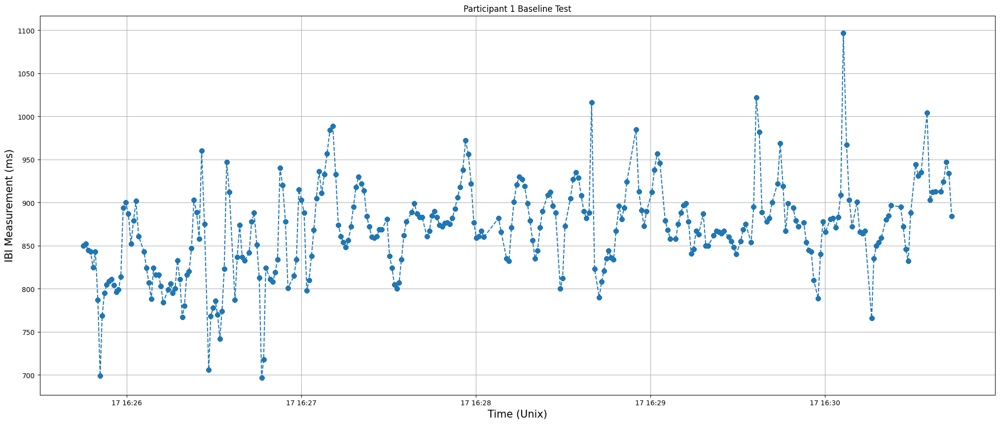

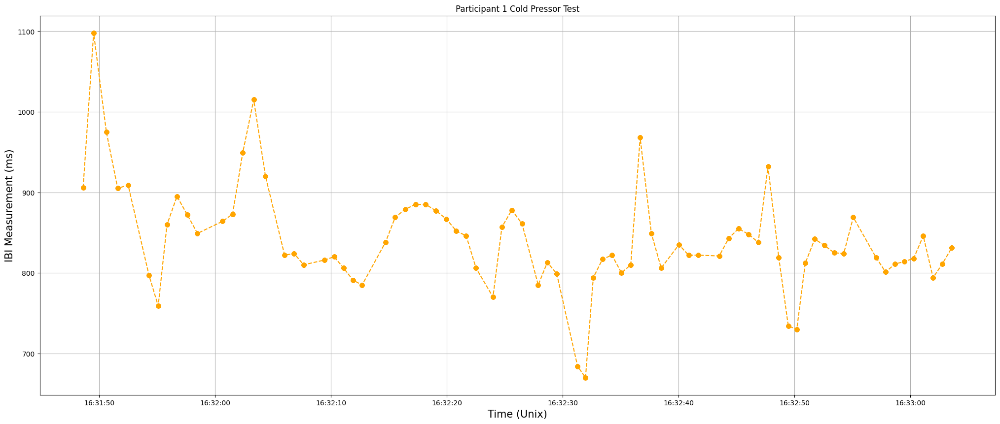

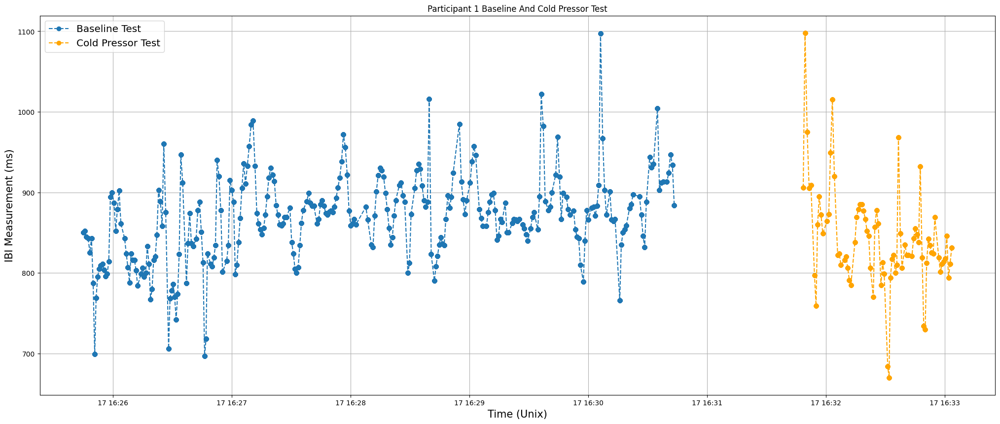

<Figure size 2500x1000 with 0 Axes>

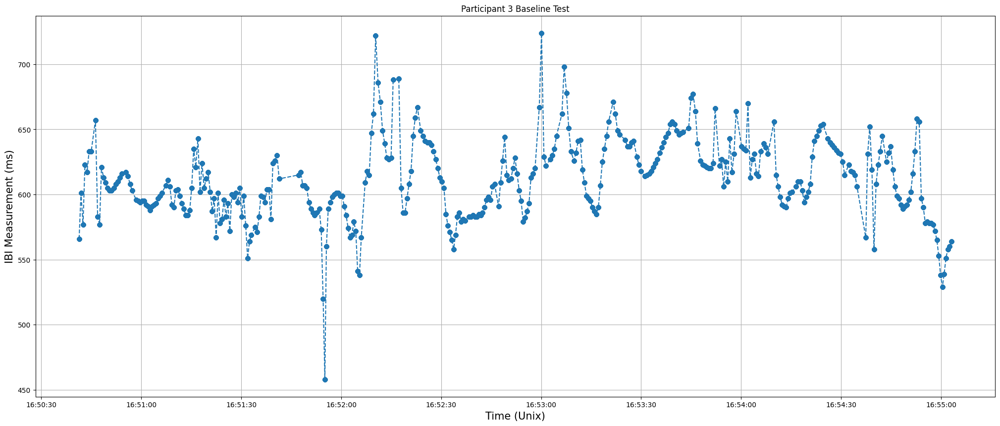

<Figure size 2500x1000 with 0 Axes>

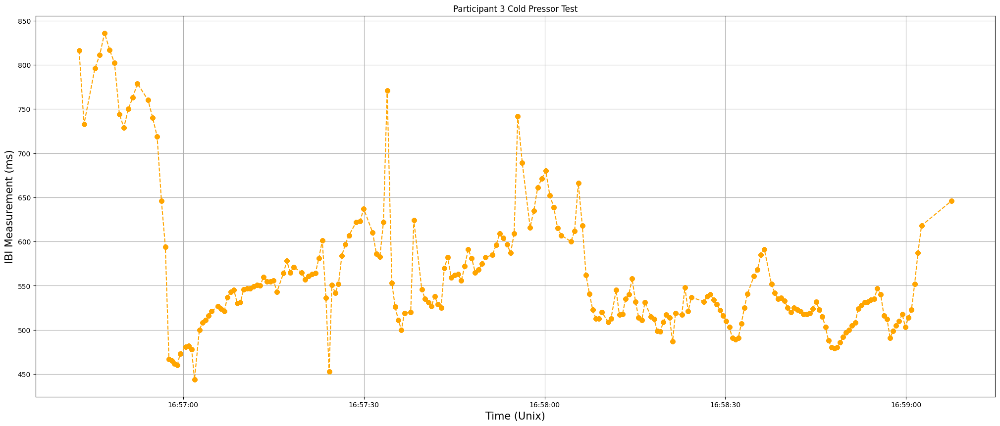

<Figure size 2500x1000 with 0 Axes>

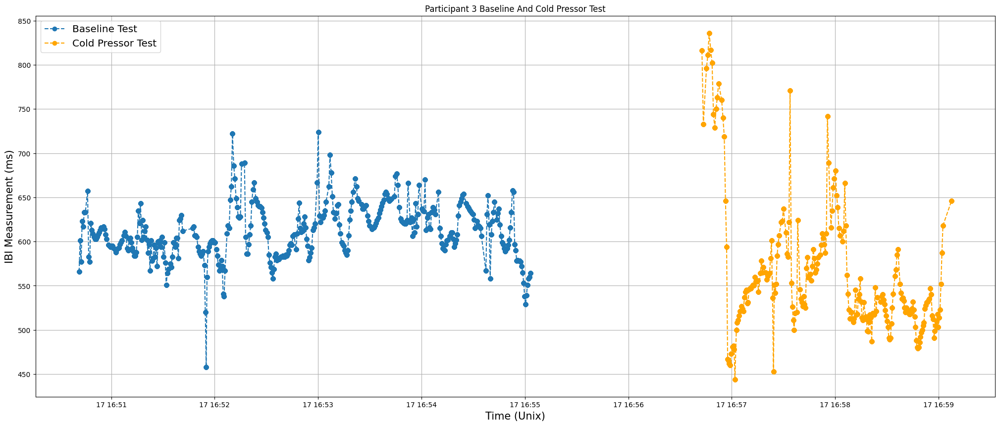

<Figure size 2500x1000 with 0 Axes>

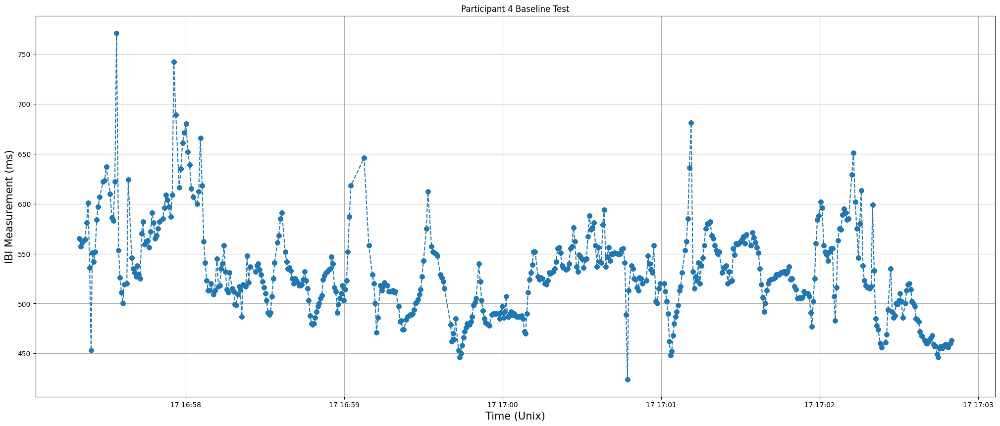

<Figure size 2500x1000 with 0 Axes>

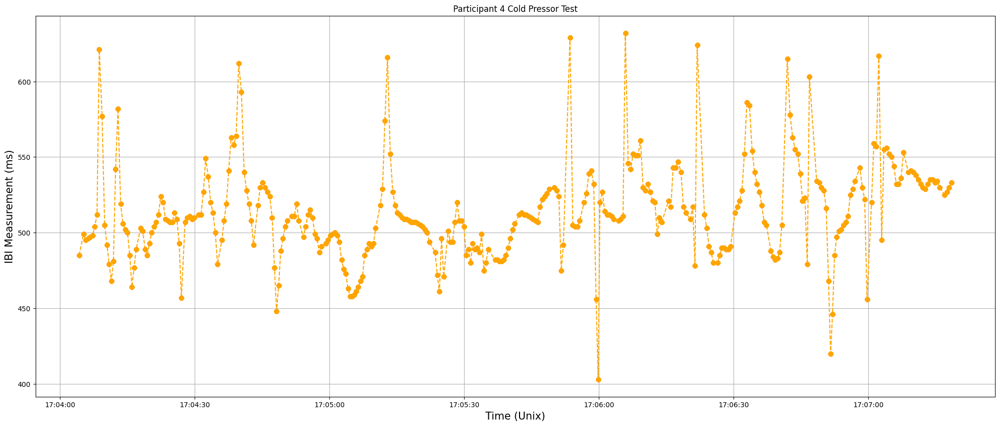

<Figure size 2500x1000 with 0 Axes>

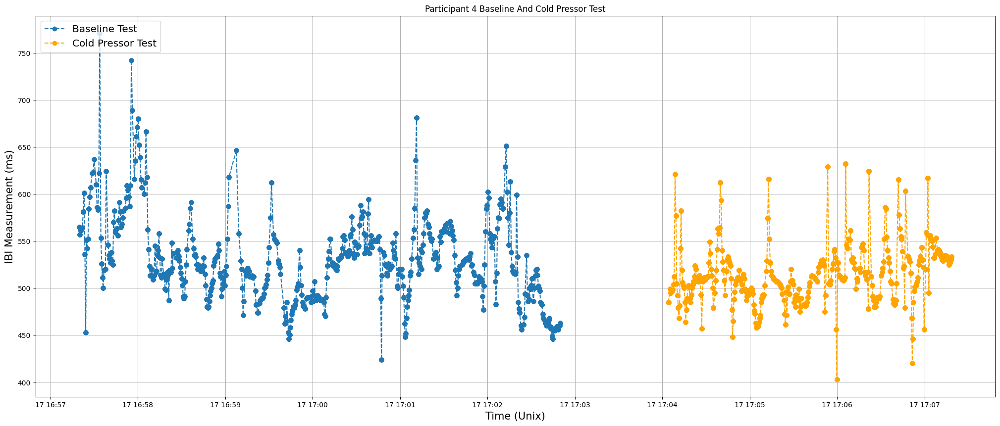

<Figure size 2500x1000 with 0 Axes>

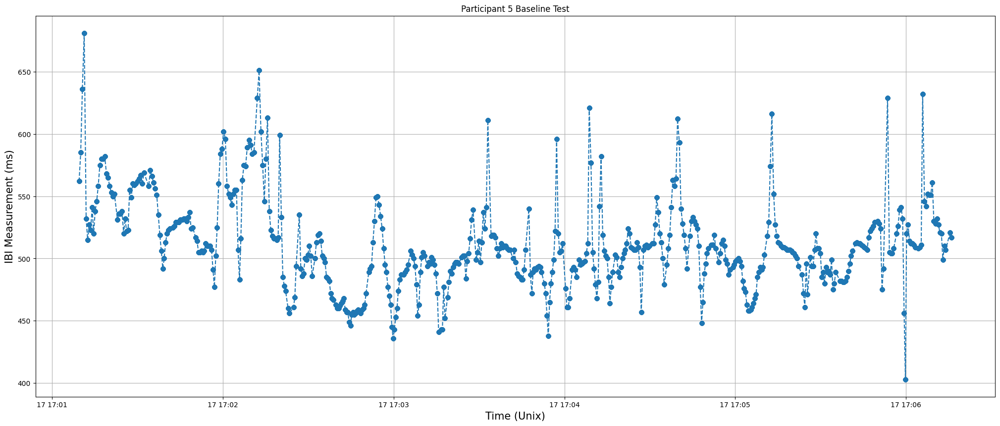

<Figure size 2500x1000 with 0 Axes>

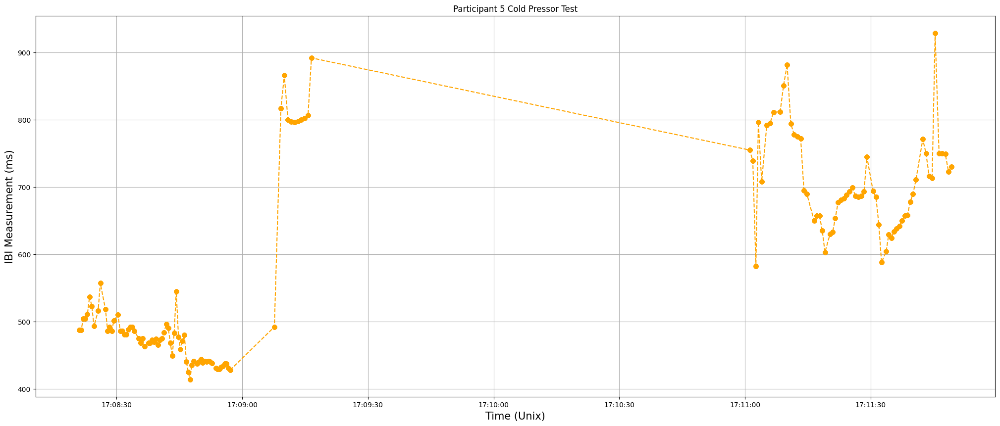

<Figure size 2500x1000 with 0 Axes>

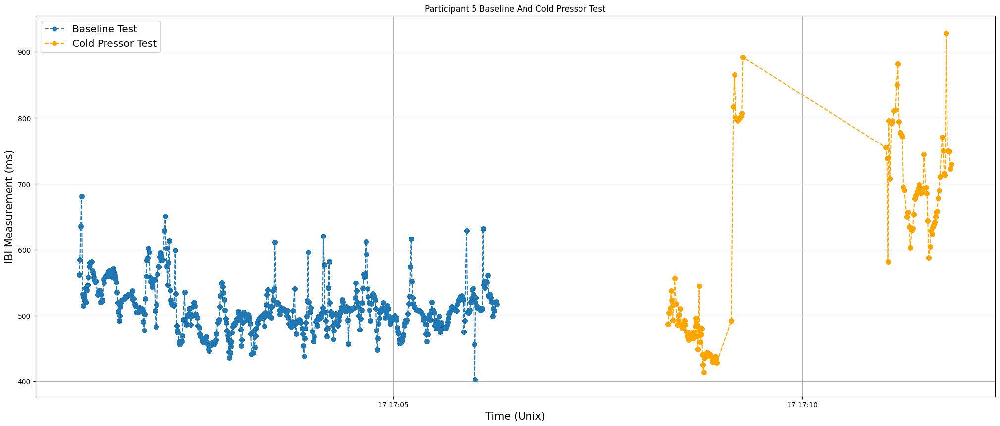

<Figure size 2500x1000 with 0 Axes>

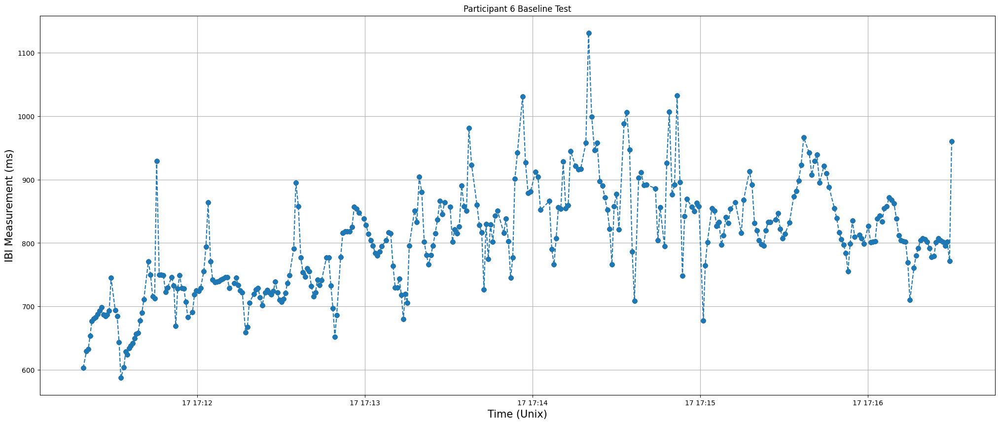

<Figure size 2500x1000 with 0 Axes>

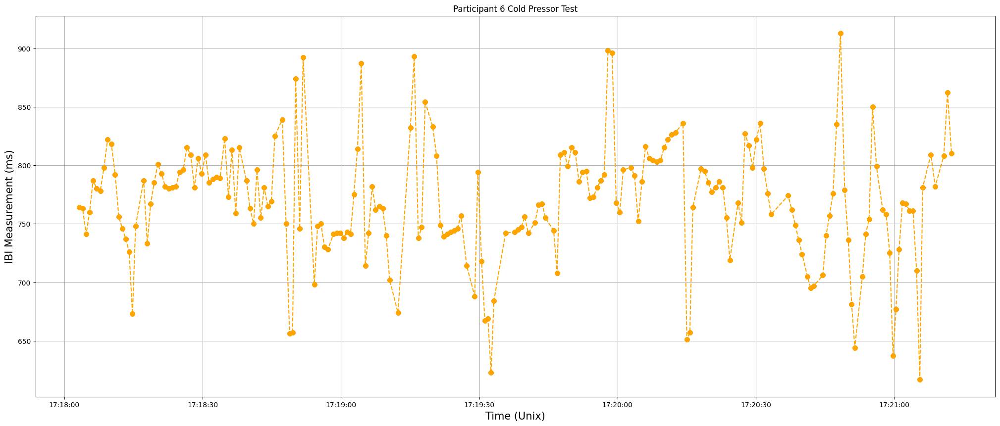

<Figure size 2500x1000 with 0 Axes>

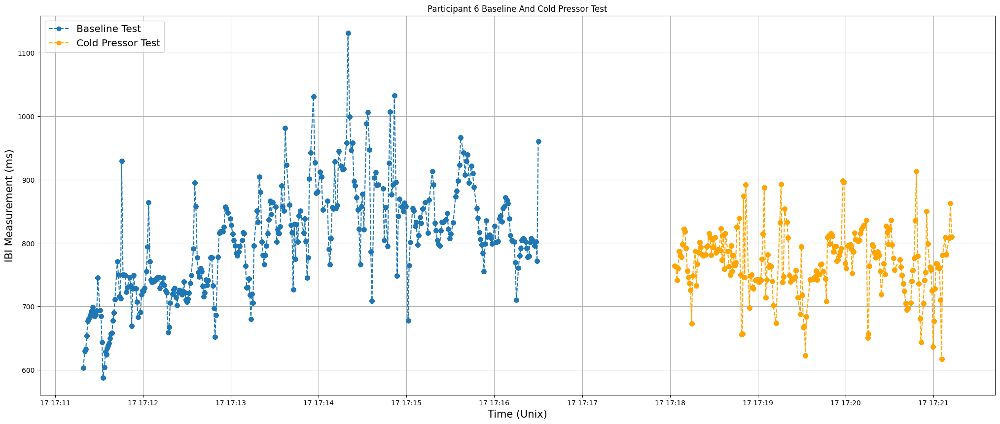

<Figure size 2500x1000 with 0 Axes>

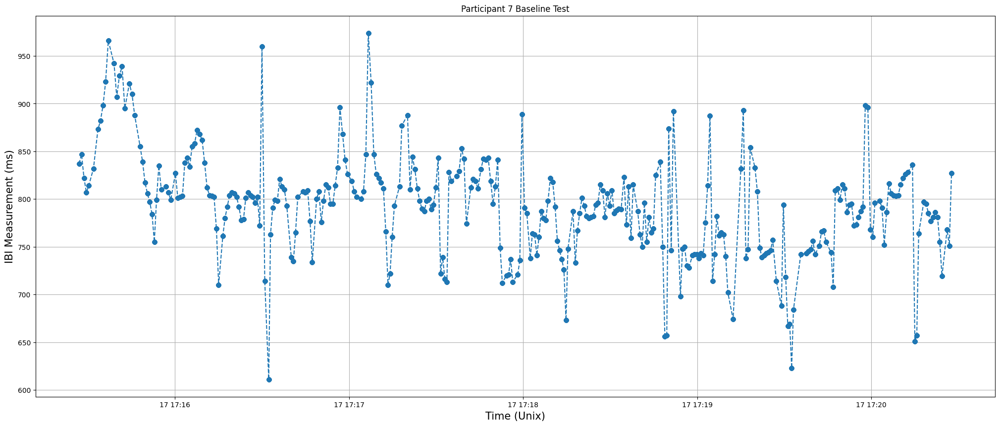

<Figure size 2500x1000 with 0 Axes>

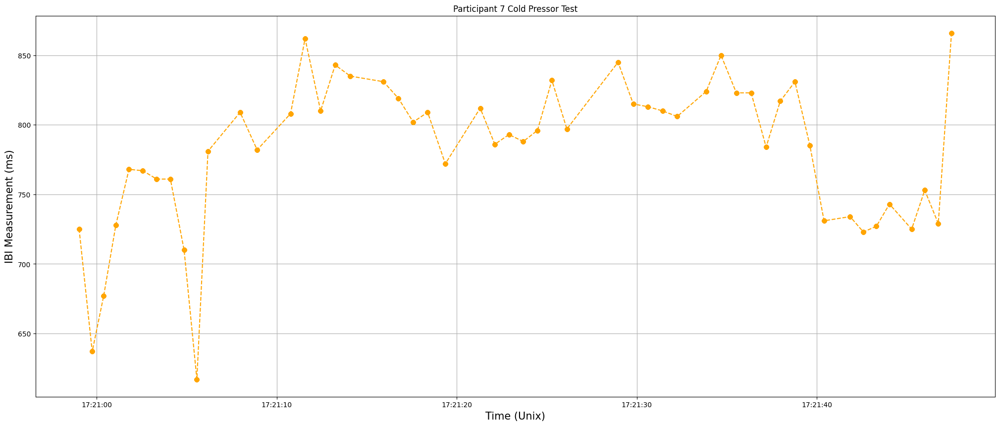

<Figure size 2500x1000 with 0 Axes>

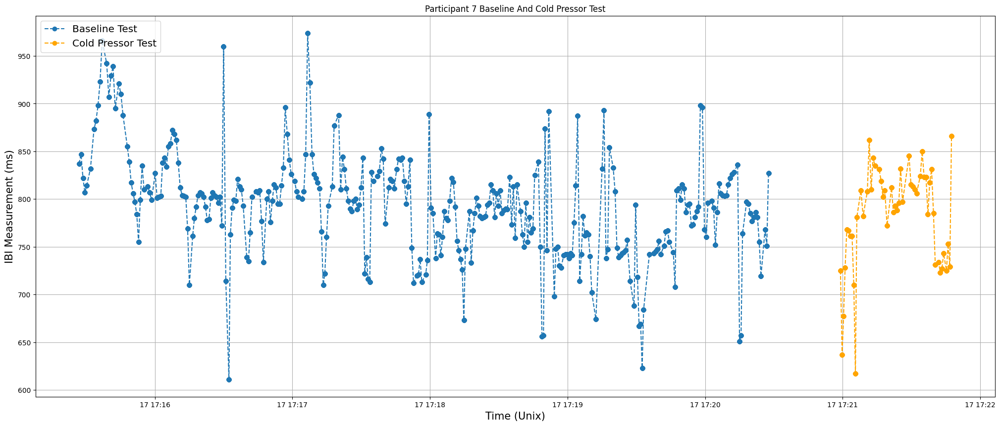

<Figure size 2500x1000 with 0 Axes>

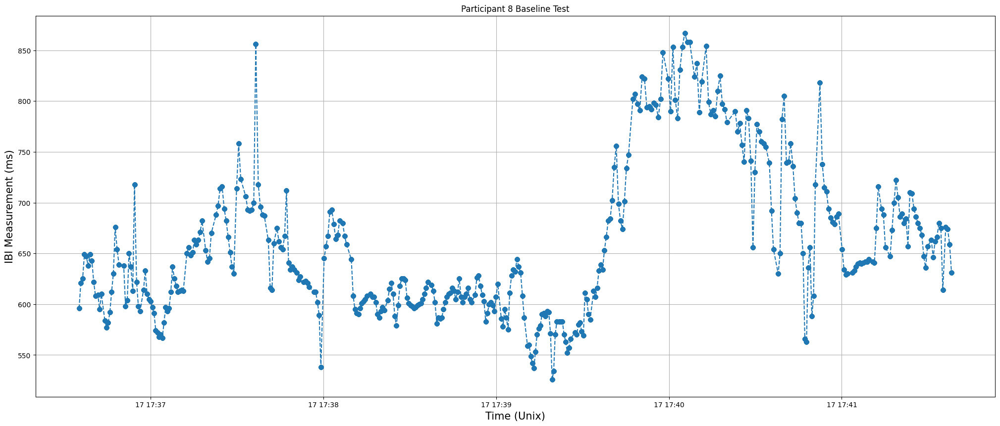

<Figure size 2500x1000 with 0 Axes>

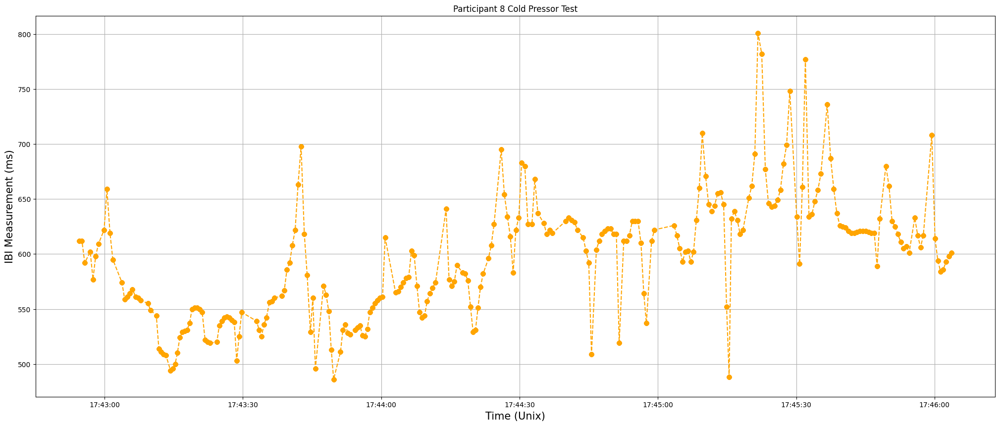

<Figure size 2500x1000 with 0 Axes>

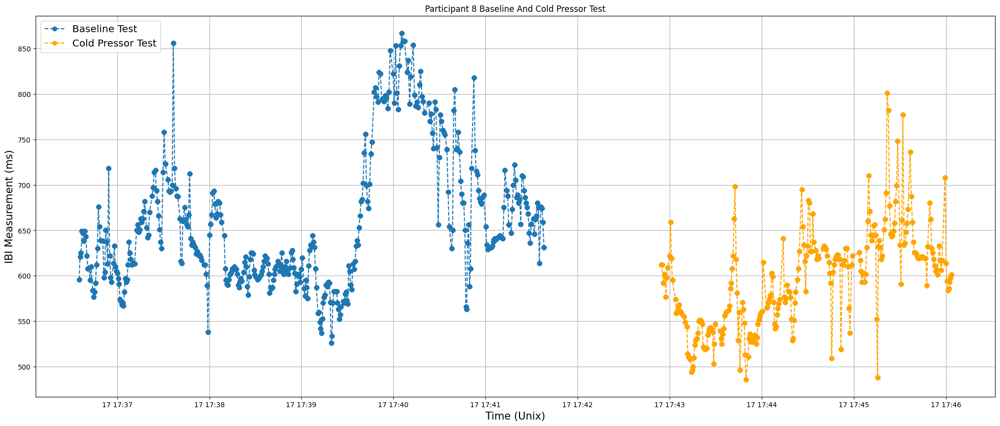

<Figure size 2500x1000 with 0 Axes>

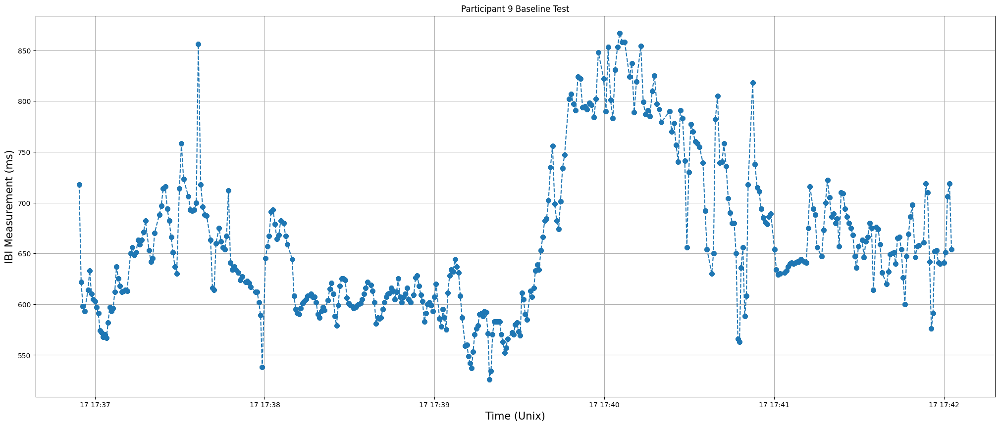

<Figure size 2500x1000 with 0 Axes>

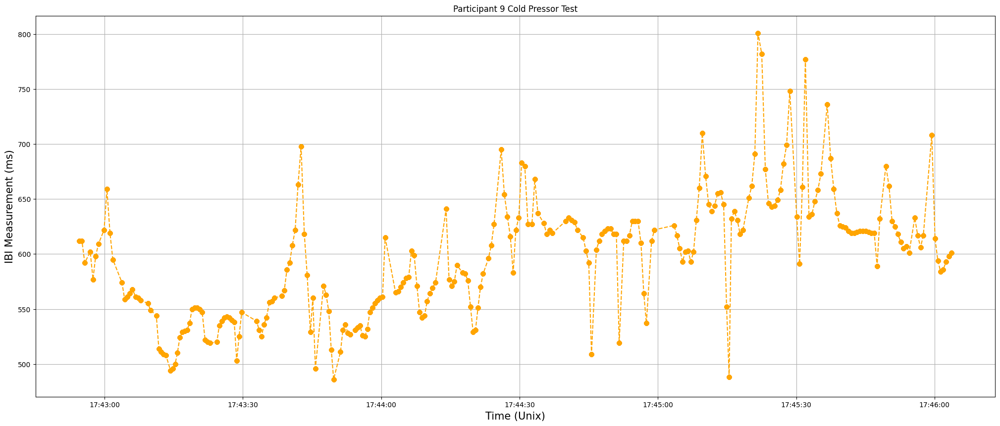

<Figure size 2500x1000 with 0 Axes>

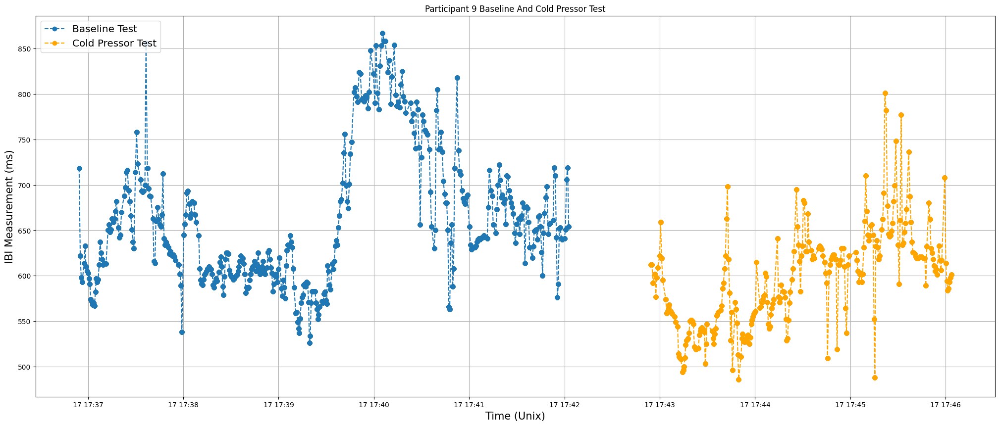

<Figure size 2500x1000 with 0 Axes>

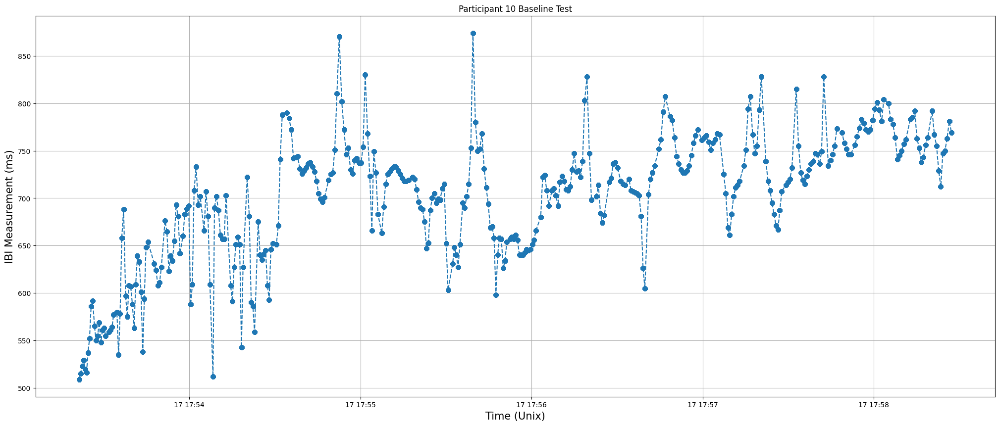

<Figure size 2500x1000 with 0 Axes>

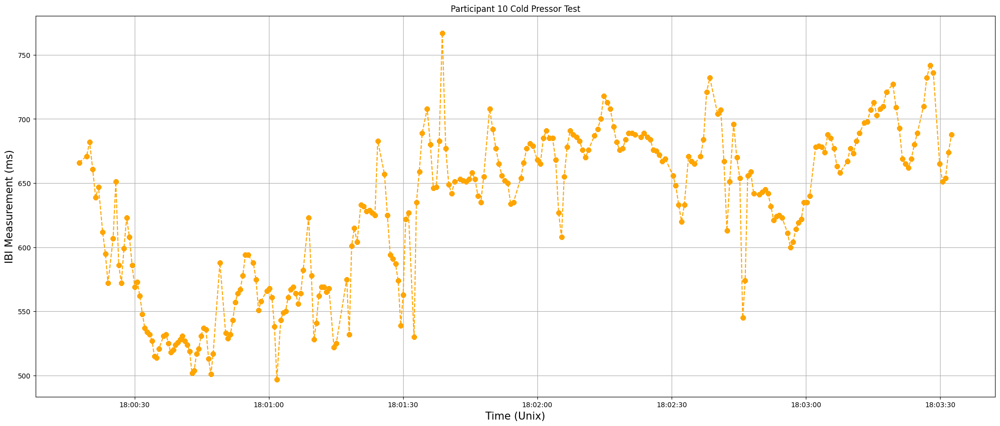

<Figure size 2500x1000 with 0 Axes>

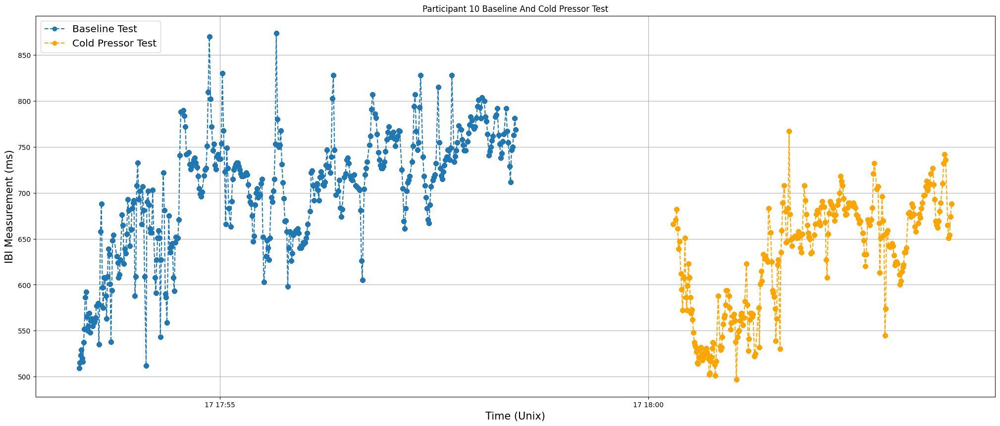

<Figure size 2500x1000 with 0 Axes>

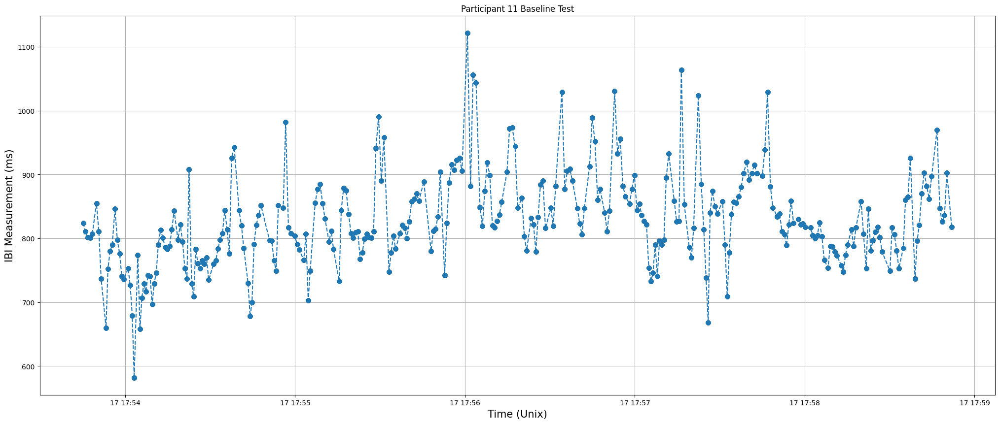

<Figure size 2500x1000 with 0 Axes>

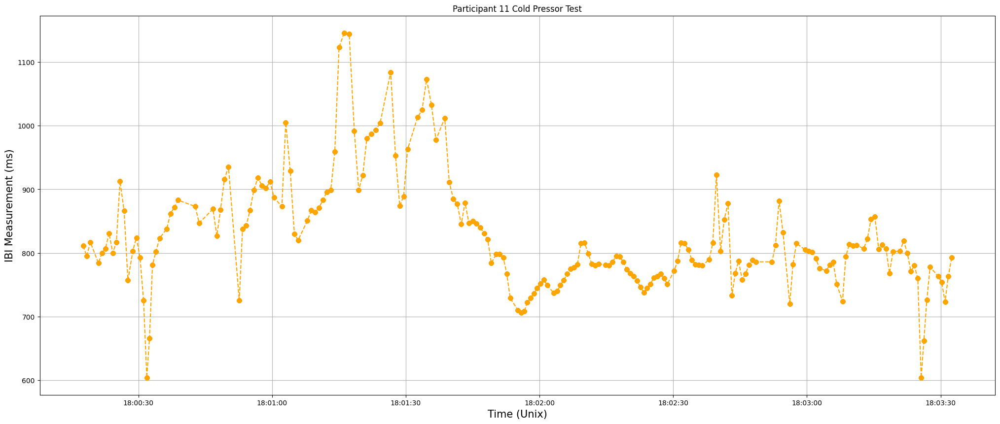

<Figure size 2500x1000 with 0 Axes>

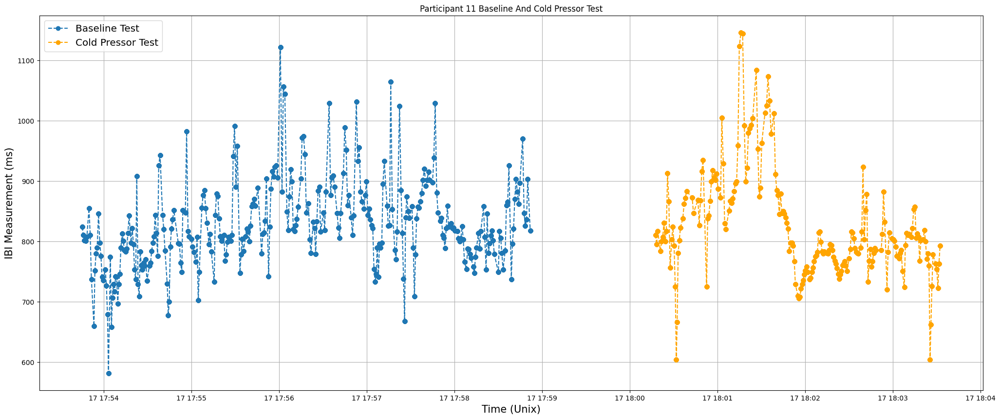

<Figure size 2500x1000 with 0 Axes>

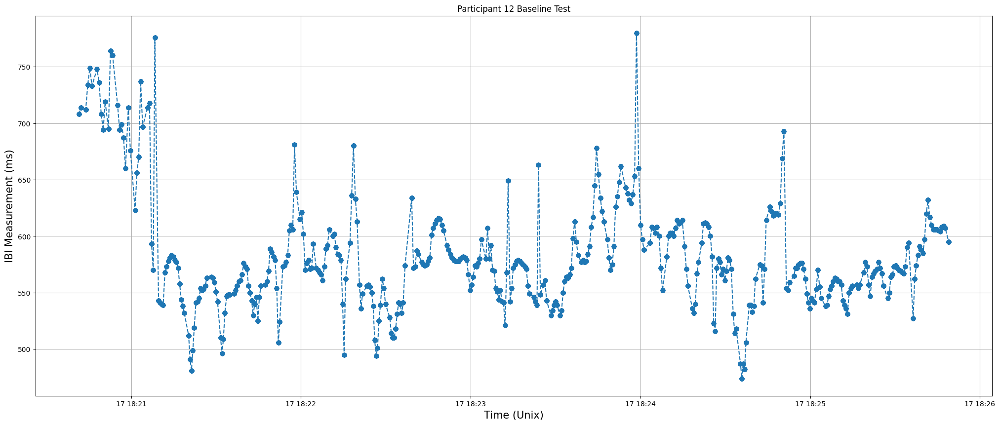

<Figure size 2500x1000 with 0 Axes>

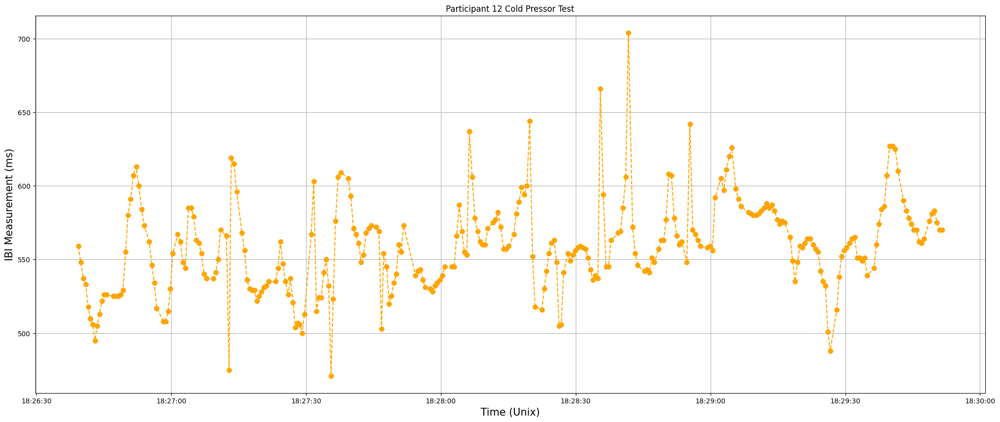

<Figure size 2500x1000 with 0 Axes>

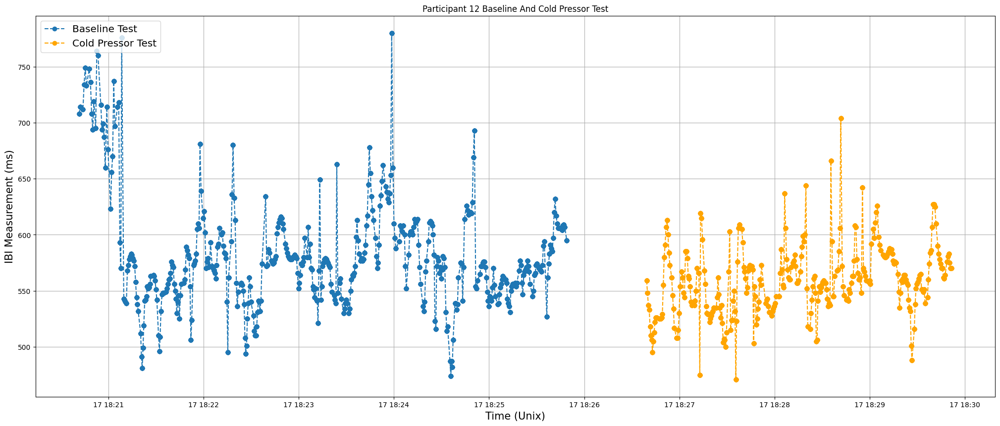

<Figure size 2500x1000 with 0 Axes>

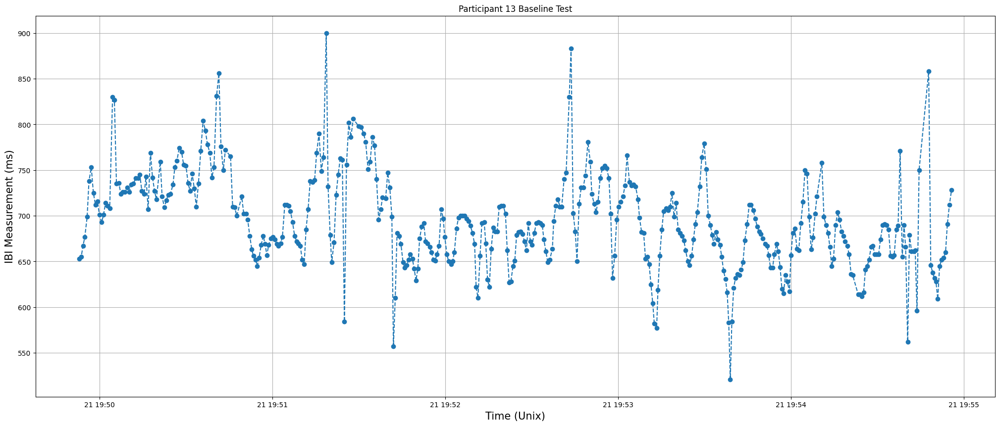

<Figure size 2500x1000 with 0 Axes>

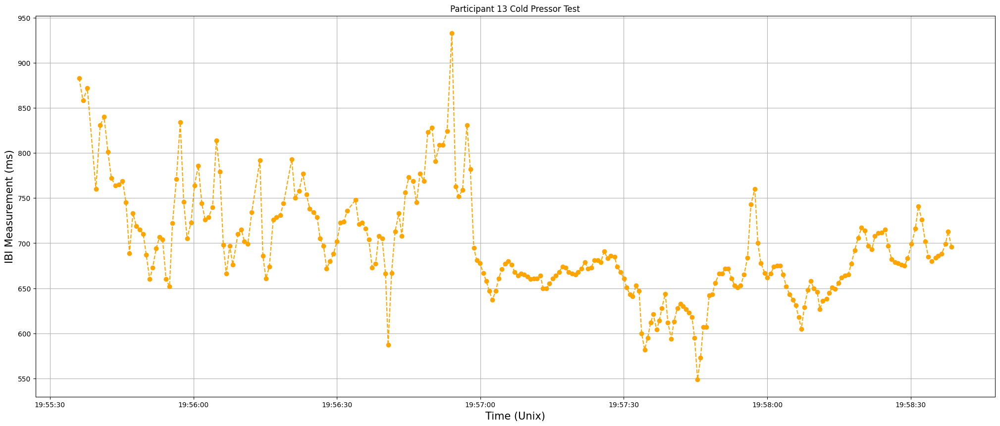

<Figure size 2500x1000 with 0 Axes>

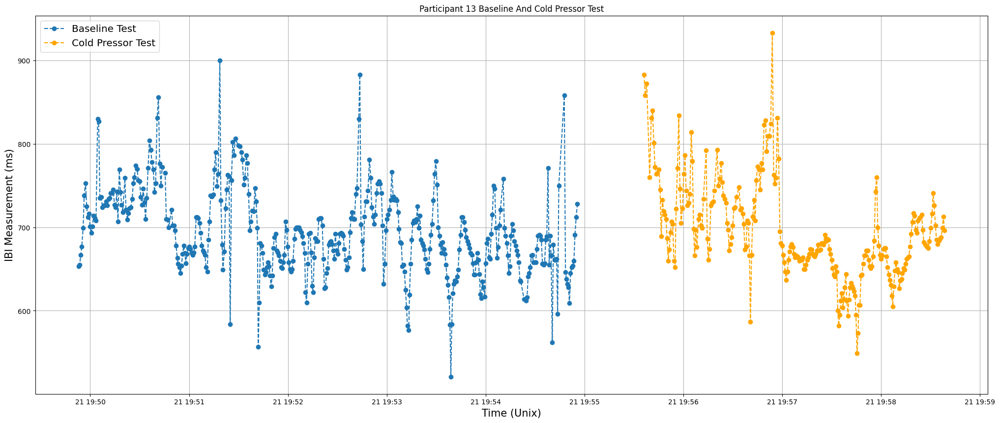

<Figure size 2500x1000 with 0 Axes>

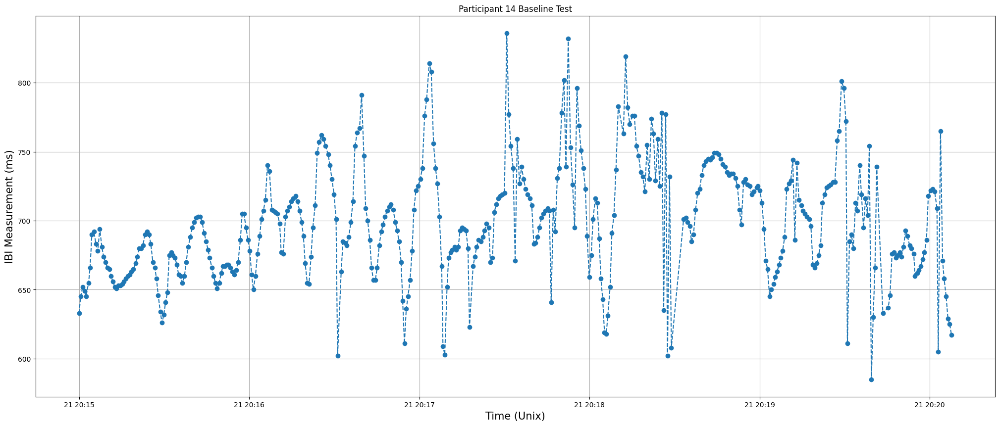

<Figure size 2500x1000 with 0 Axes>

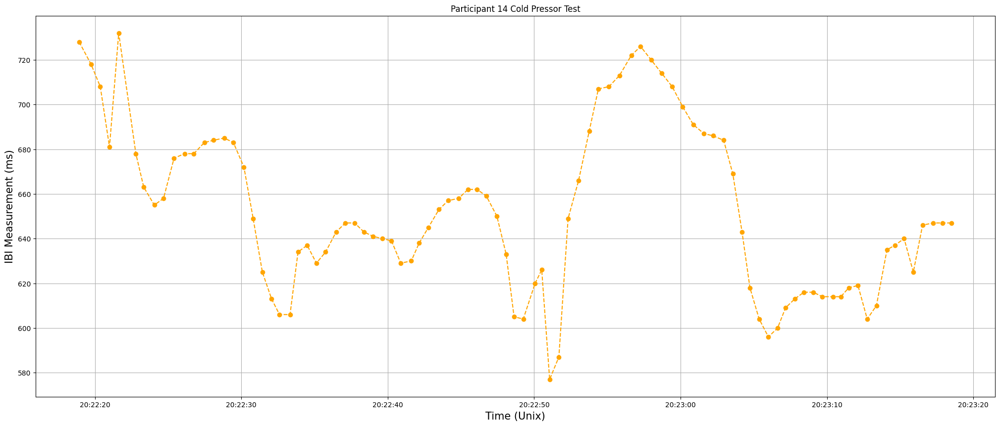

<Figure size 2500x1000 with 0 Axes>

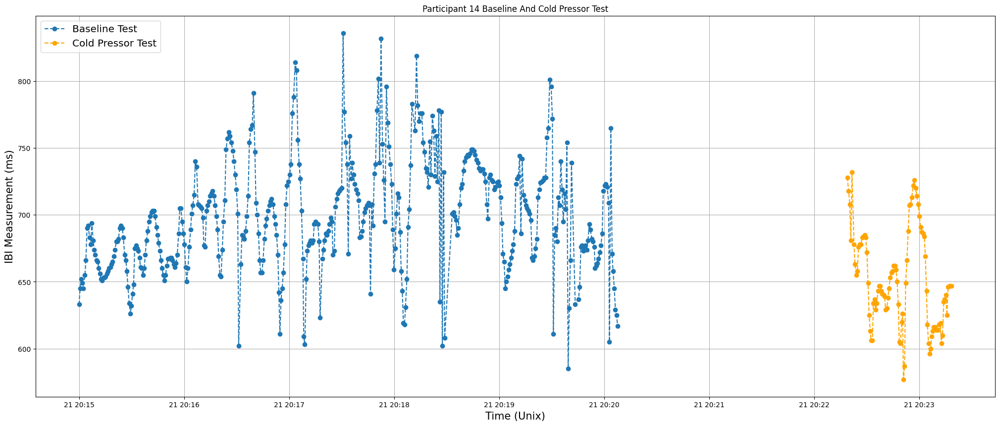

<Figure size 2500x1000 with 0 Axes>

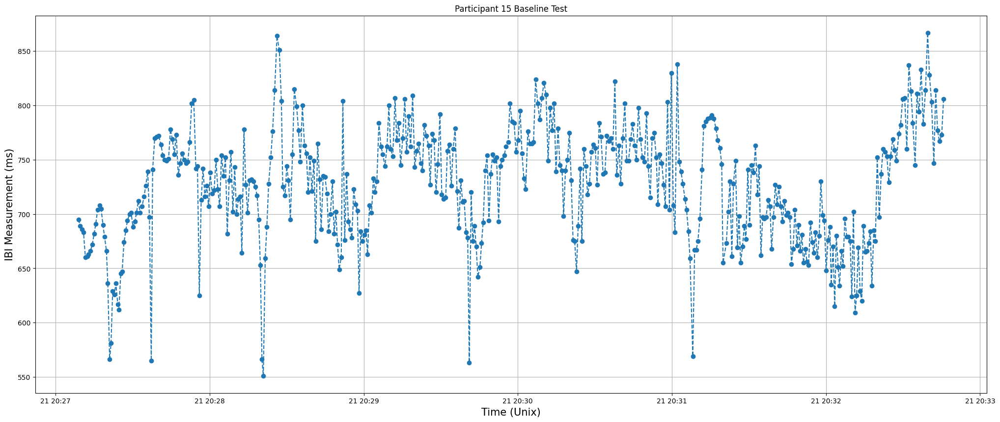

<Figure size 2500x1000 with 0 Axes>

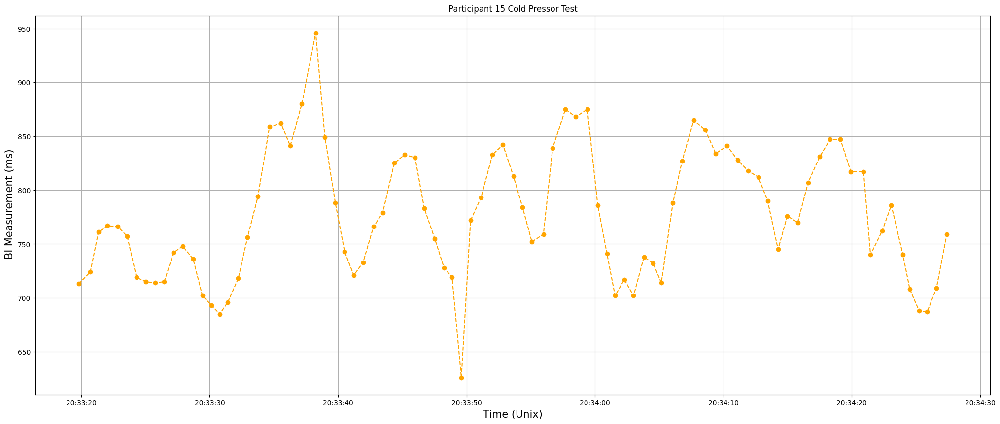

<Figure size 2500x1000 with 0 Axes>

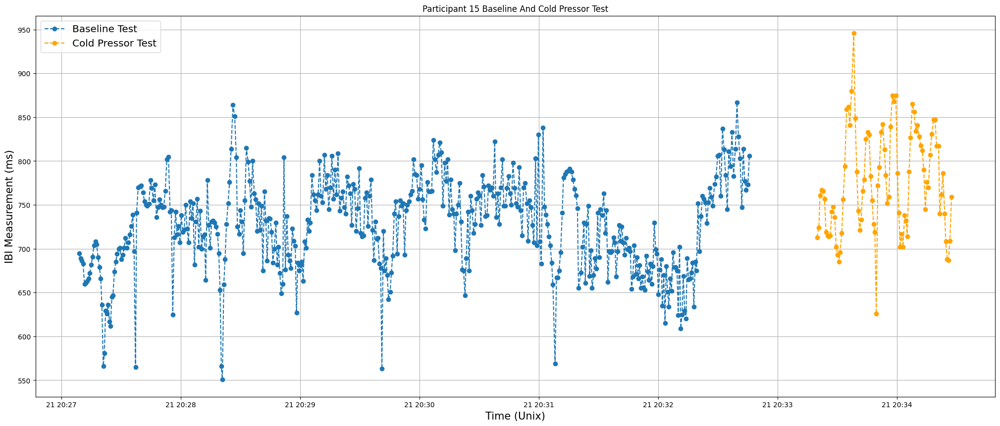

<Figure size 2500x1000 with 0 Axes>

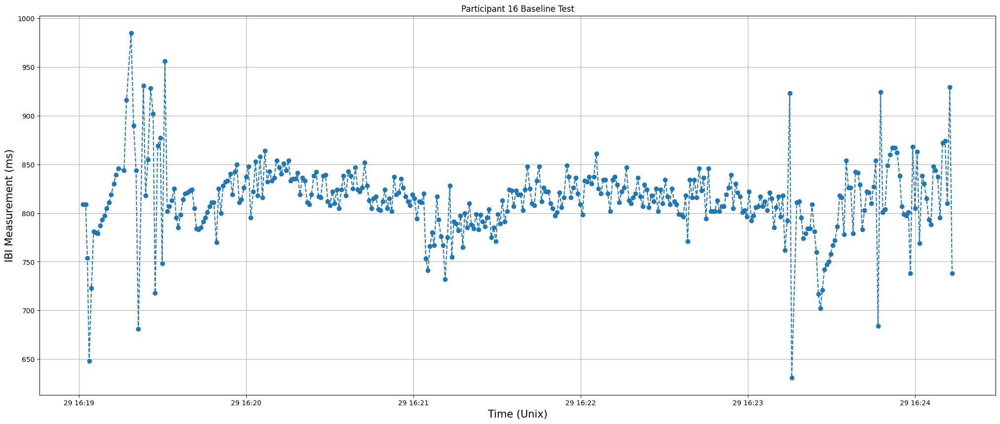

<Figure size 2500x1000 with 0 Axes>

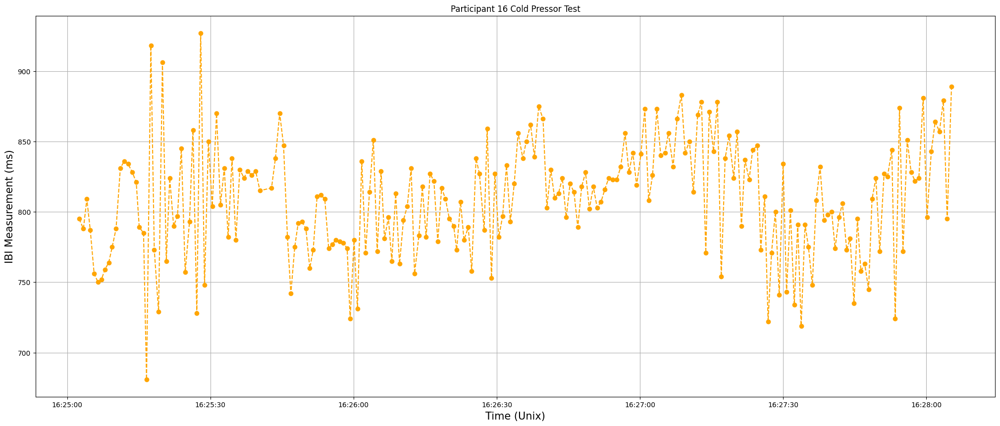

<Figure size 2500x1000 with 0 Axes>

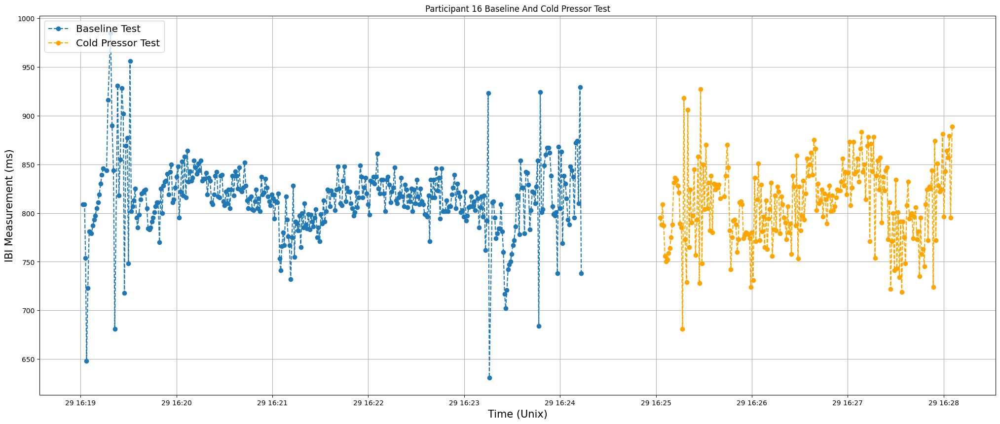

<Figure size 2500x1000 with 0 Axes>

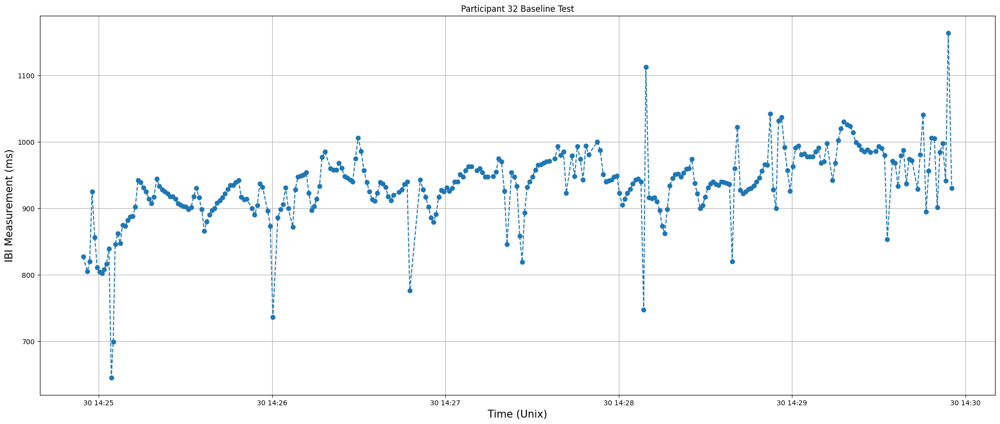

<Figure size 2500x1000 with 0 Axes>

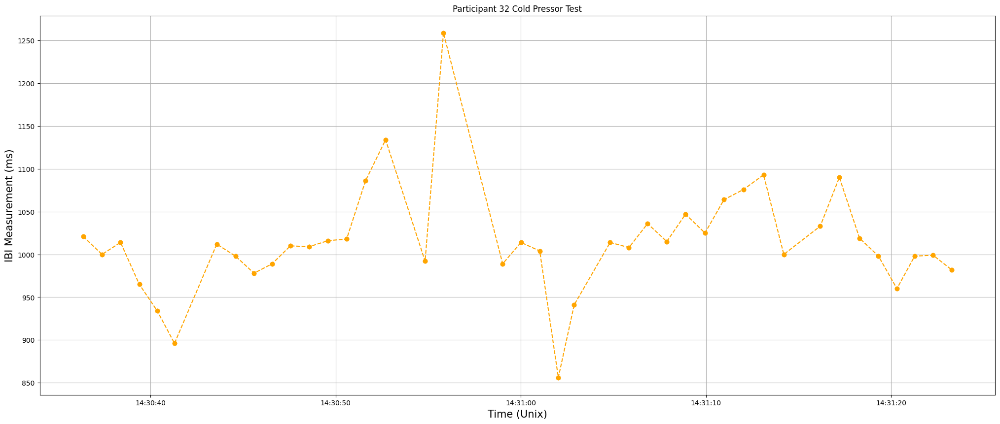

<Figure size 2500x1000 with 0 Axes>

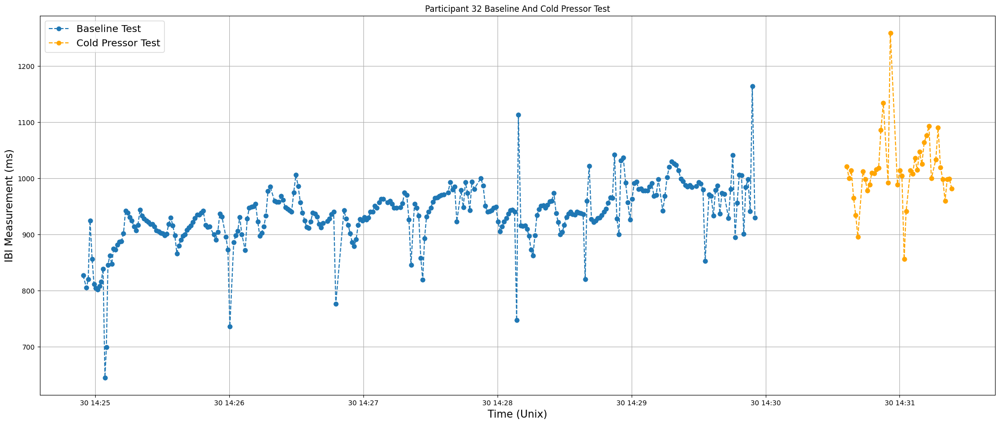

<Figure size 2500x1000 with 0 Axes>

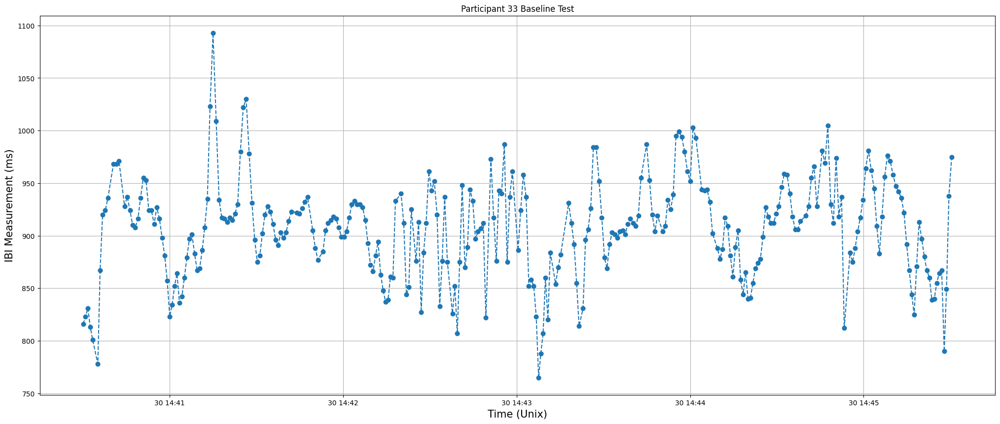

<Figure size 2500x1000 with 0 Axes>

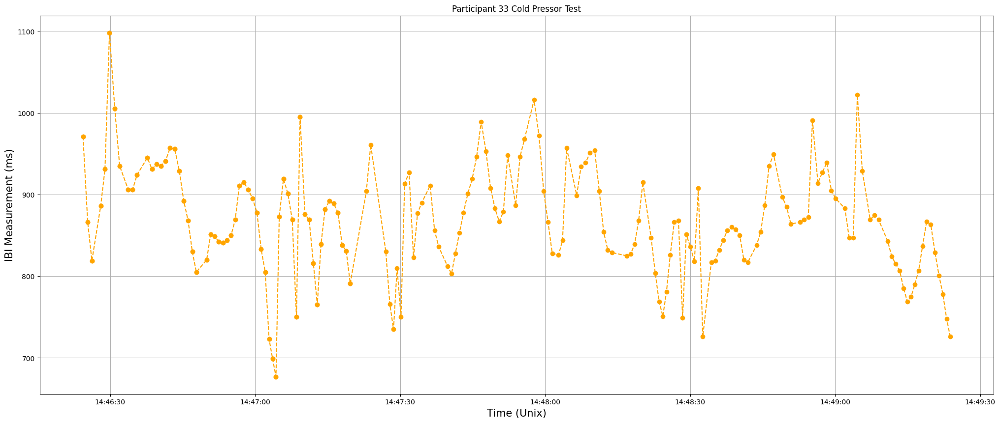

<Figure size 2500x1000 with 0 Axes>

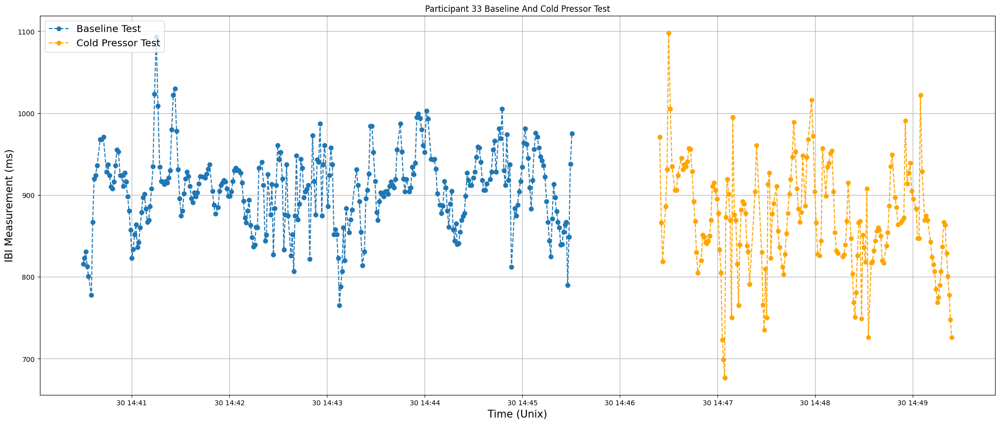

<Figure size 2500x1000 with 0 Axes>

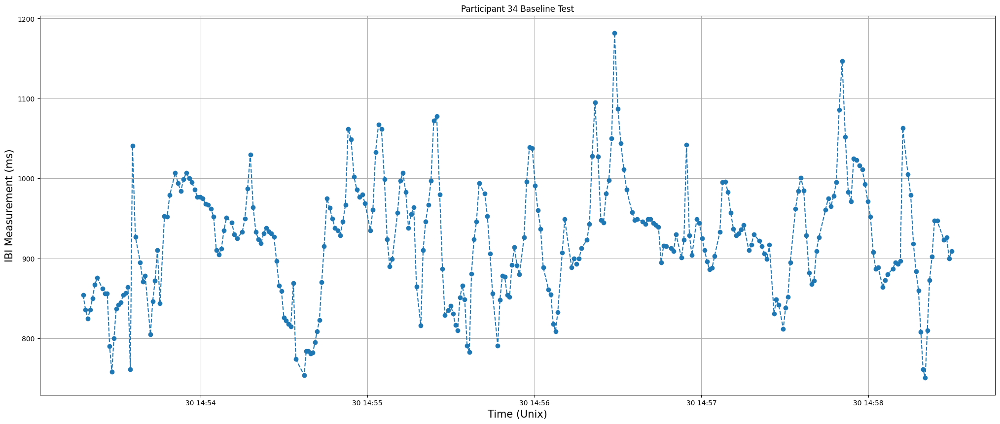

<Figure size 2500x1000 with 0 Axes>

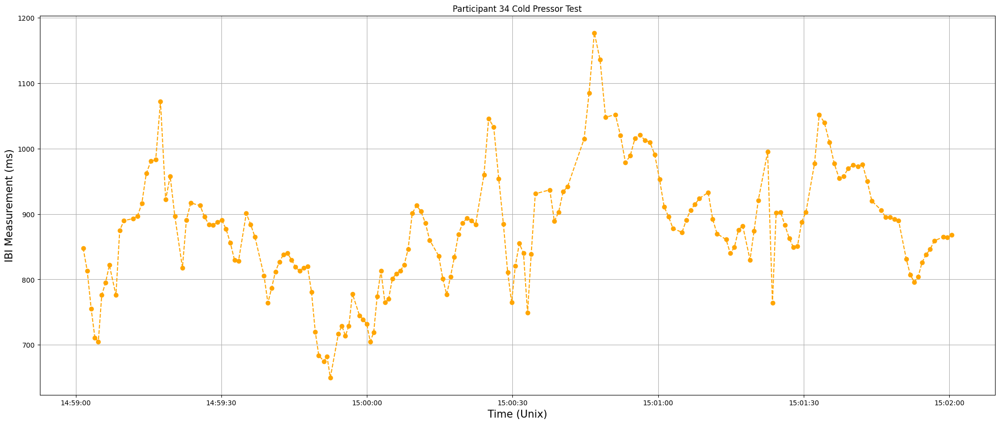

<Figure size 2500x1000 with 0 Axes>

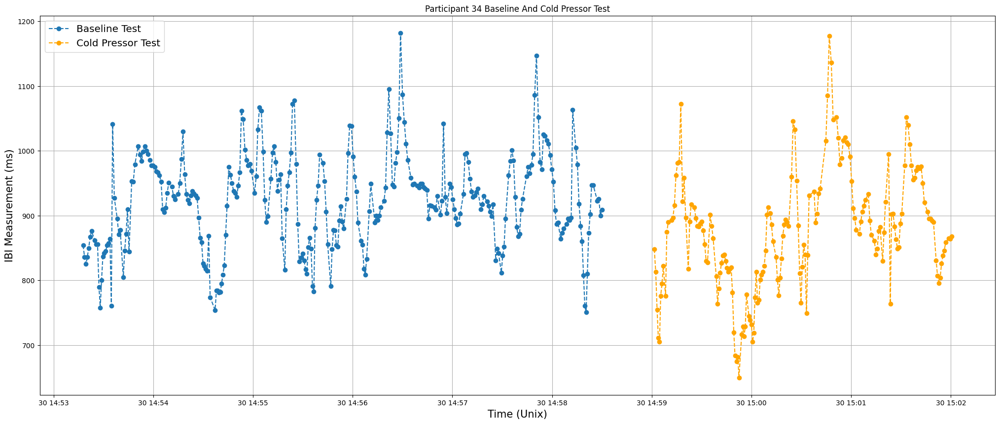

<Figure size 2500x1000 with 0 Axes>

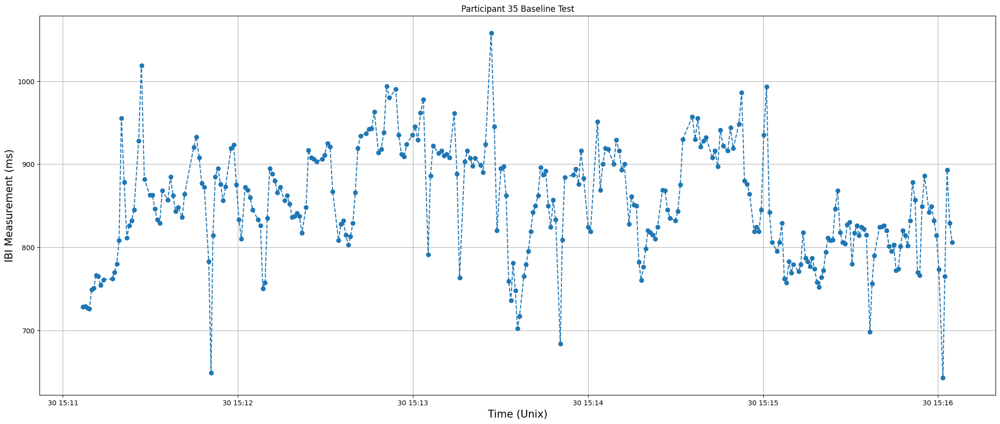

<Figure size 2500x1000 with 0 Axes>

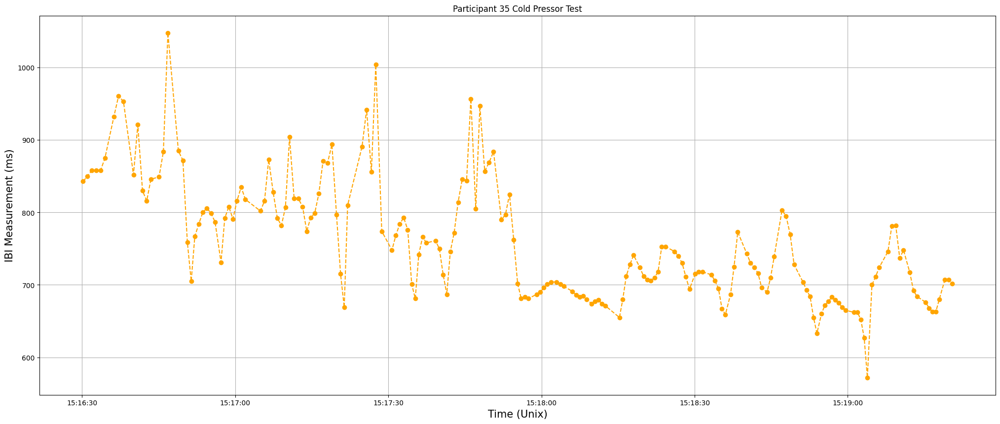

<Figure size 2500x1000 with 0 Axes>

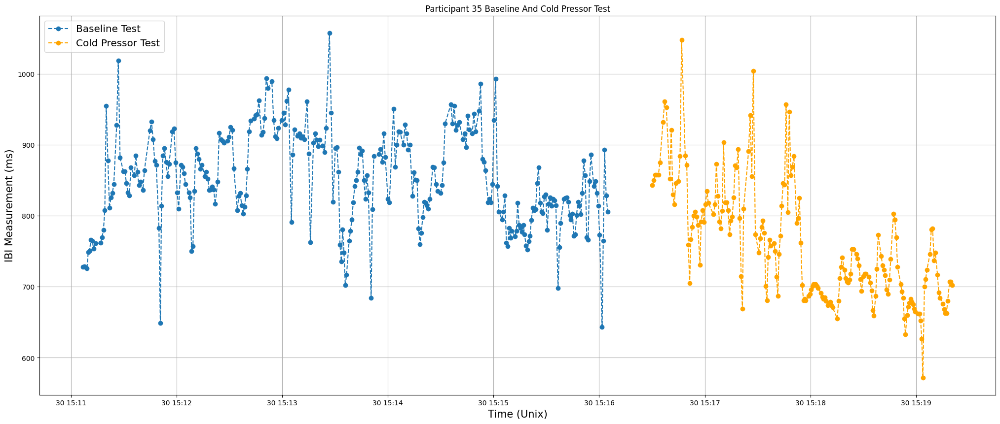

<Figure size 2500x1000 with 0 Axes>

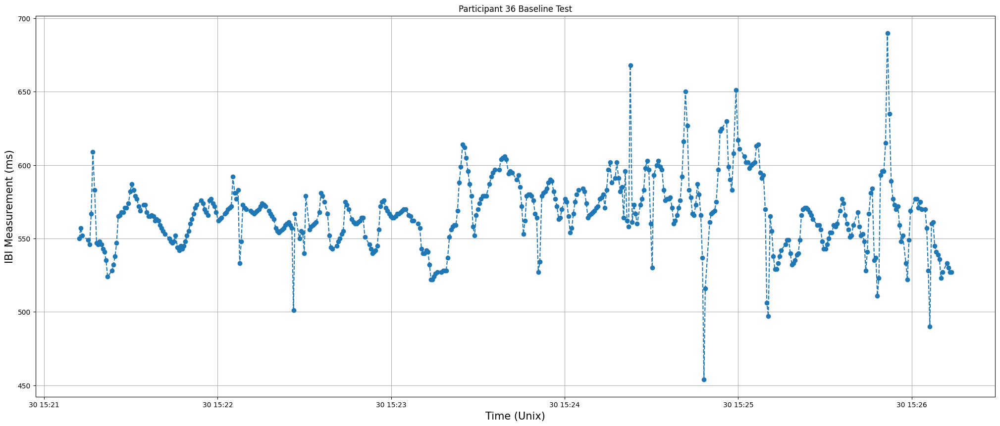

<Figure size 2500x1000 with 0 Axes>

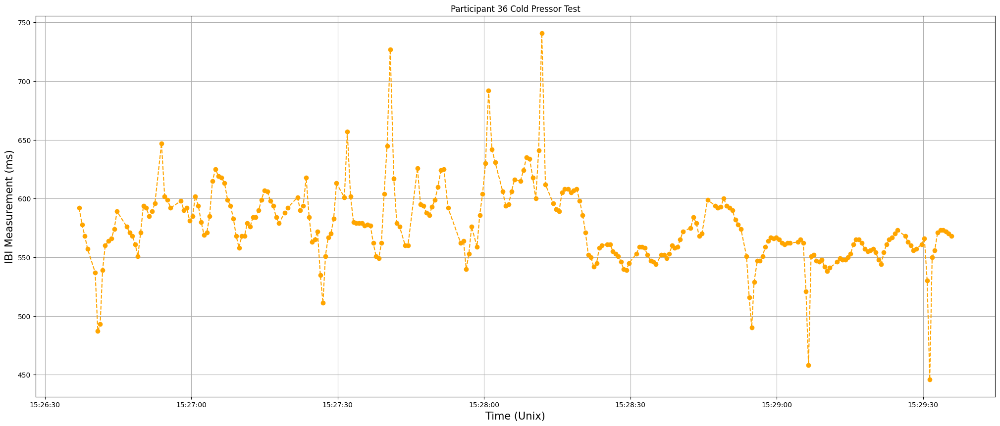

<Figure size 2500x1000 with 0 Axes>

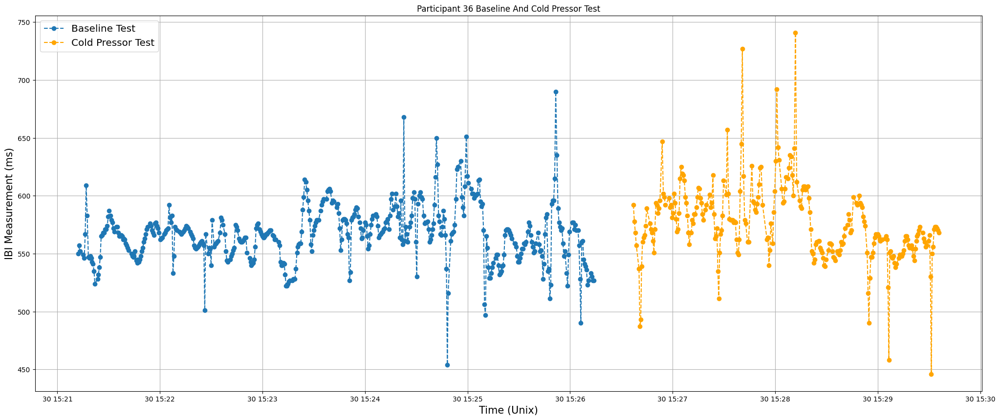

<Figure size 2500x1000 with 0 Axes>

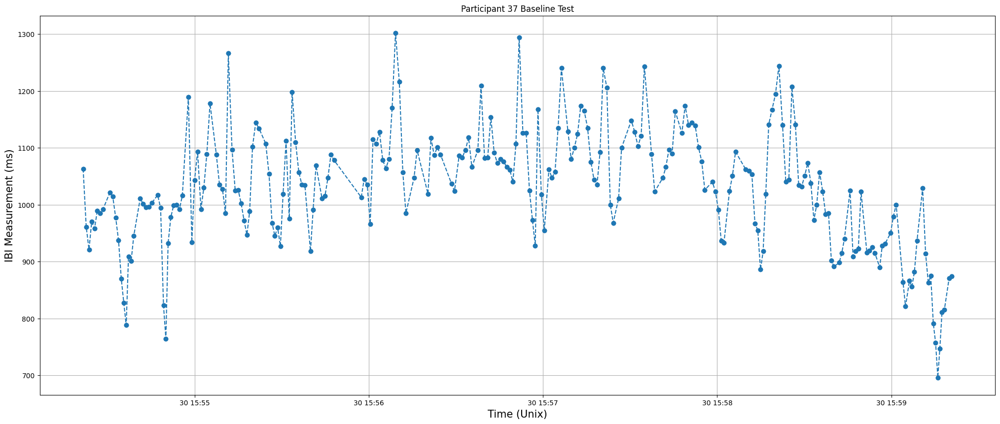

<Figure size 2500x1000 with 0 Axes>

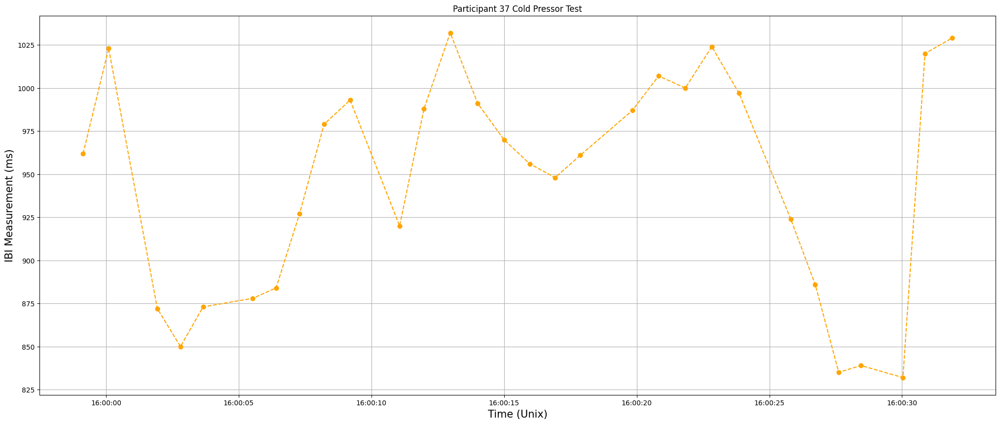

<Figure size 2500x1000 with 0 Axes>

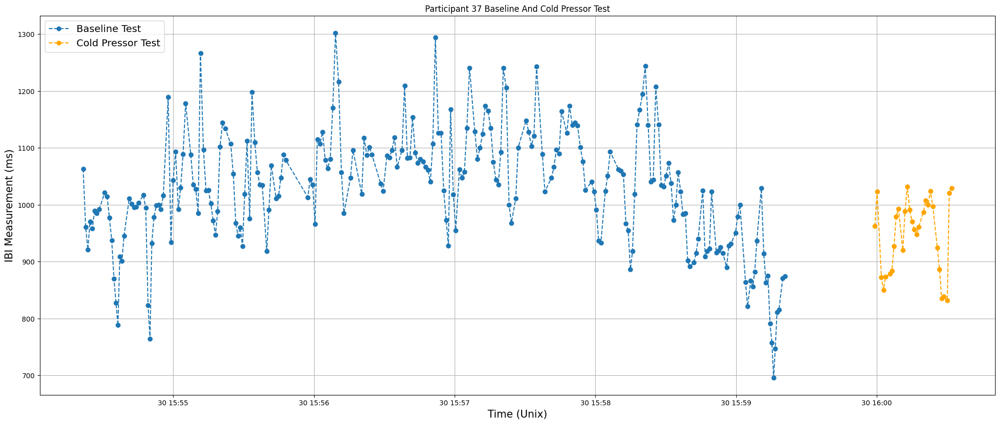

<Figure size 2500x1000 with 0 Axes>

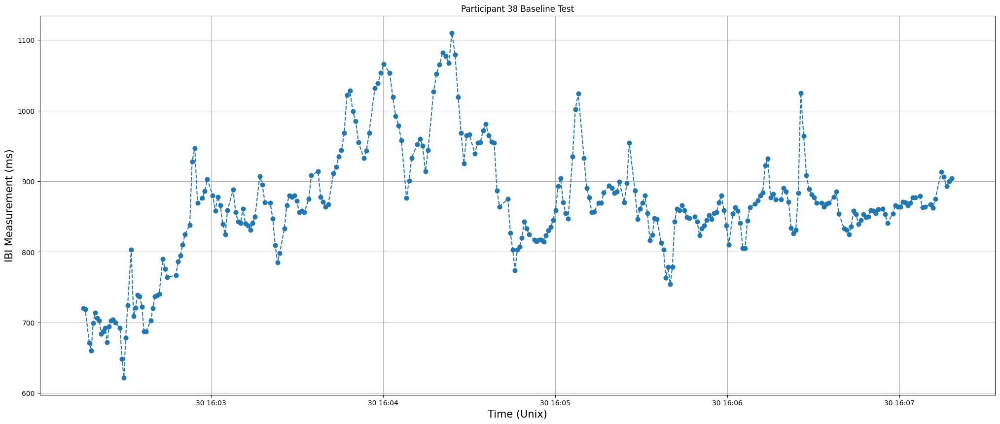

<Figure size 2500x1000 with 0 Axes>

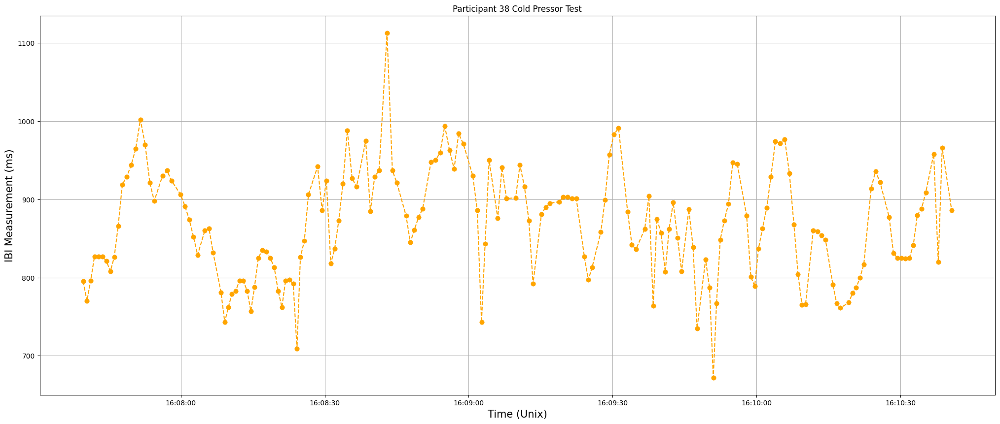

<Figure size 2500x1000 with 0 Axes>

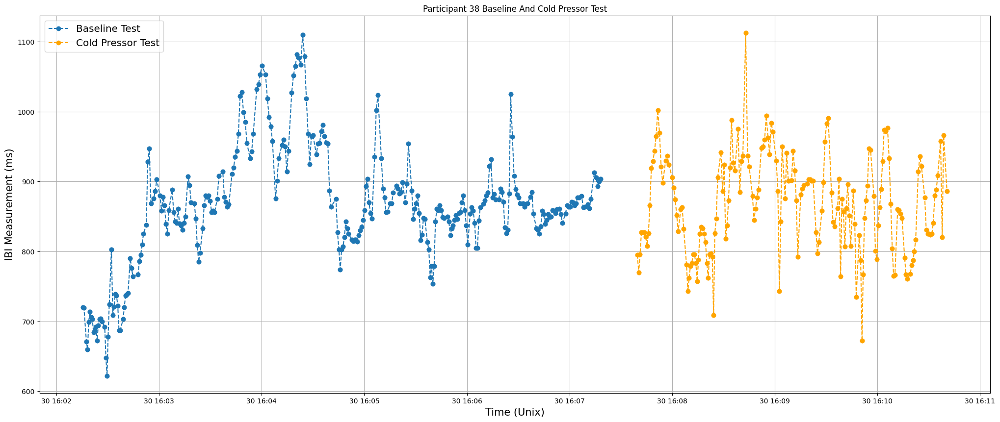

<Figure size 2500x1000 with 0 Axes>

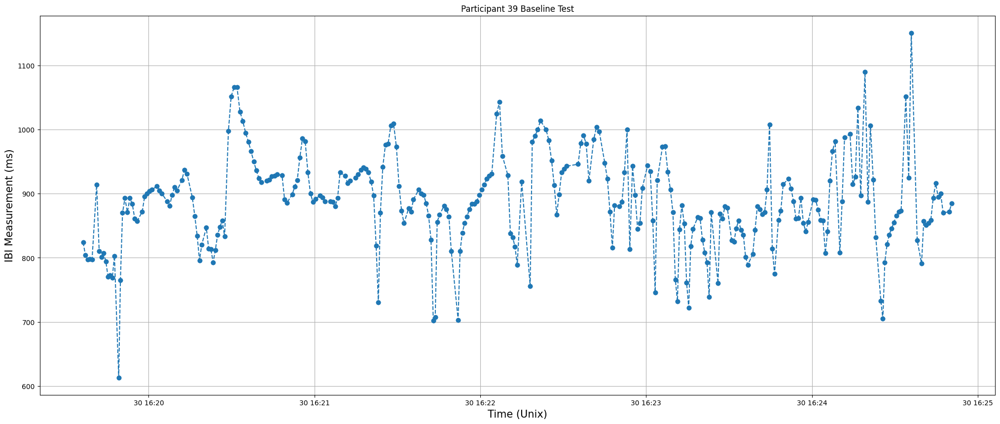

<Figure size 2500x1000 with 0 Axes>

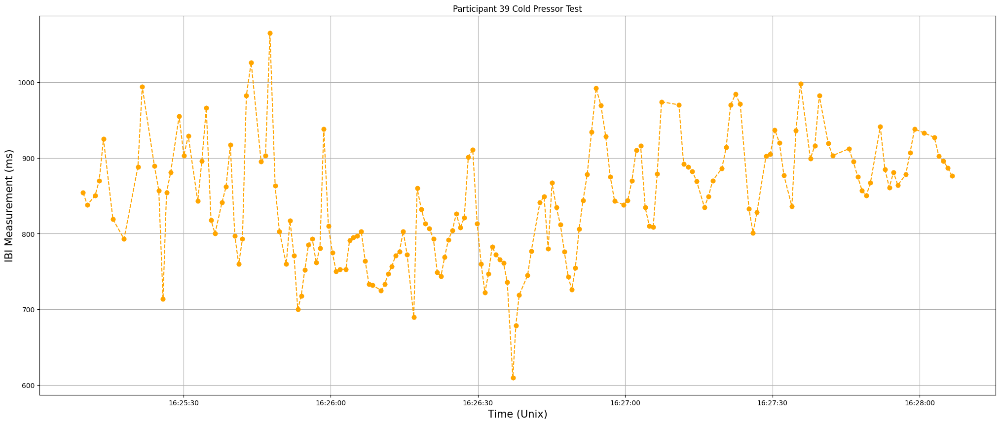

<Figure size 2500x1000 with 0 Axes>

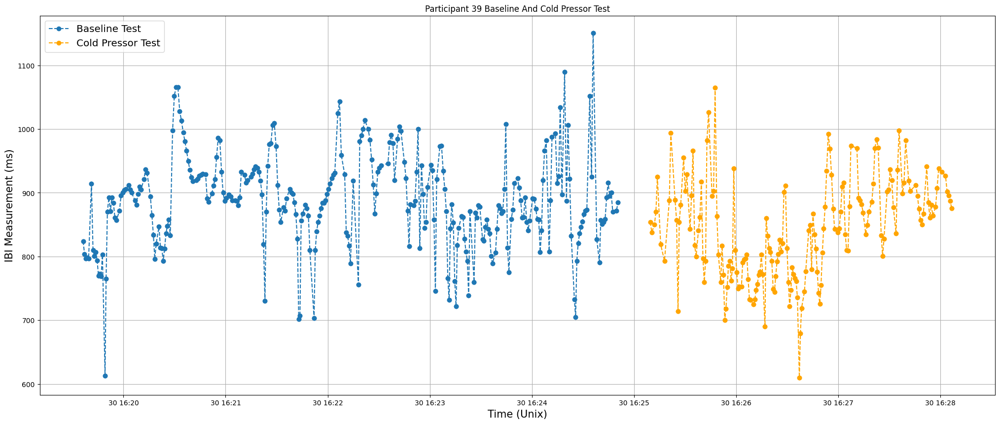

<Figure size 2500x1000 with 0 Axes>

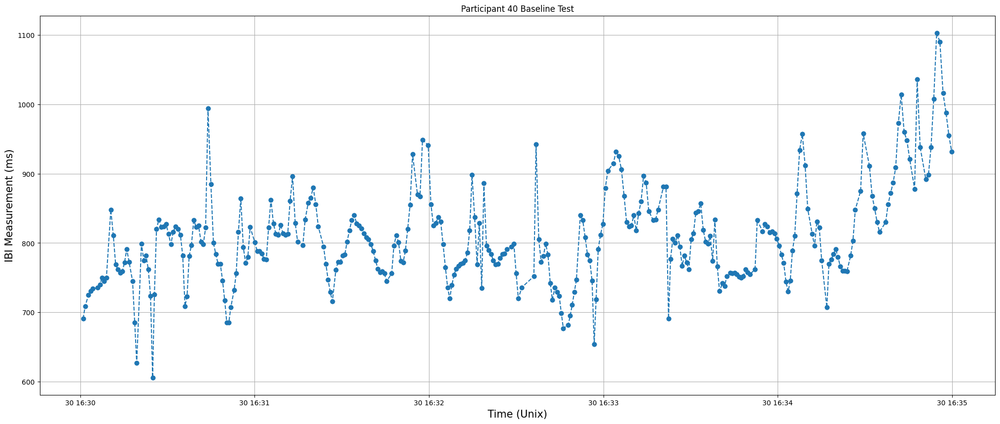

<Figure size 2500x1000 with 0 Axes>

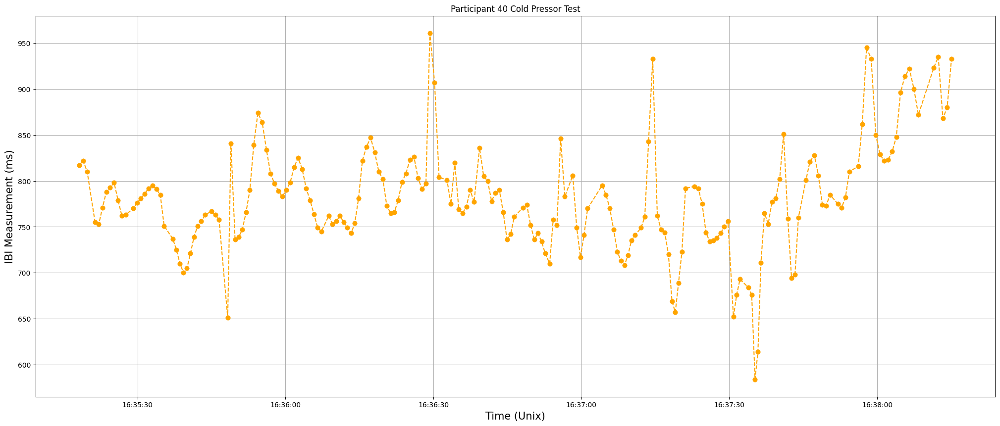

<Figure size 2500x1000 with 0 Axes>

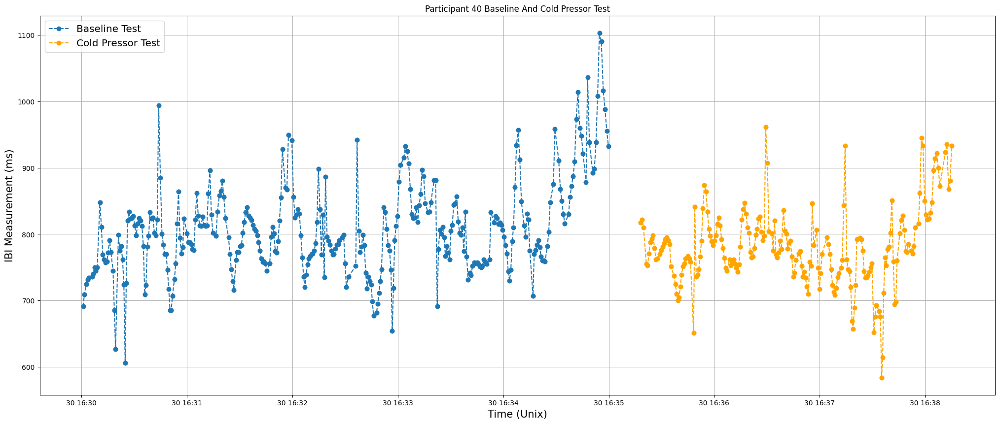

<Figure size 2500x1000 with 0 Axes>

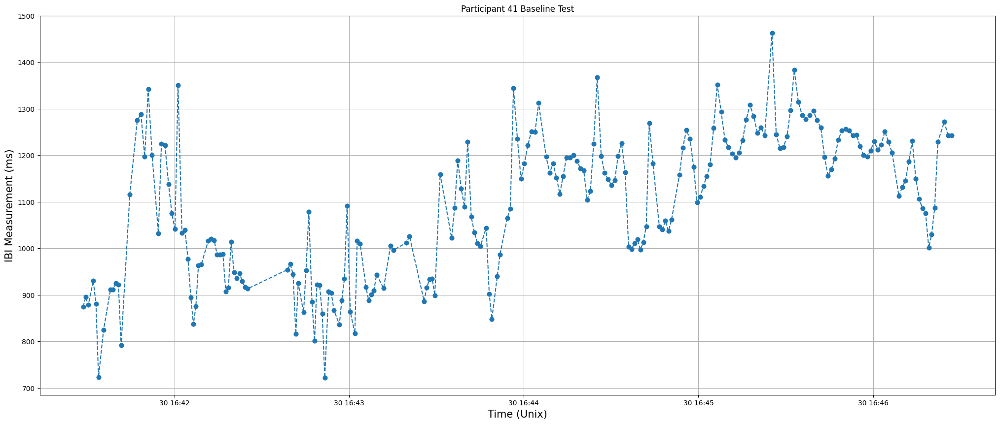

<Figure size 2500x1000 with 0 Axes>

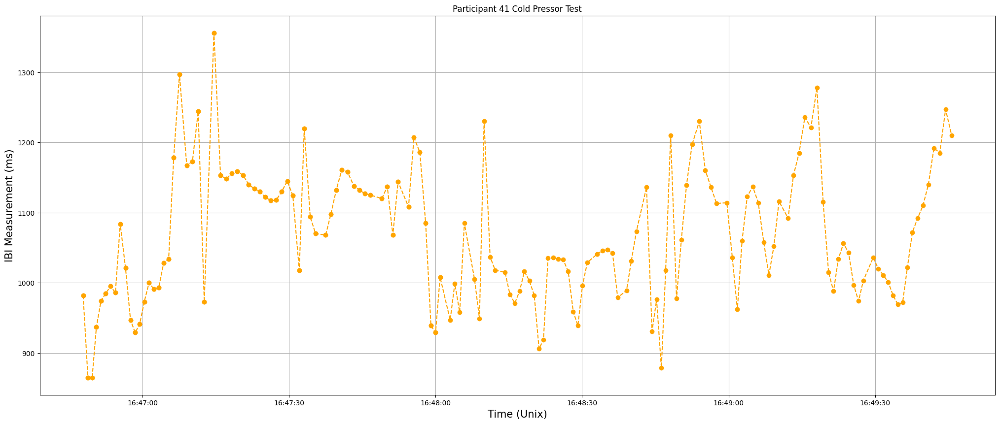

<Figure size 2500x1000 with 0 Axes>

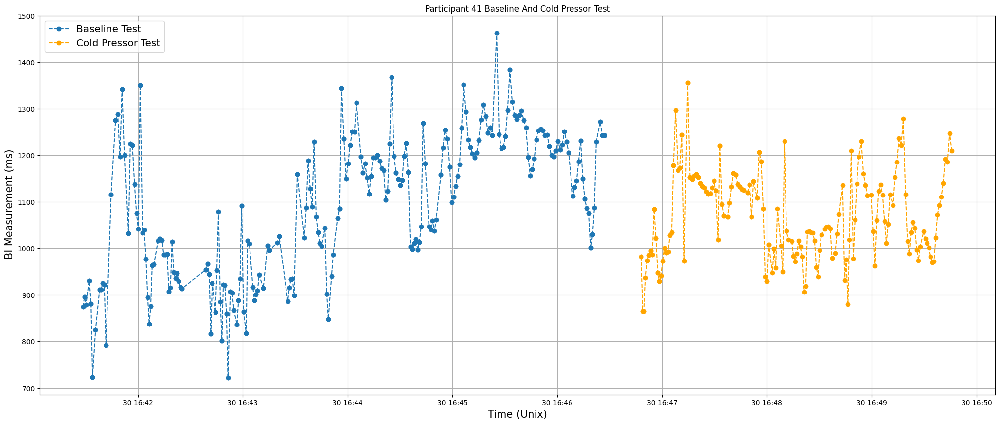

<Figure size 2500x1000 with 0 Axes>

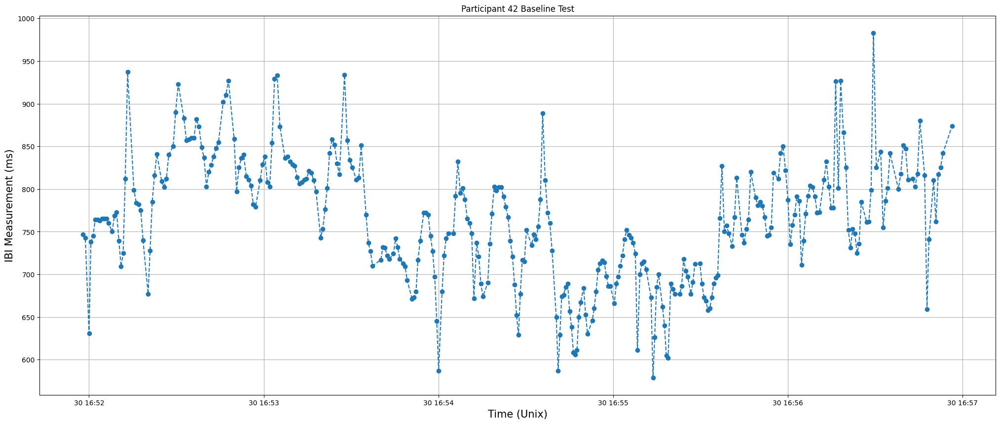

<Figure size 2500x1000 with 0 Axes>

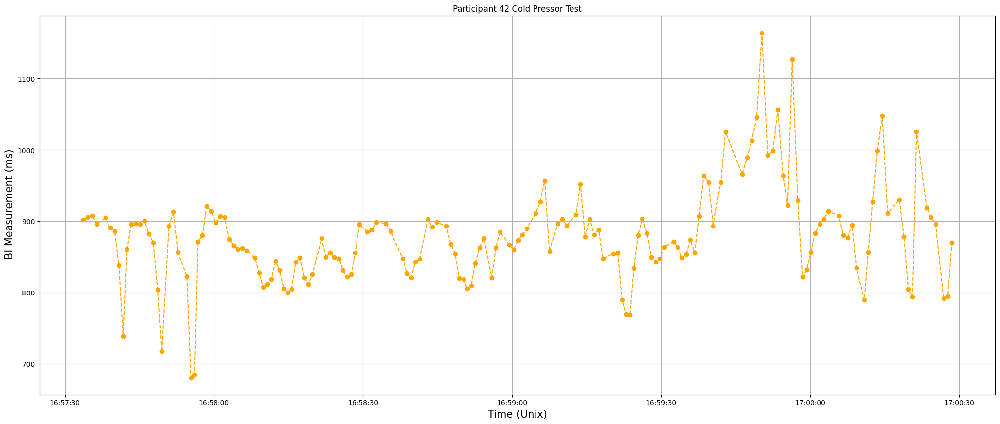

<Figure size 2500x1000 with 0 Axes>

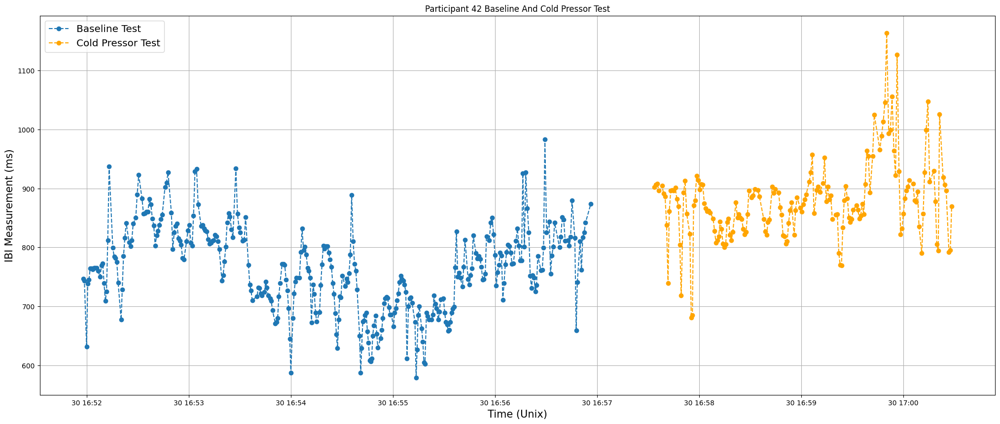

<Figure size 2500x1000 with 0 Axes>

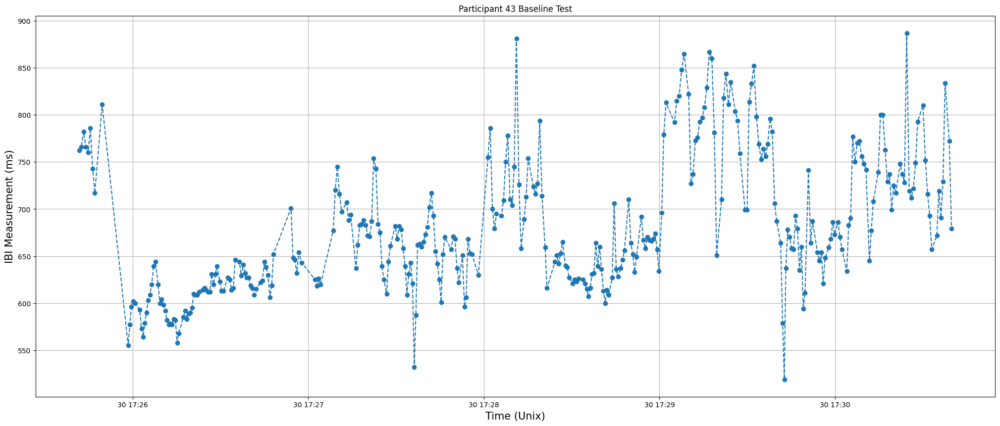

<Figure size 2500x1000 with 0 Axes>

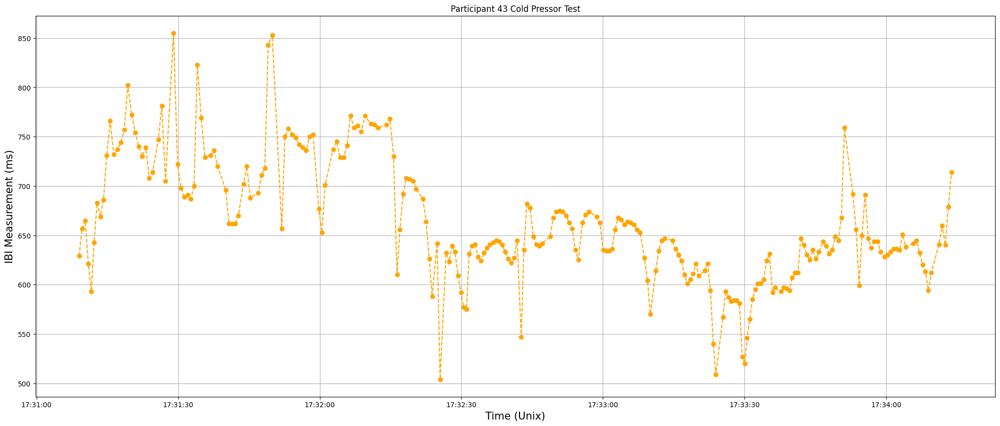

<Figure size 2500x1000 with 0 Axes>

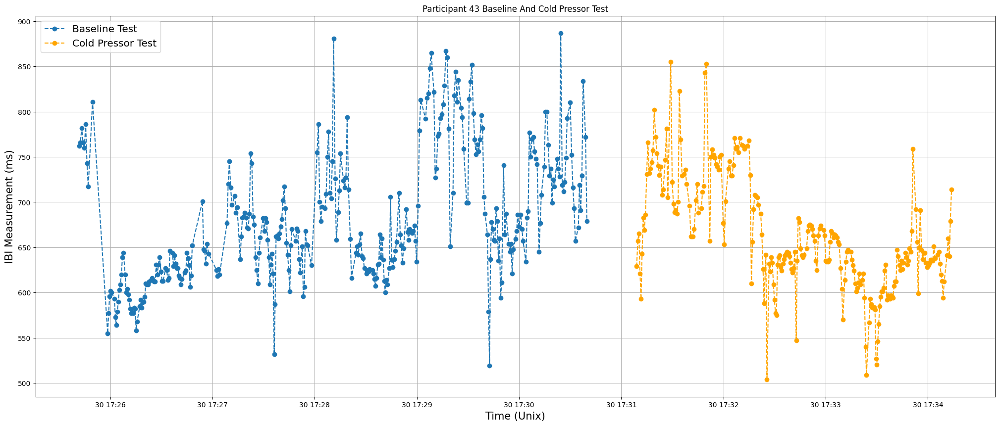

<Figure size 2500x1000 with 0 Axes>

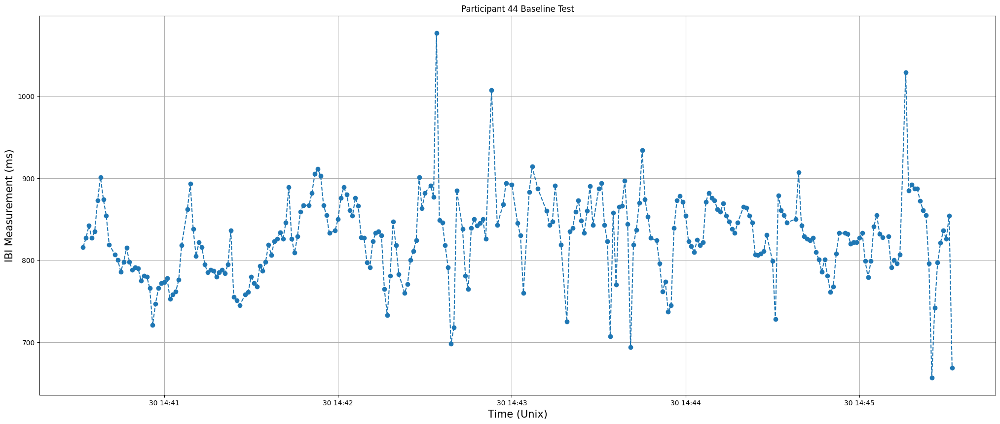

<Figure size 2500x1000 with 0 Axes>

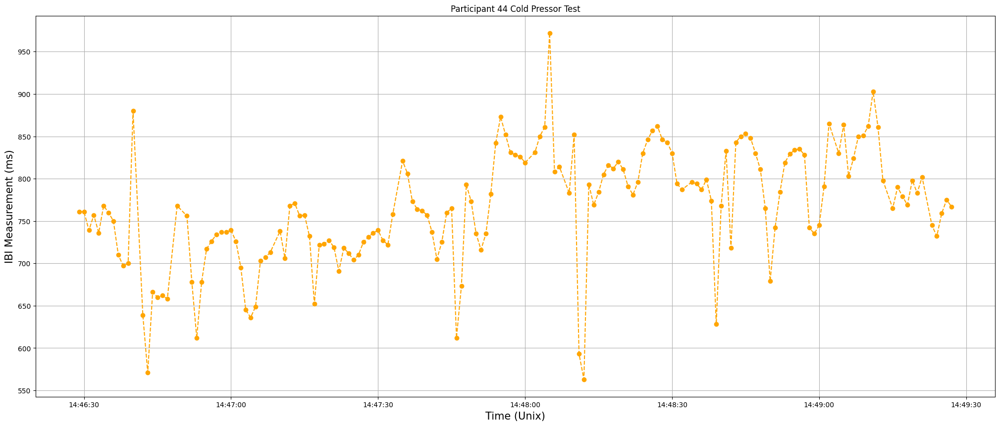

<Figure size 2500x1000 with 0 Axes>

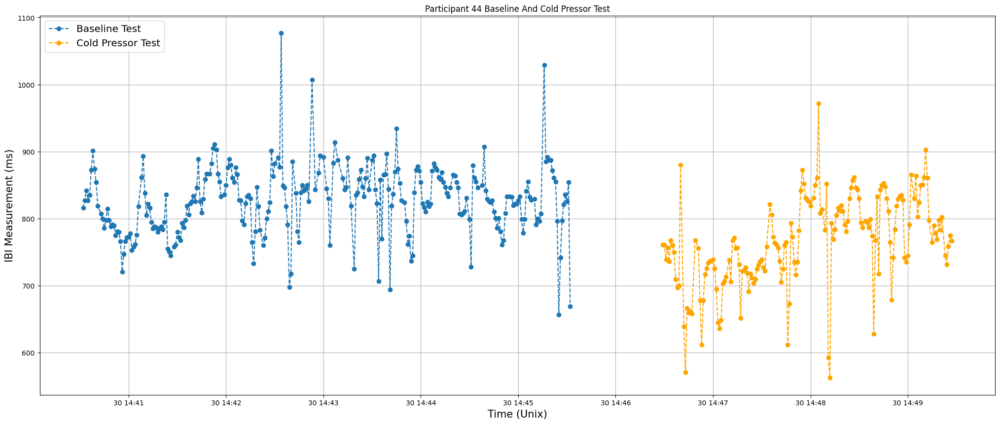

<Figure size 2500x1000 with 0 Axes>

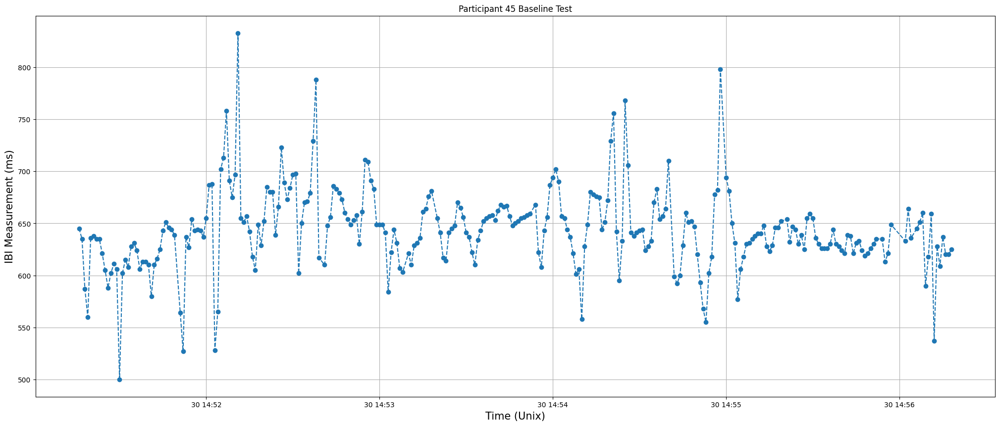

<Figure size 2500x1000 with 0 Axes>

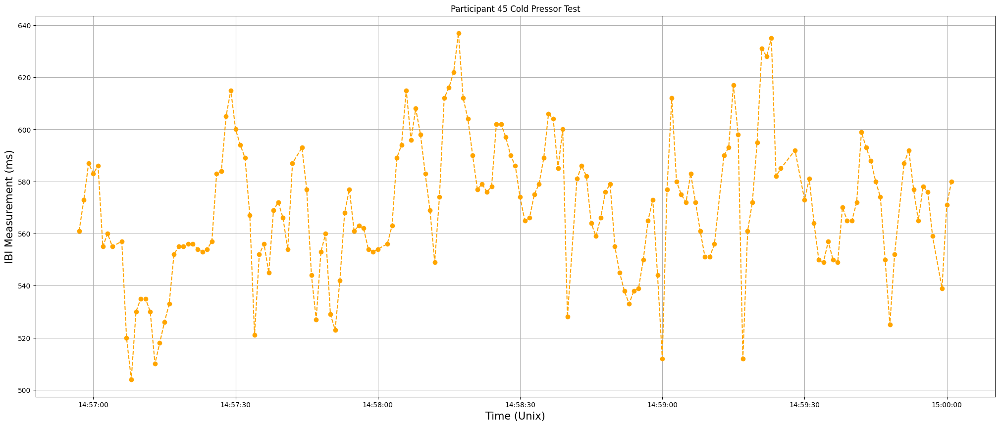

<Figure size 2500x1000 with 0 Axes>

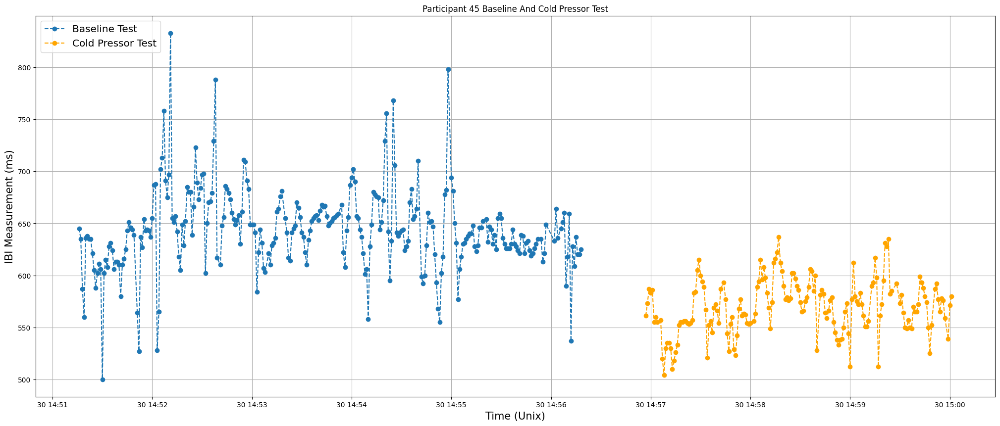

<Figure size 2500x1000 with 0 Axes>

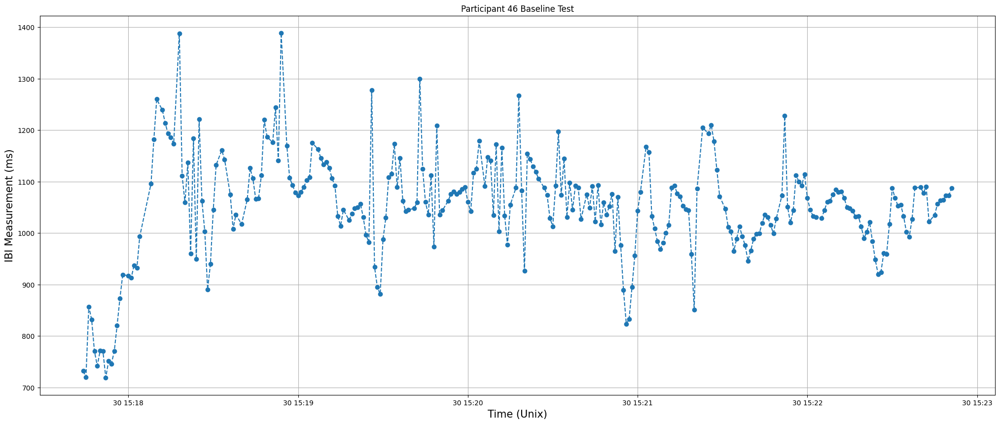

<Figure size 2500x1000 with 0 Axes>

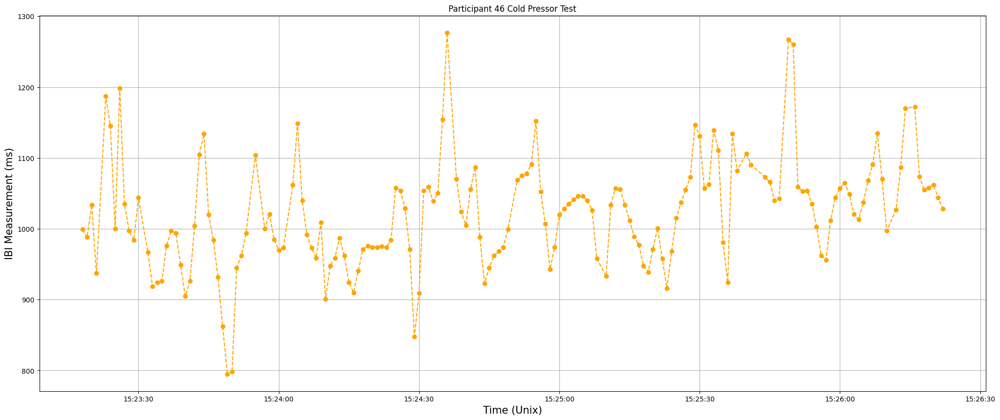

<Figure size 2500x1000 with 0 Axes>

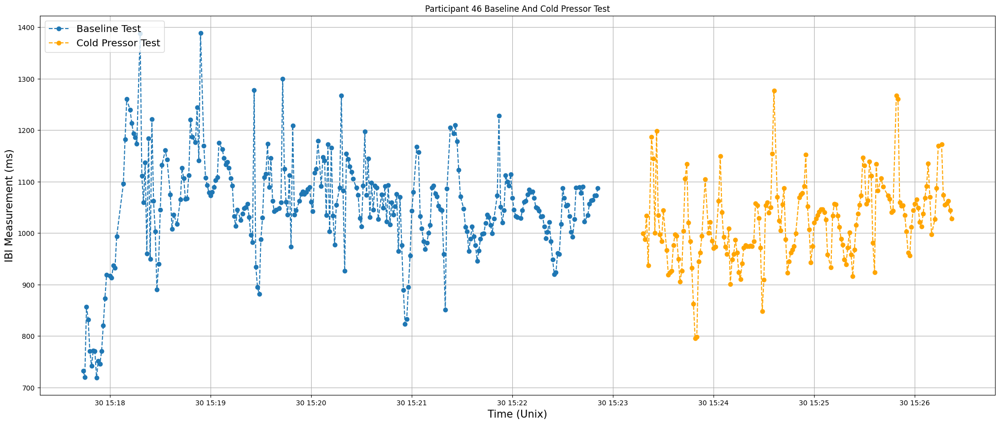

<Figure size 2500x1000 with 0 Axes>

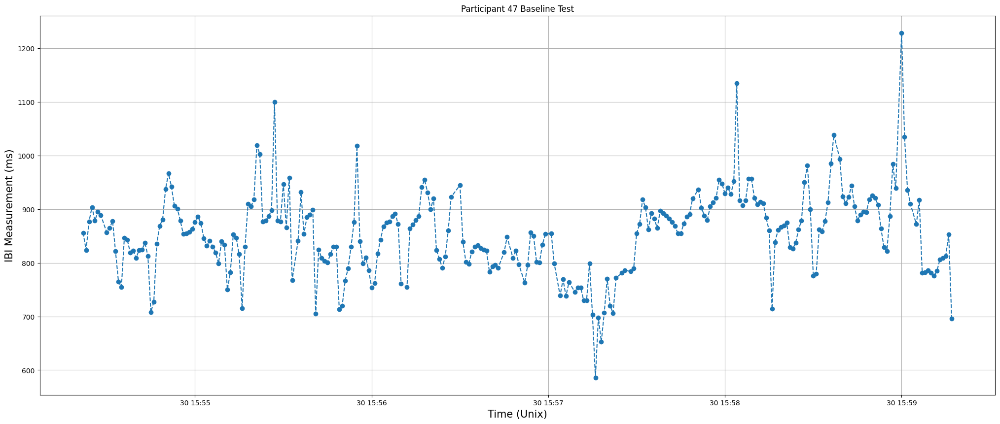

<Figure size 2500x1000 with 0 Axes>

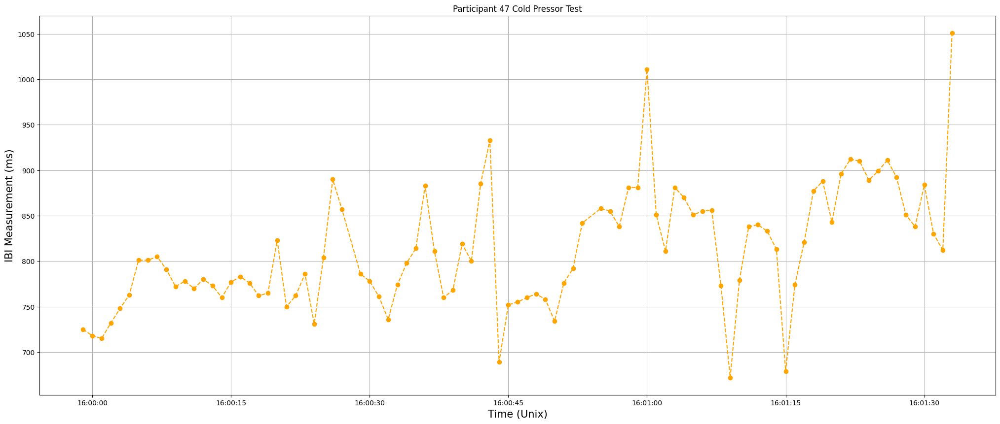

<Figure size 2500x1000 with 0 Axes>

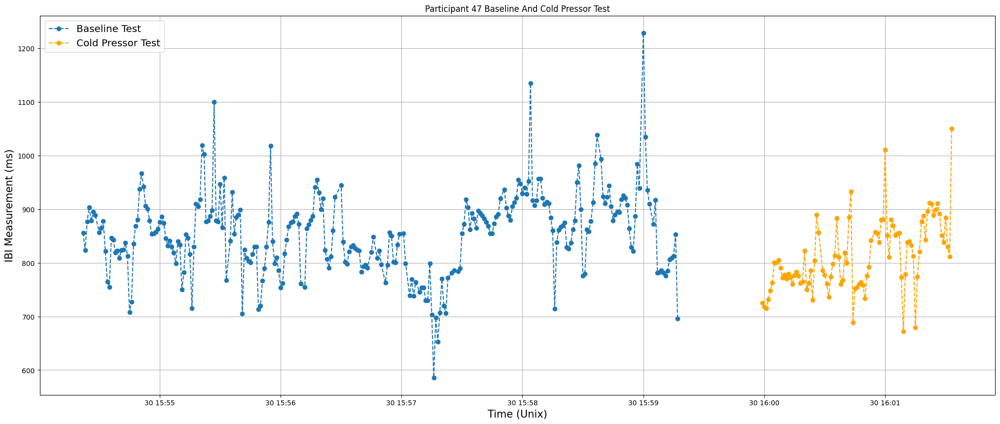

<Figure size 2500x1000 with 0 Axes>

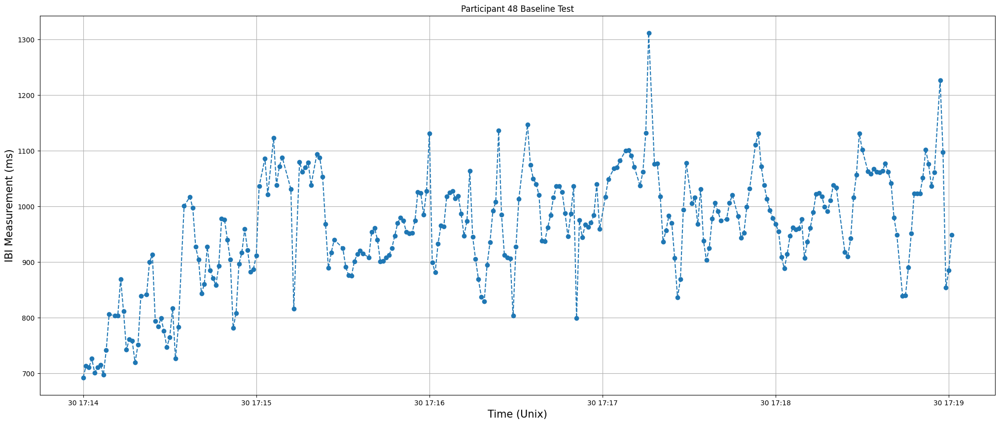

<Figure size 2500x1000 with 0 Axes>

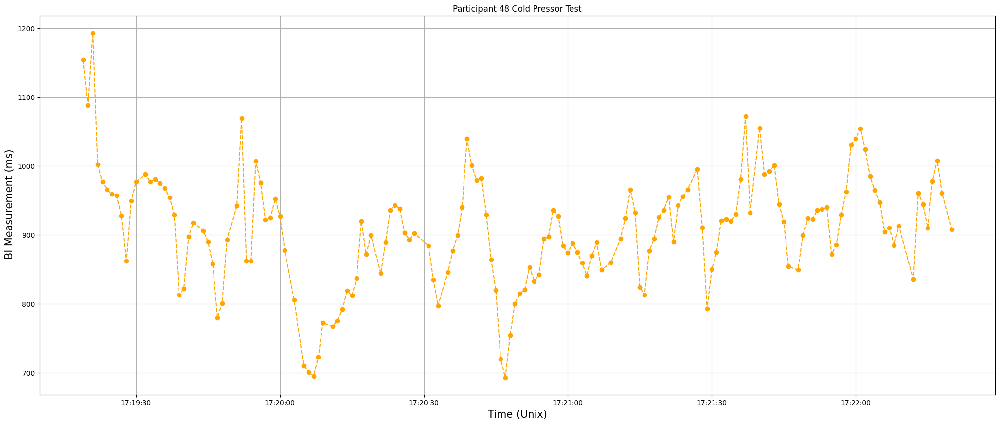

<Figure size 2500x1000 with 0 Axes>

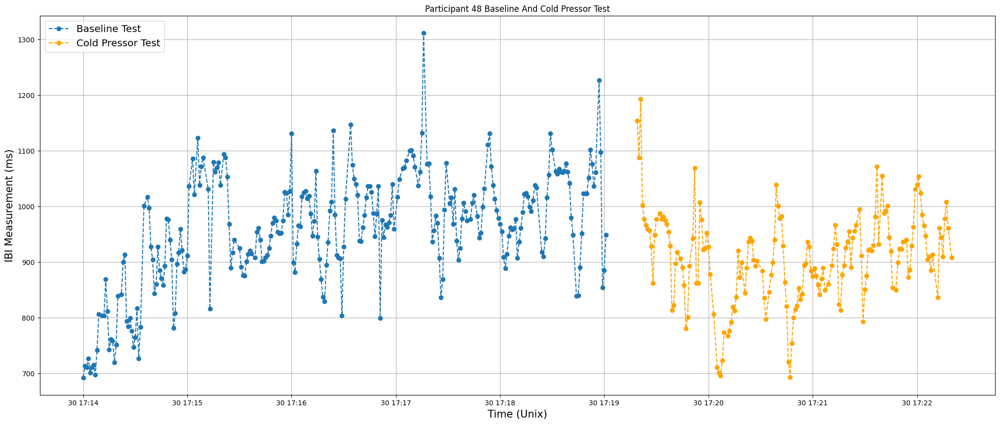

<Figure size 2500x1000 with 0 Axes>

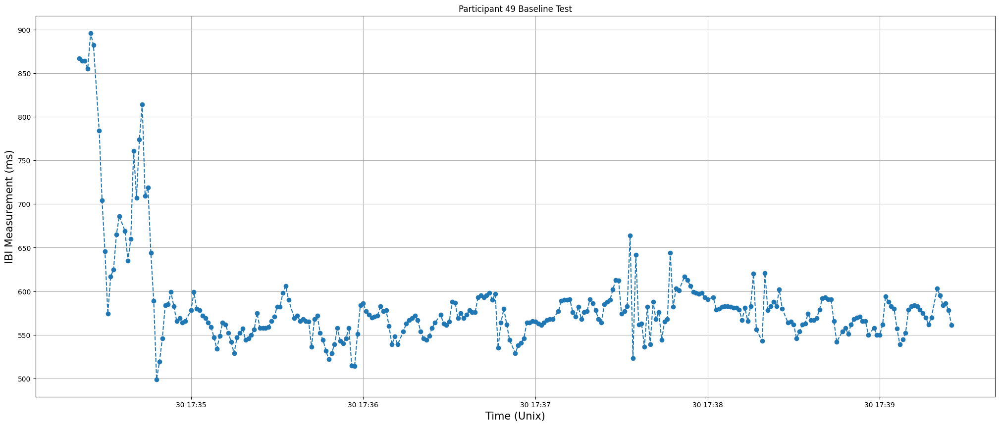

<Figure size 2500x1000 with 0 Axes>

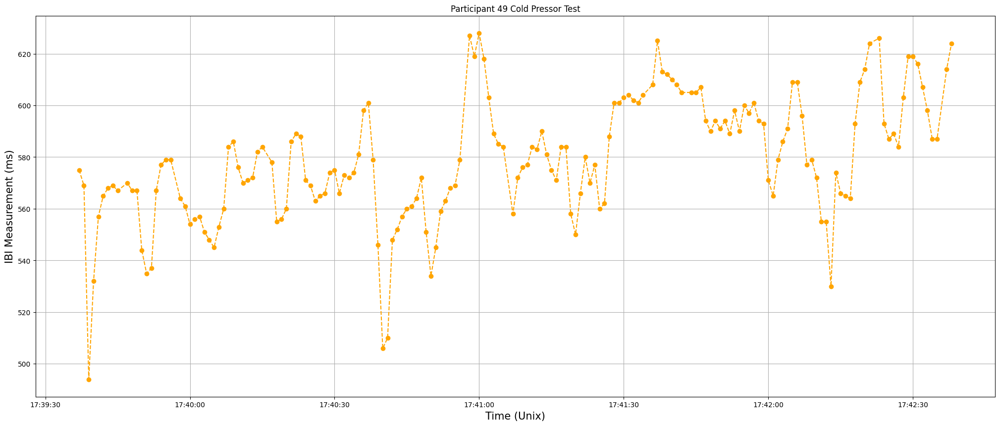

<Figure size 2500x1000 with 0 Axes>

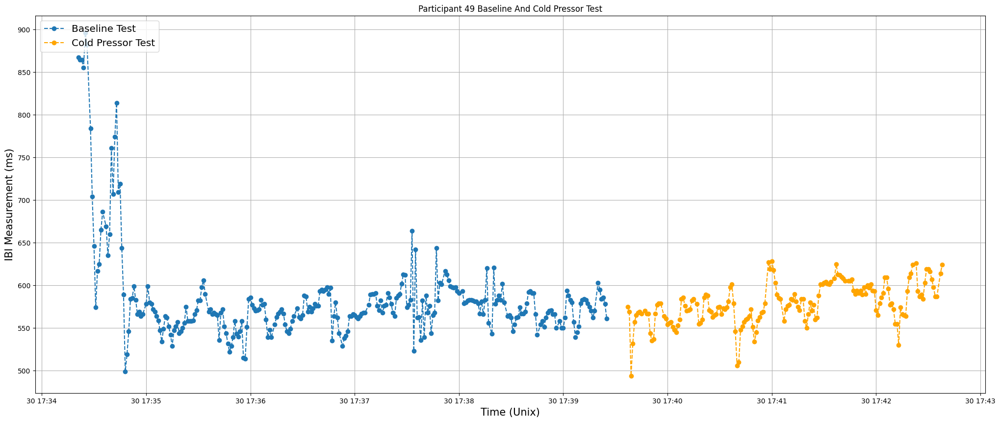

<Figure size 2500x1000 with 0 Axes>

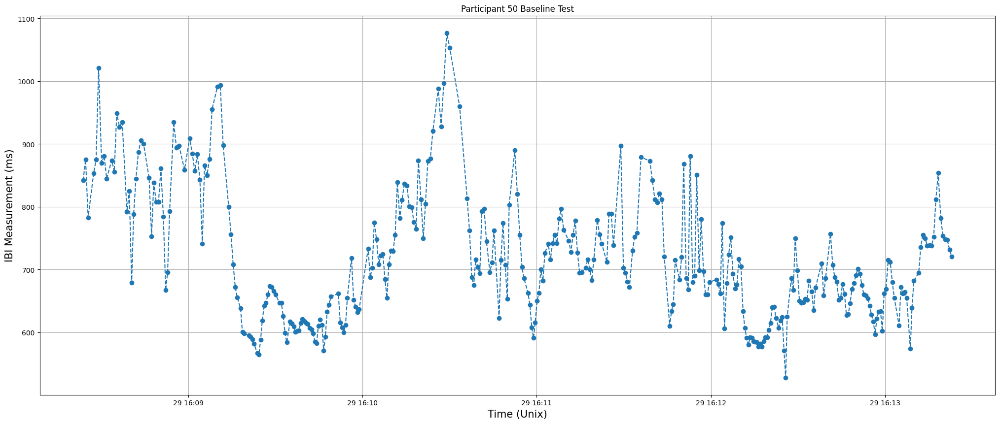

<Figure size 2500x1000 with 0 Axes>

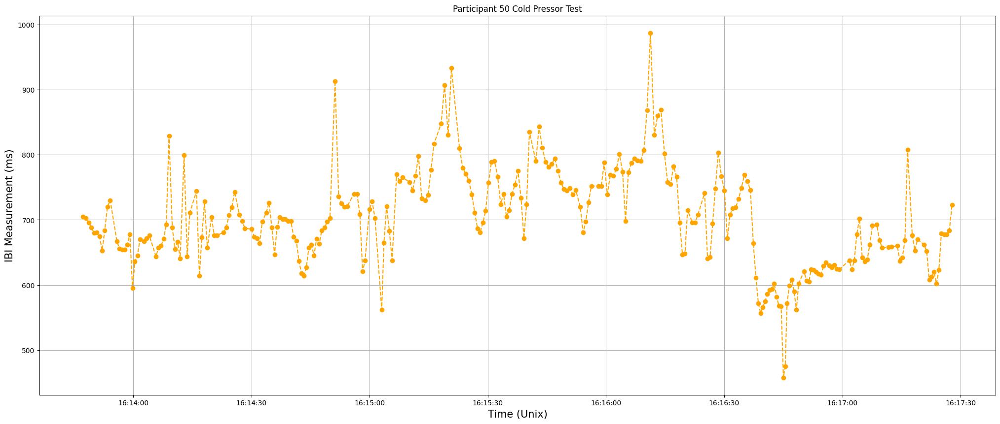

<Figure size 2500x1000 with 0 Axes>

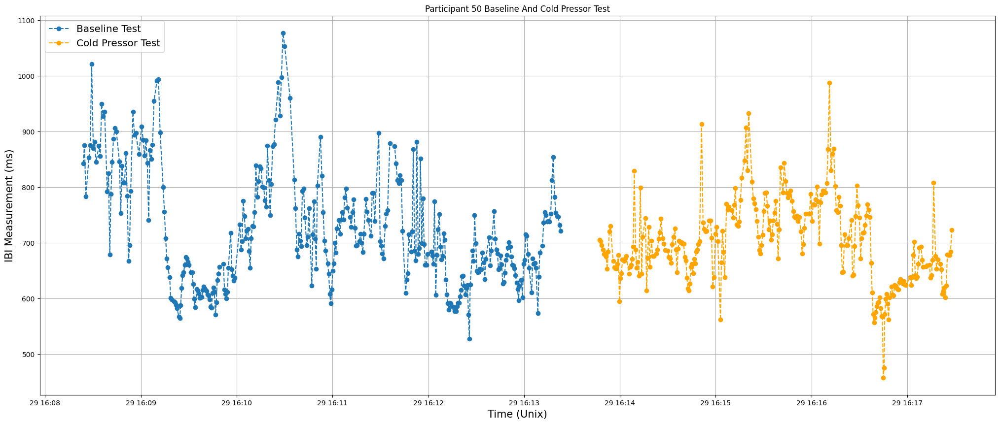

<Figure size 2500x1000 with 0 Axes>

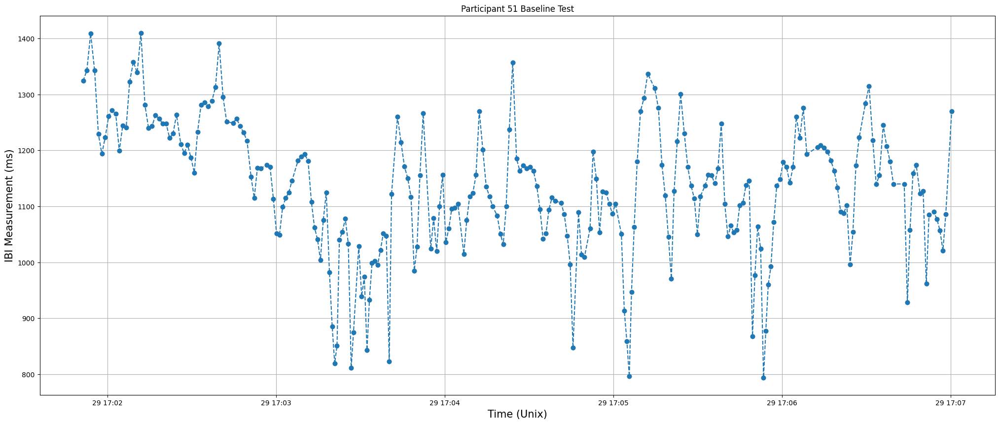

<Figure size 2500x1000 with 0 Axes>

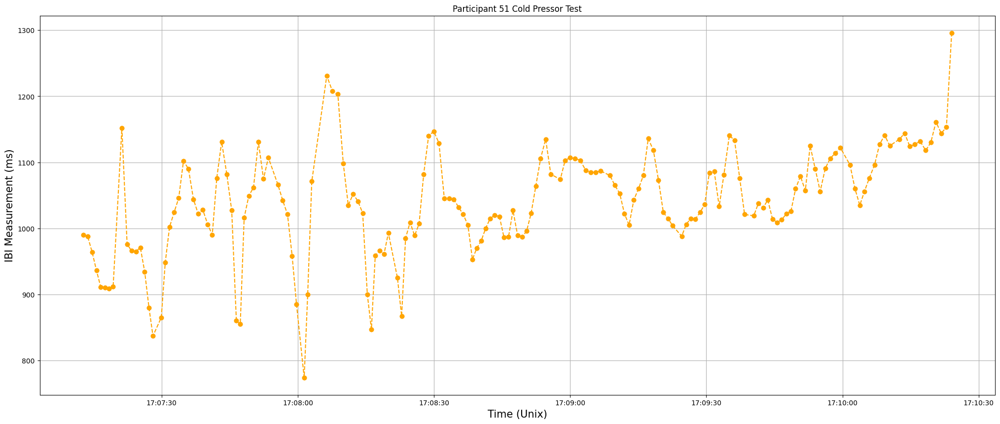

<Figure size 2500x1000 with 0 Axes>

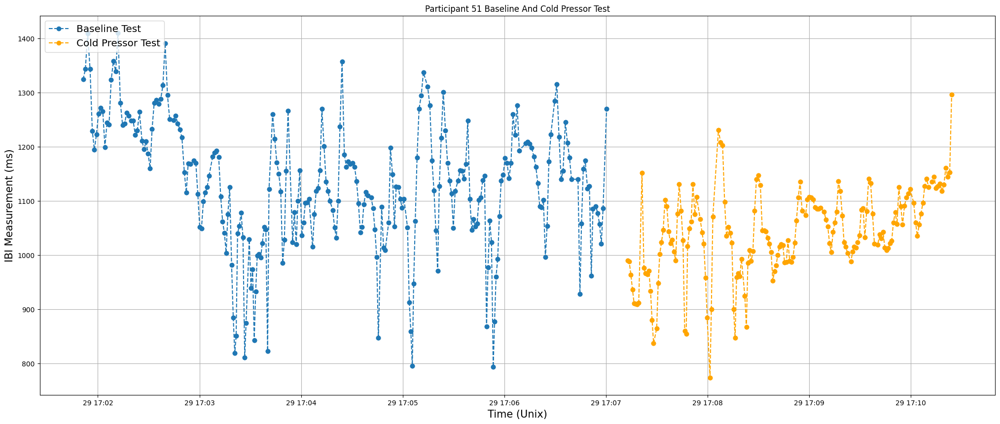

<Figure size 2500x1000 with 0 Axes>

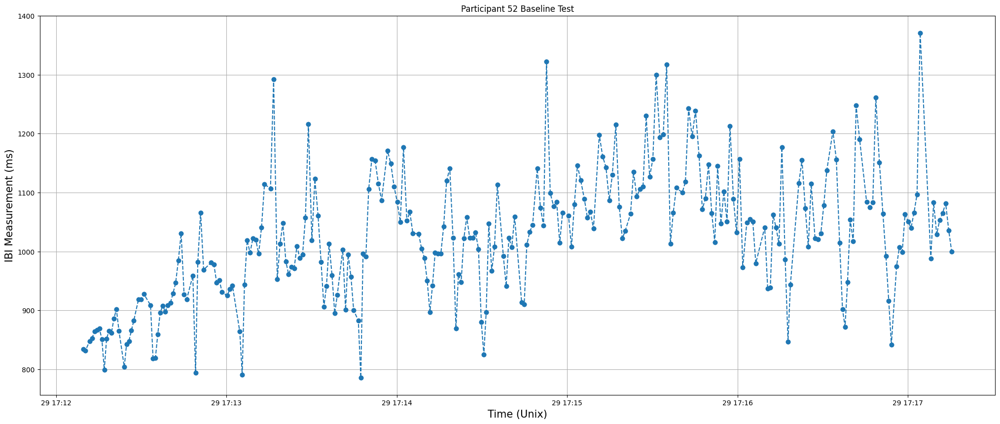

<Figure size 2500x1000 with 0 Axes>

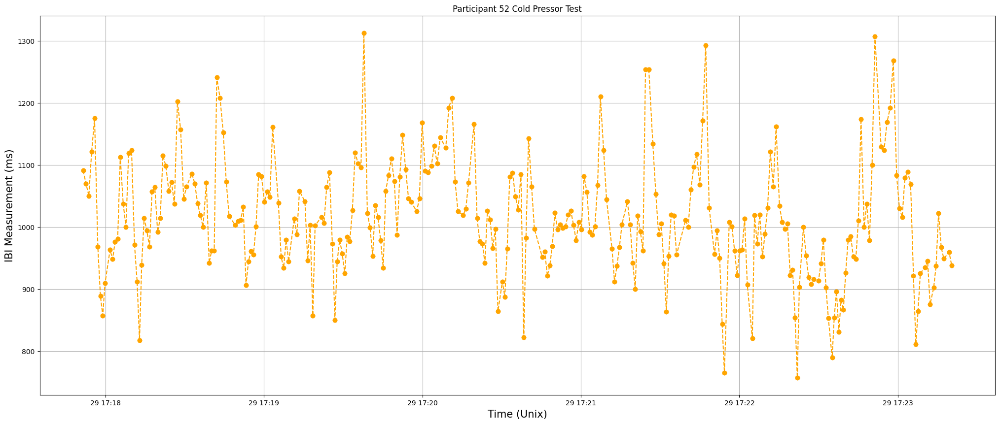

<Figure size 2500x1000 with 0 Axes>

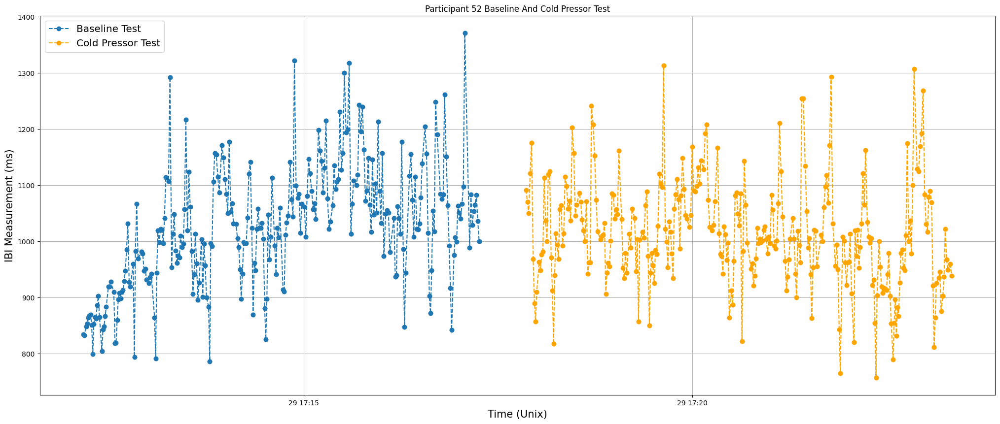

<Figure size 2500x1000 with 0 Axes>

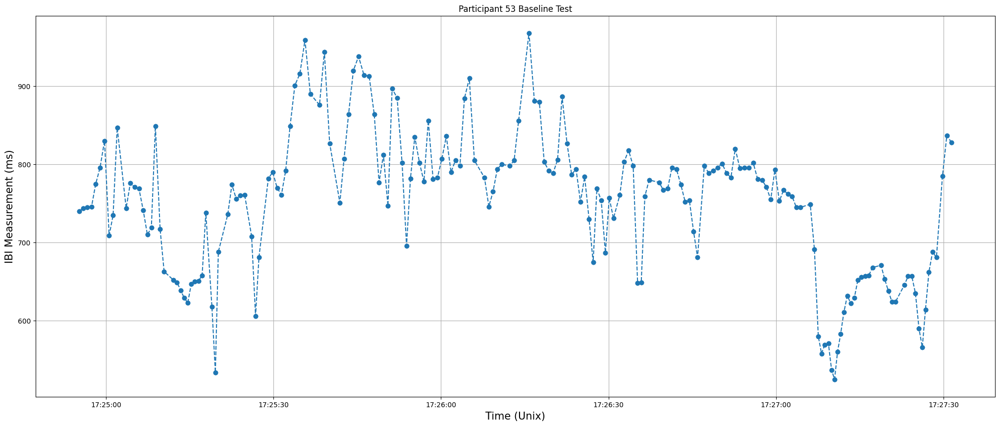

<Figure size 2500x1000 with 0 Axes>

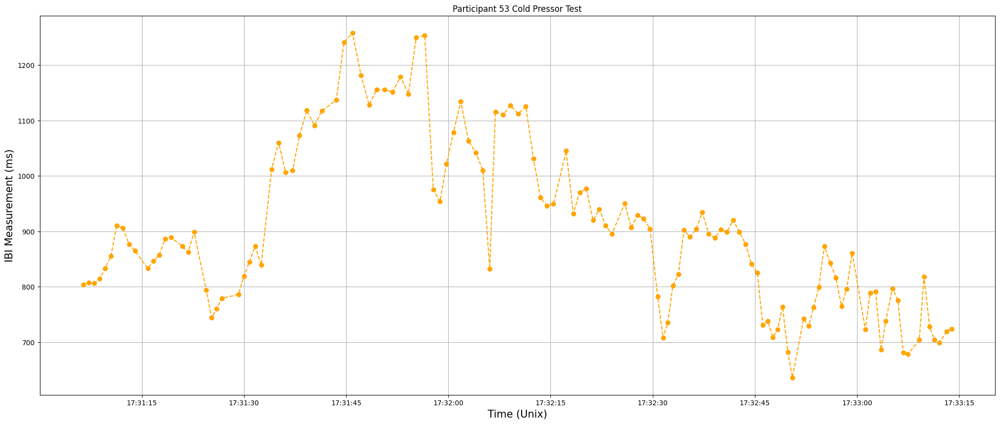

<Figure size 2500x1000 with 0 Axes>

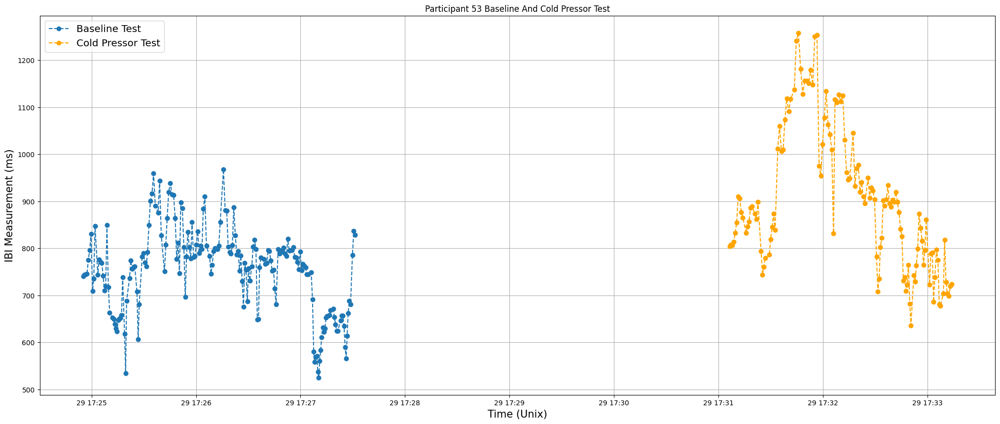

<Figure size 2500x1000 with 0 Axes>

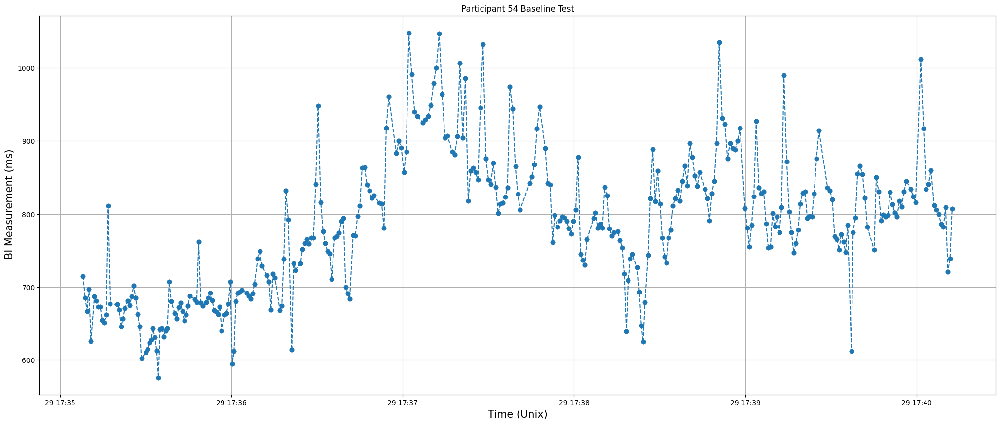

<Figure size 2500x1000 with 0 Axes>

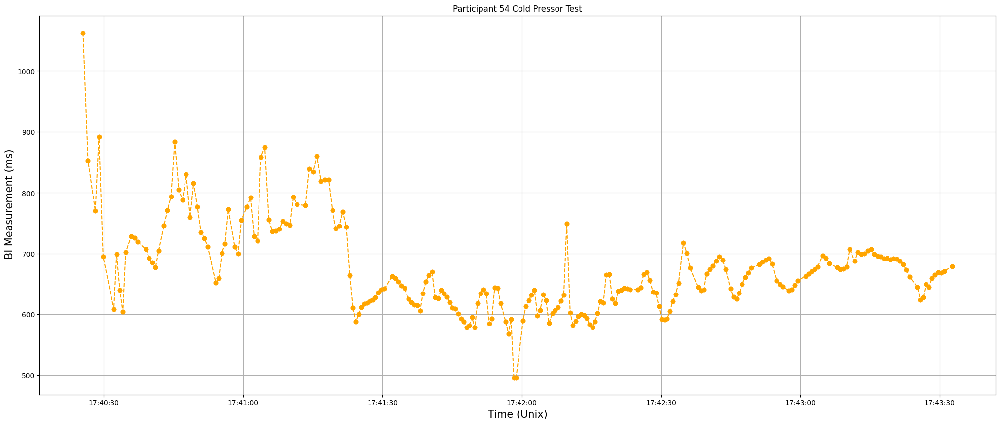

<Figure size 2500x1000 with 0 Axes>

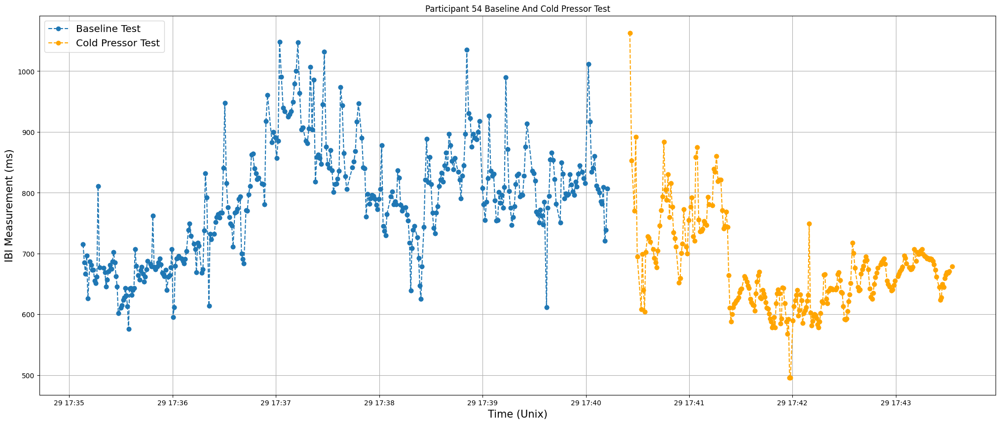

<Figure size 2500x1000 with 0 Axes>

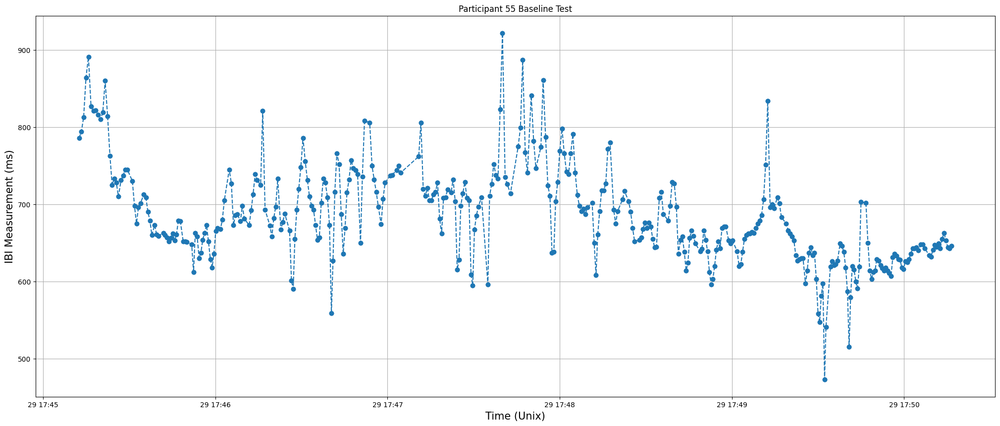

<Figure size 2500x1000 with 0 Axes>

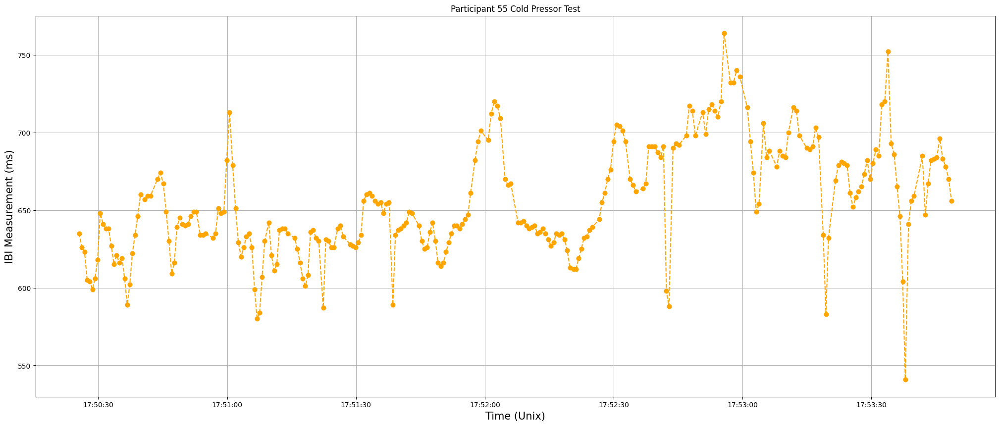

<Figure size 2500x1000 with 0 Axes>

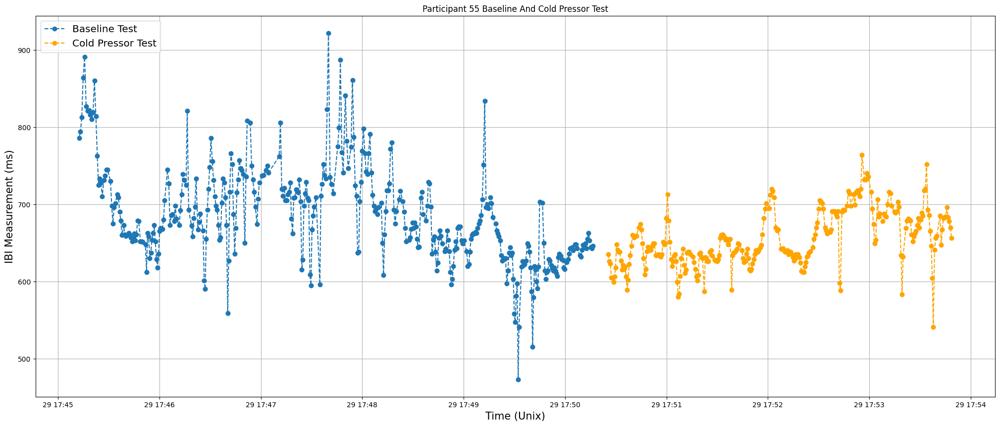

<Figure size 2500x1000 with 0 Axes>

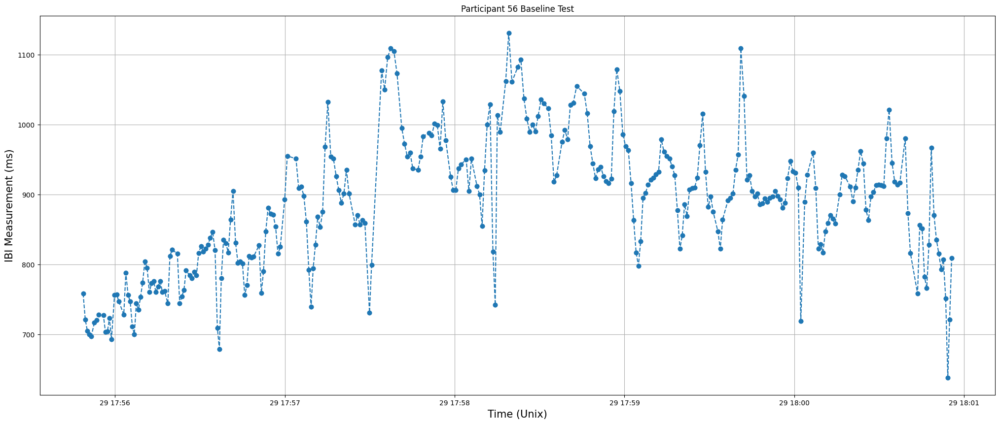

<Figure size 2500x1000 with 0 Axes>

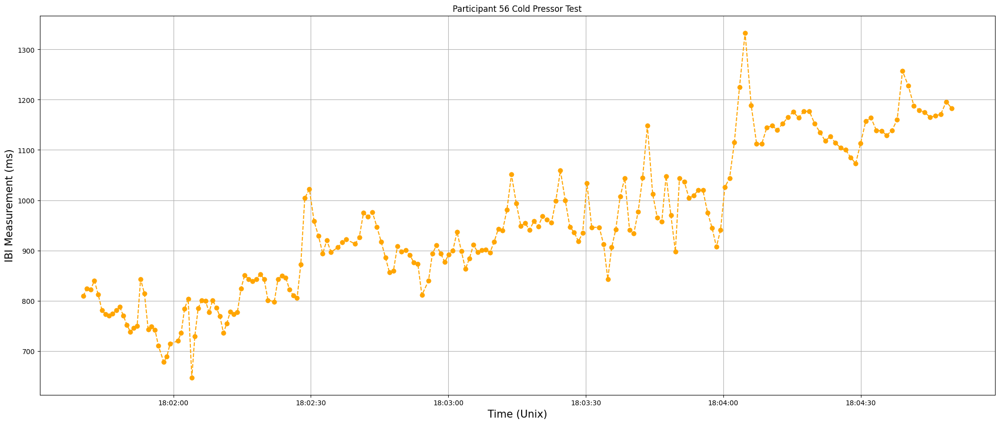

<Figure size 2500x1000 with 0 Axes>

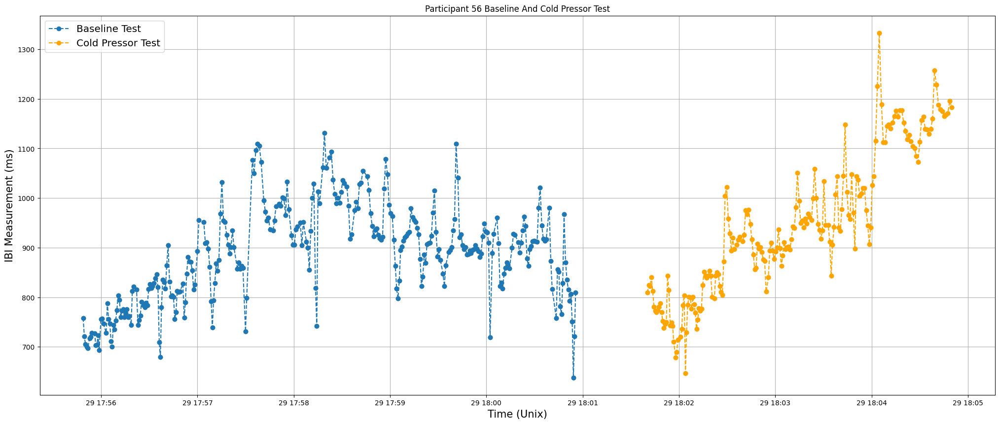

<Figure size 2500x1000 with 0 Axes>

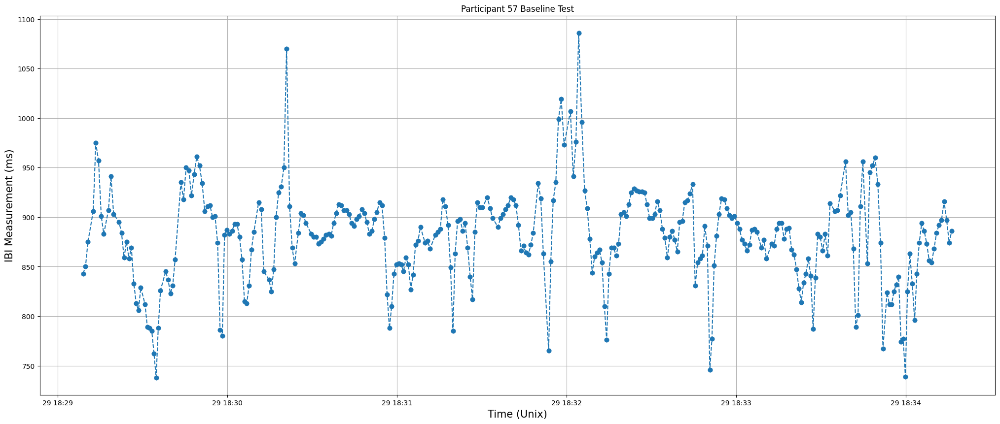

<Figure size 2500x1000 with 0 Axes>

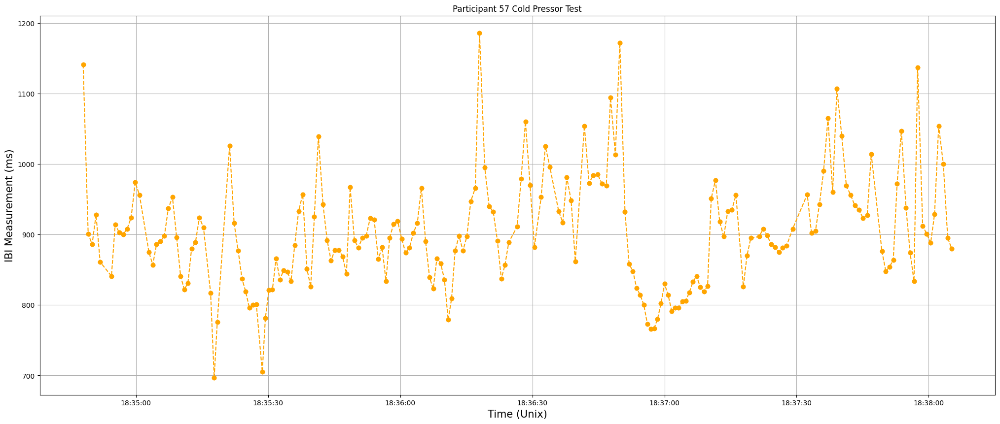

<Figure size 2500x1000 with 0 Axes>

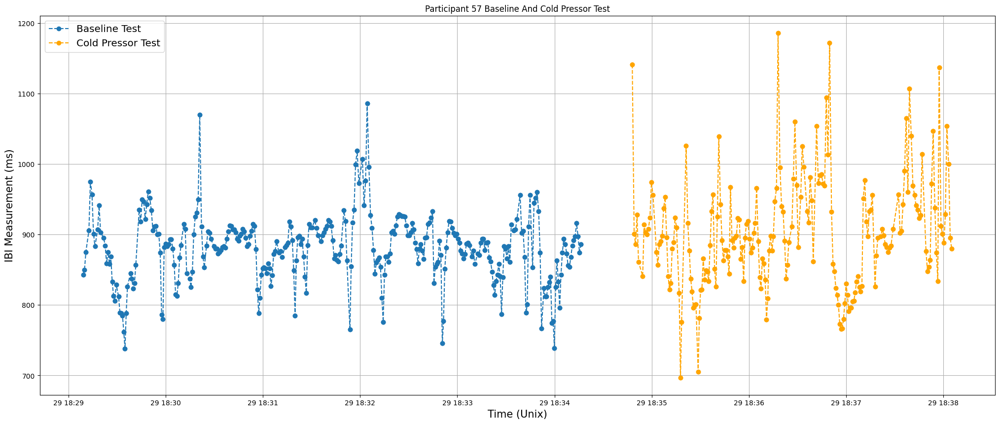

<Figure size 2500x1000 with 0 Axes>

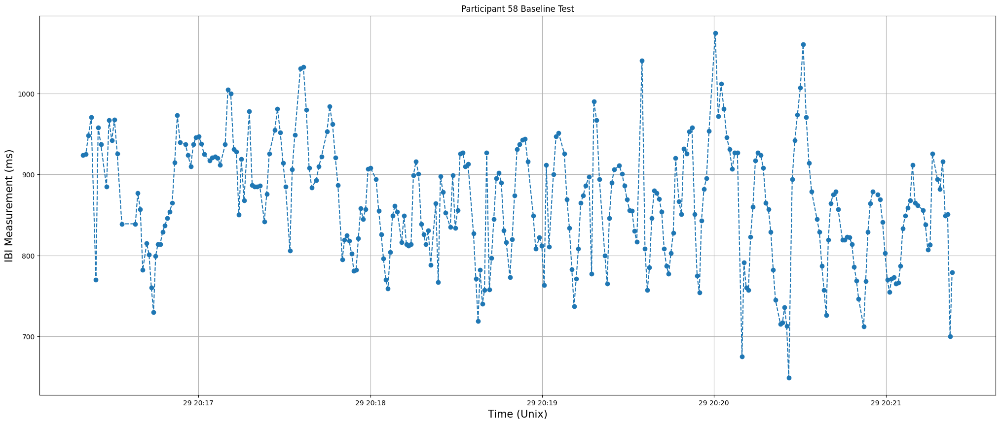

<Figure size 2500x1000 with 0 Axes>

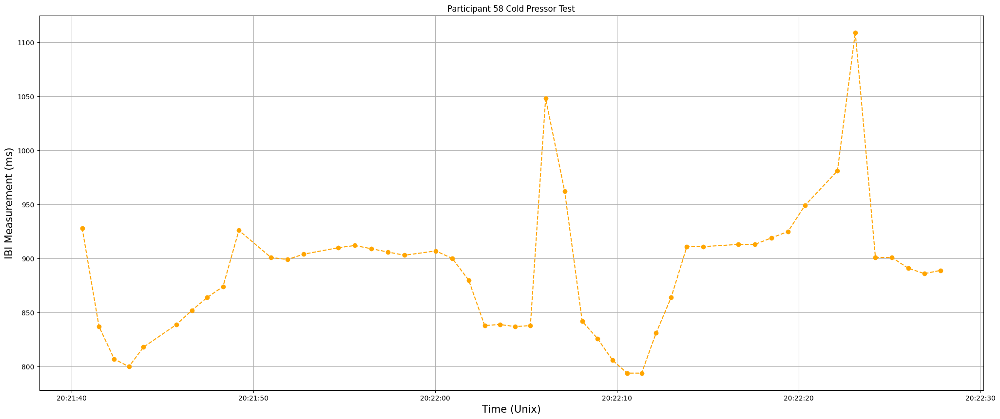

<Figure size 2500x1000 with 0 Axes>

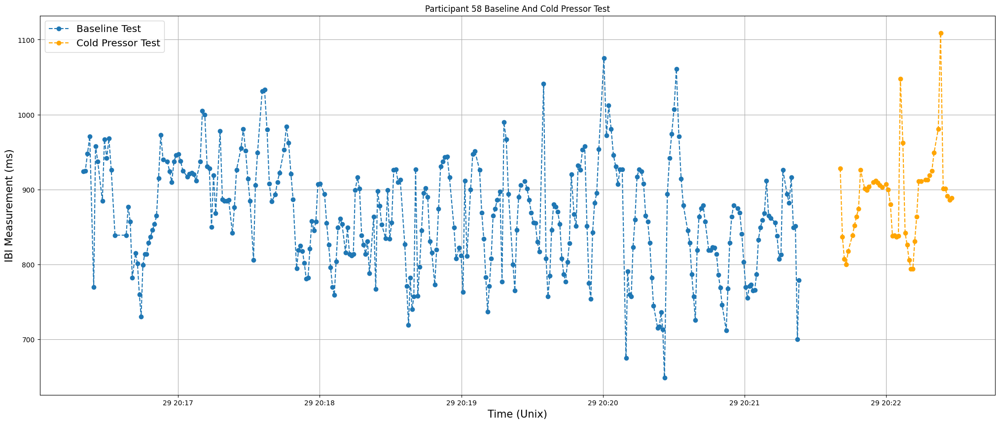

<Figure size 2500x1000 with 0 Axes>

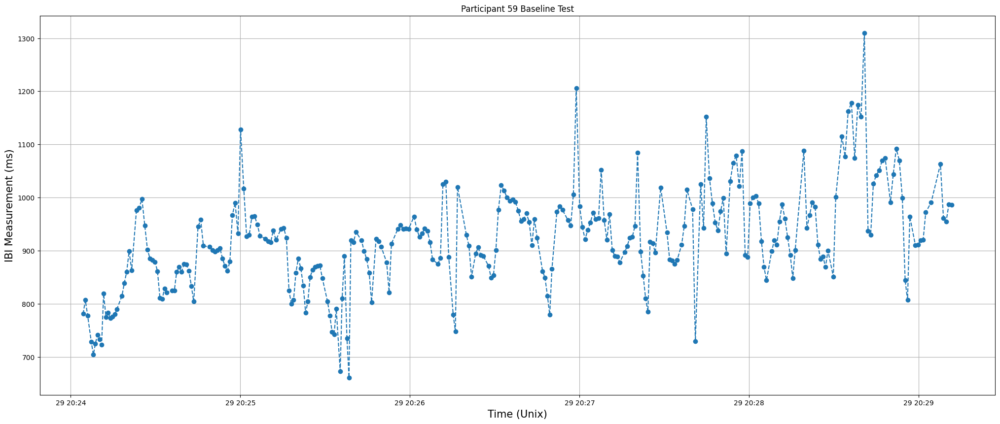

<Figure size 2500x1000 with 0 Axes>

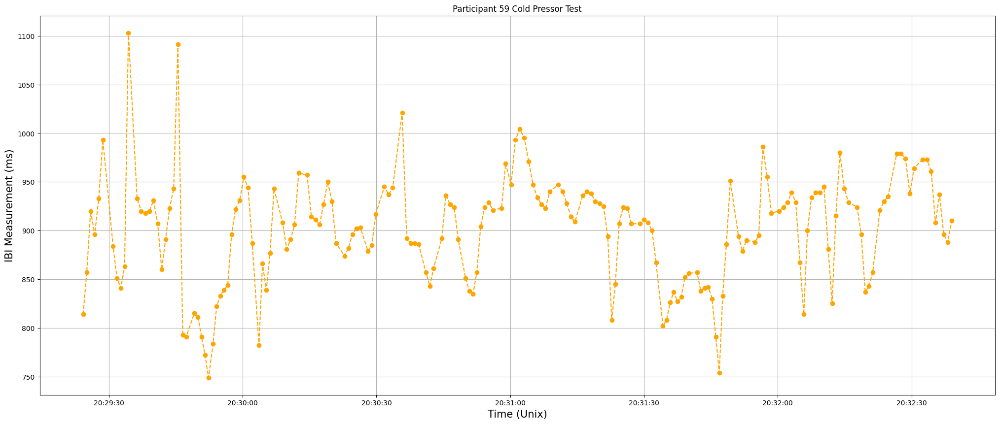

<Figure size 2500x1000 with 0 Axes>

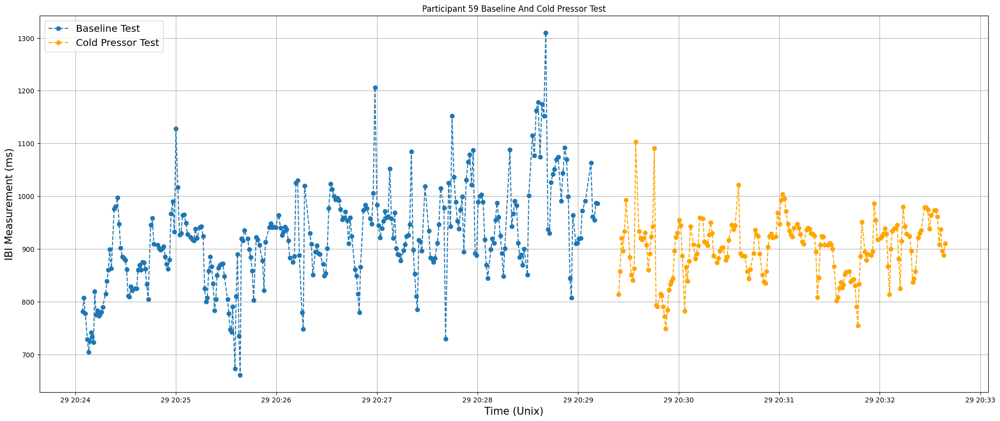

<Figure size 2500x1000 with 0 Axes>

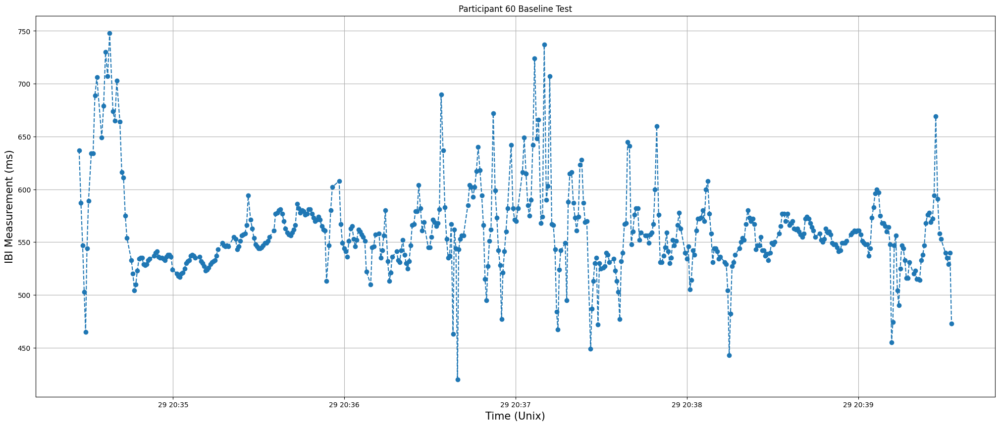

<Figure size 2500x1000 with 0 Axes>

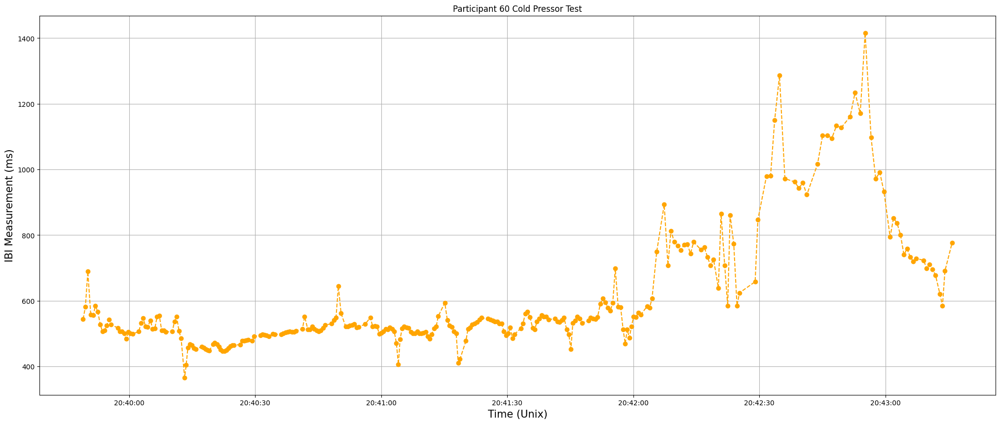

<Figure size 2500x1000 with 0 Axes>

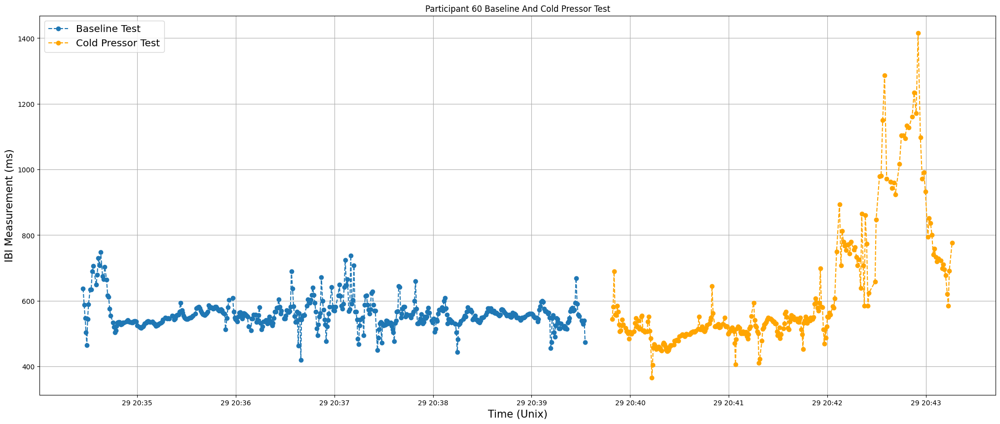

<Figure size 2500x1000 with 0 Axes>

In [31]:
#plot all data for all participants

participants = [Participant for i in range(100)]
# print(participants)

n = 1
while (n<61):
    
    if(n != 2 and (n < 17 or n > 31) and n != 5):  #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_CPT.csv",n)
        participants[n].plot_baseline()
        plt.clf()
        participants[n].plot_coldpressor()
        plt.clf()
        participants[n].plot_both()
        plt.clf()
        
    n = n + 1

In [14]:
#get training and test datasets

participants = [Participant for i in range(100)]

n = 1
while (n<61):
    
    if(n != 2 and (n < 17 or n > 31) and n != 5): #No participants 2,17-31. Participant 5 has missing values
        participants[n] = Participant("C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_BL.csv",
                                      "C:\\Users\\C23Price.Johnson\\Desktop\\Capstone\\Capstone Project\\Pain-Identification\\src\\raw_data\\raw_data_garmin\\participant_" + str(n) + "_CPT.csv",n)
        output = participants[n].splitIntoTrainTestColdPressorDataset()
        print("Train Dataset: " + str(output[0]))
        print("Test Dataset: " + str(output[1]))
        
    n = n + 1


Train Dataset: [[1637166708614 906]
 [1637166708614 906]
 [1637166708614 906]
 ...
 [1637166766874 838]
 [1637166766874 838]
 [1637166766874 838]]
Test Dataset: [[1637166766874 838]
 [1637166766874 838]
 [1637166766874 838]
 ...
 [1637166783565 831]
 [1637166783565 831]
 [1637166783565 831]]
Train Dataset: [[1637168202736 816]
 [1637168202736 816]
 [1637168202736 816]
 ...
 [1637168312651 507]
 [1637168312651 507]
 [1637168312651 507]]
Test Dataset: [[1637168312651 507]
 [1637168312651 507]
 [1637168312651 507]
 ...
 [1637168347546 646]
 [1637168347546 646]
 [1637168347546 646]]
Train Dataset: [[1637168644227 485]
 [1637168644227 485]
 [1637168644227 485]
 ...
 [1637168788322 489]
 [1637168788322 489]
 [1637168788322 489]]
Test Dataset: [[1637168788811 489]
 [1637168788811 489]
 [1637168788811 489]
 ...
 [1637168838486 533]
 [1637168838486 533]
 [1637168838486 533]]
Train Dataset: [[1637168901049 487]
 [1637168901049 487]
 [1637168901049 487]
 ...
 [1637169082895 681]
 [1637169082895 6

Train Dataset: [[1643559909547 854]
 [1643559909547 854]
 [1643559910401 838]
 [1643559910401 838]
 [1643559911975 850]
 [1643559911975 850]
 [1643559912825 870]
 [1643559912825 870]
 [1643559913695 925]
 [1643559913695 925]
 [1643559915621 819]
 [1643559915621 819]
 [1643559917879 793]
 [1643559917879 793]
 [1643559920708 888]
 [1643559920708 888]
 [1643559921596 994]
 [1643559921596 994]
 [1643559924079 889]
 [1643559924079 889]
 [1643559924968 857]
 [1643559924968 857]
 [1643559925825 714]
 [1643559925825 714]
 [1643559926539 854]
 [1643559926539 854]
 [1643559927393 881]
 [1643559927393 881]
 [1643559929111 955]
 [1643559929111 955]
 [1643559930066 903]
 [1643559930066 903]
 [1643559930969 929]
 [1643559930969 929]
 [1643559932901 843]
 [1643559932901 843]
 [1643559933744 896]
 [1643559933744 896]
 [1643559934640 966]
 [1643559934640 966]
 [1643559935606 818]
 [1643559935606 818]
 [1643559936424 800]
 [1643559936424 800]
 [1643559937832 841]
 [1643559937832 841]
 [1643559938673 862

Train Dataset: [[1643564376000 583]
 [1643564377000 575]
 [1643564378000 569]
 [1643564379000 494]
 [1643564380000 532]
 [1643564381000 557]
 [1643564382000 565]
 [1643564383000 568]
 [1643564384000 569]
 [1643564385000 567]
 [1643564387000 570]
 [1643564388000 567]
 [1643564389000 567]
 [1643564390000 544]
 [1643564391000 535]
 [1643564392000 537]
 [1643564393000 567]
 [1643564394000 577]
 [1643564395000 579]
 [1643564396000 579]
 [1643564398000 564]
 [1643564399000 561]
 [1643564400000 554]
 [1643564401000 556]
 [1643564402000 557]
 [1643564403000 551]
 [1643564404000 548]
 [1643564405000 545]
 [1643564406000 553]
 [1643564407000 560]
 [1643564408000 584]
 [1643564409000 586]
 [1643564410000 576]
 [1643564411000 570]
 [1643564412000 571]
 [1643564413000 572]
 [1643564414000 582]
 [1643564415000 584]
 [1643564417000 578]
 [1643564418000 555]
 [1643564419000 556]
 [1643564420000 560]
 [1643564421000 586]
 [1643564422000 589]
 [1643564423000 588]
 [1643564424000 571]
 [1643564425000 569

Train Dataset: [[1643479300301 809]
 [1643479300301 809]
 [1643479301110 824]
 [1643479301110 824]
 [1643479301936 822]
 [1643479301936 822]
 [1643479302758 840]
 [1643479302758 840]
 [1643479303598 812]
 [1643479303598 812]
 [1643479304410 781]
 [1643479304410 781]
 [1643479305191 773]
 [1643479305191 773]
 [1643479305966 770]
 [1643479305966 770]
 [1643479306736 774]
 [1643479306736 774]
 [1643479307510 781]
 [1643479307510 781]
 [1643479308291 788]
 [1643479308291 788]
 [1643479309079 770]
 [1643479309079 770]
 [1643479309852 752]
 [1643479309852 752]
 [1643479310604 738]
 [1643479310604 738]
 [1643479311342 746]
 [1643479311342 746]
 [1643479312088 750]
 [1643479312088 750]
 [1643479312838 843]
 [1643479312838 843]
 [1643479313684 814]
 [1643479313684 814]
 [1643479314498 743]
 [1643479314498 743]
 [1643479315241 749]
 [1643479315241 749]
 [1643479315990 742]
 [1643479315990 742]
 [1643479316732 710]
 [1643479316732 710]
 [1643479317896 678]
 [1643479317896 678]
 [1643479318574 689

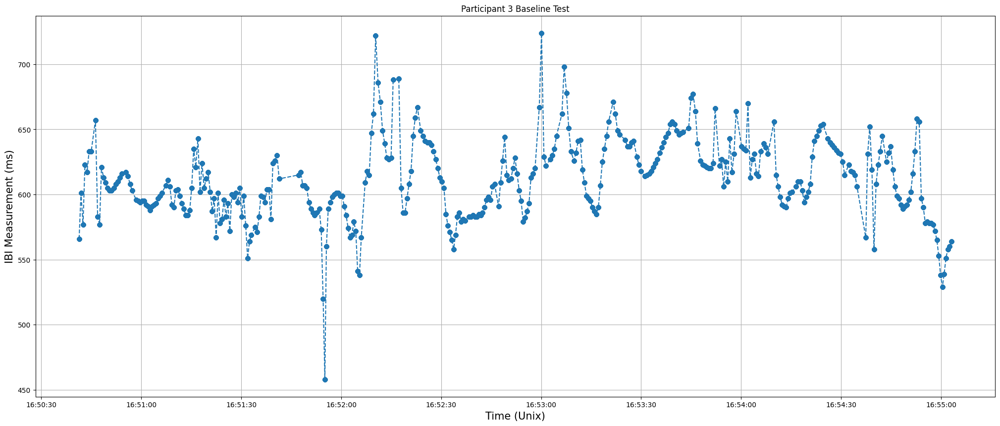

In [20]:
# plot participant 3 baseline test

# read values
df_p1 = pandas.read_csv(r"C:\Users\C23Price.Johnson\Desktop\Capstone\Capstone Project\Pain-Identification\src\raw_data\raw_data_garmin\participant_3_BL.csv")
df_p1.describe()
p1_np = df_p1.values
p1_np = p1_np[:,[2,3]] # Get all rows, time and ibi columns
p1_np = p1_np[p1_np[:, 0].argsort()]  # Sort by time to ensure time is chronological

# decorate
fig = plt.figure()
ax = plt.axes()
plt.grid()
plt.title("Participant 3 Baseline Test")
plt.xlabel('Time (Unix)', fontsize=15)
plt.ylabel('IBI Measurement (ms)', fontsize=15)
plt.rcParams['figure.figsize'] = plot_size

# x axis timing
plot_width_seconds = p1_np[0,0] - p1_np[0,1]
min_time = p1_np[1,0]
max_time = min_time + plot_width_seconds

# define indices and x values
indices = get_indices(p1_np[:,0], min_time, max_time)
x_vals = [datetime.utcfromtimestamp(t/1000) for t in p1_np[indices,0]] #convert to datetime objects

# plot
plt.plot(x_vals,p1_np[indices,1], 'o', linestyle = '--')

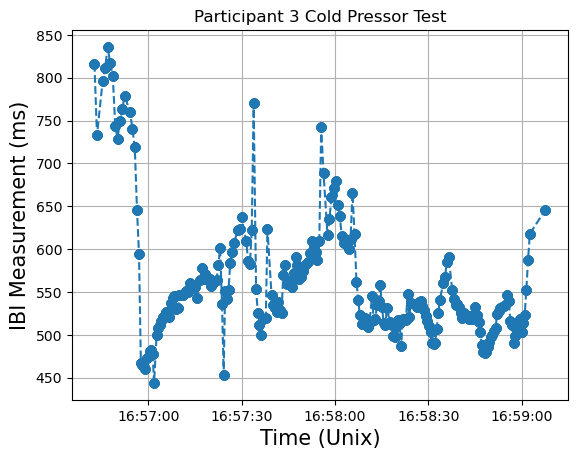

In [23]:
# plot participant 3 cold pressor test

df_p1 = pandas.read_csv(r"C:\Users\C23Price.Johnson\Desktop\Capstone\Capstone Project\Pain-Identification\src\raw_data\raw_data_garmin\participant_3_CPT.csv")
df_p1.describe()
p1_np = df_p1.values
p1_np = p1_np[:,[2,3]] # Get all rows, time and ibi columns
p1_np = p1_np[p1_np[:, 0].argsort()]  # Sort by time to ensure time is chronological

#decorate
fig = plt.figure()
ax = plt.axes()
plt.grid()
plt.title("Participant 3 Cold Pressor Test")
plt.xlabel('Time (Unix)', fontsize=15)
plt.ylabel('IBI Measurement (ms)', fontsize=15)
plt.rcParams['figure.figsize'] = plot_size

# x axis timing
plot_width_seconds = p1_np[0,0] - p1_np[0,1]
min_time = p1_np[1,0]
max_time = min_time + plot_width_seconds

# define indices and x values
indices = get_indices(p1_np[:,0], min_time, max_time)
x_vals = [datetime.utcfromtimestamp(t/1000) for t in p1_np[indices,0]] #convert to datetime objects

# plot
plt.plot(x_vals,p1_np[indices,1], 'o', linestyle = '--')

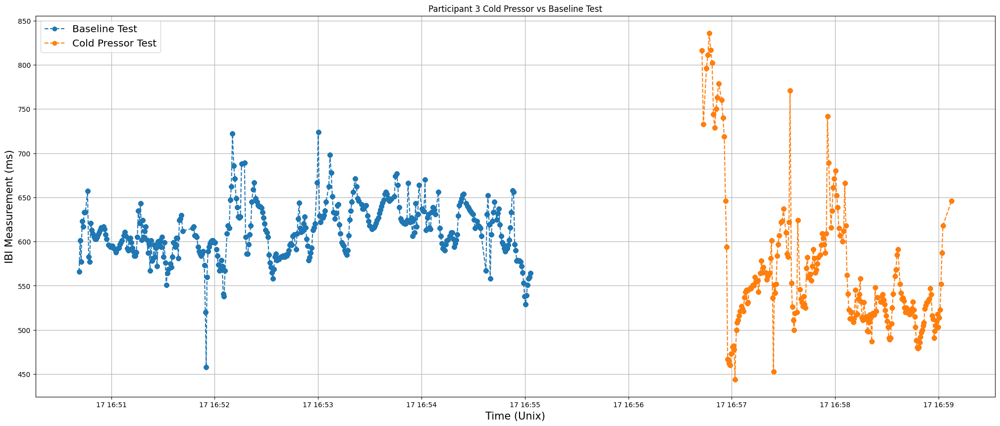

In [22]:
# plot participant 3 baseline and cold pressor test

# baseline
df_p1bl = pandas.read_csv(r"C:\Users\C23Price.Johnson\Desktop\Capstone\Capstone Project\Pain-Identification\src\raw_data\raw_data_garmin\participant_3_BL.csv")
df_p1bl.describe()
p1bl_np = df_p1bl.values
p1bl_np = p1bl_np[:,[2,3]] # Get all rows, time and ibi columns
p1bl_np = p1bl_np[p1bl_np[:, 0].argsort()] # Sort by time to ensure time is chronological

# cold Pressor
df_p1cp = pandas.read_csv(r"C:\Users\C23Price.Johnson\Desktop\Capstone\Capstone Project\Pain-Identification\src\raw_data\raw_data_garmin\participant_3_CPT.csv")
df_p1cp.describe()
p1cp_np = df_p1cp.values
p1cp_np = p1cp_np[:,[2,3]] # Get all rows, time and ibi columns
p1cp_np = p1cp_np[p1cp_np[:, 0].argsort()] # Sort by time to ensure time is chronological

# decorate
fig = plt.figure()
ax = plt.axes()
plt.grid()
plt.title("Participant 3 Cold Pressor vs Baseline Test")
plt.xlabel('Time (Unix)', fontsize=15)
plt.ylabel('IBI Measurement (ms)', fontsize=15)
plt.rcParams['figure.figsize'] = plot_size

# x axis timing
# baseline
plot_width_seconds_bl = p1bl_np[0,0] - p1_np[0,1]
min_time_bl = p1bl_np[1,0]
max_time_bl = min_time_bl + plot_width_seconds_bl

# cold pressor
plot_width_seconds_cp = p1cp_np[0,0] - p1cp_np[0,1]
min_time_cp = p1cp_np[1,0]
max_time_cp = min_time_cp + plot_width_seconds_cp

# define indices and x values
# baseline
indices_bl = get_indices(p1bl_np[:,0], min_time_bl, max_time_bl)
x_vals_bl = [datetime.utcfromtimestamp(t/1000) for t in p1bl_np[indices_bl,0]] #convert to datetime objects

# cold pressor
indices_cp = get_indices(p1cp_np[:,0], min_time_cp, max_time_cp)
x_vals_cp = [datetime.utcfromtimestamp(t/1000) for t in p1cp_np[indices_cp,0]] #convert to datetime objects

# plot
line1, = plt.plot(x_vals_bl,p1bl_np[indices_bl,1], 'o', linestyle = '--', label = 'Baseline Test')
line2, = plt.plot(x_vals_cp,p1cp_np[indices_cp,1], 'o', linestyle = '--', label = 'Cold Pressor Test')

# legend
plt.legend(handles=[line1, line2], loc='upper left', fontsize = 'x-large')